#### Machine Learning para química ciência e materiais


 objective:  0.270845 0.923039 134.61303190057845

 objective:  3.0 2.0 0.0


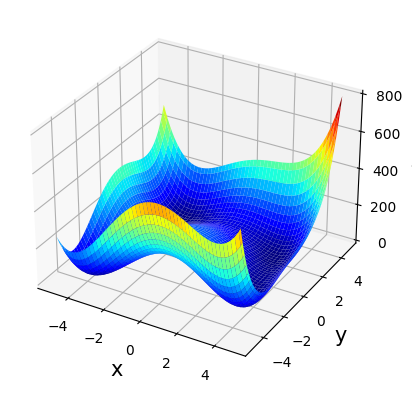

In [7]:
# ----------------------------------#
# Artificial in a nut shell course. #
# ----------------------------------#
# All credits to Maicon Pierre Lourenco (MPL)
# maiconpl01@gmail.com
# Last modification: 04/09/23

'''
from numpy import arange
from numpy import meshgrid
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
'''

from numpy import arange
from numpy import meshgrid
import numpy as np
%matplotlib inline
from matplotlib import pyplot
import matplotlib.pyplot as plt
#from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits import mplot3d

# objective function
def objective(x, y):
    return (x**2 + y - 11)**2 + (x + y**2 -7)**2
# define range for input
r_min, r_max = -5.0, 5.0
# sample input range uniformly at 0.1 increments
xaxis = arange(r_min, r_max, 0.1)
yaxis = arange(r_min, r_max, 0.1)
# create a mesh from the axis
x, y = meshgrid(xaxis, yaxis)
# compute targets
results = objective(x, y)
# create a surface plot with the jet color scheme
figure = pyplot.figure()

'''
axis = figure.gca(projection='3d')
axis.plot_surface(x, y, results, cmap='jet')
'''

axis = plt.axes(projection='3d')
axis.plot_surface(x, y, results, cmap='jet')

axis.set_xlabel('x', fontsize=15)
axis.set_ylabel('y', fontsize=15)
axis.set_zlabel('z', fontsize=15)
# show the plot
#pyplot.show()

print("\n objective: ", 0.270845, 0.923039, objective(0.270845, 0.923039))
print("\n objective: ", 3.0, 2.0, objective(3.0,2.0))

data_list: [[0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0], [0, 0]] 120
z_list: [0, 0, 0, 0, 0, 

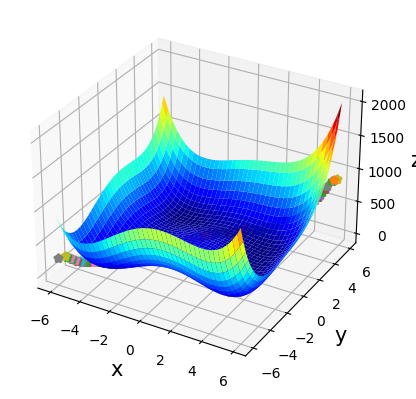

In [8]:
# ----------------------------------#
# Artificial in a nut shell course. #
# ----------------------------------#
# All credits to Maicon Pierre Lourenco (MPL)
# maiconpl01@gmail.com
# Last modification: 07/12/22

from numpy import arange
from numpy import meshgrid
import numpy as np
%matplotlib inline
from matplotlib import pyplot
import matplotlib.pyplot as plt
#from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits import mplot3d

# objective function
def objective(x, y):
    return (x**2 + y - 11)**2 + (x + y**2 -7)**2

# define range for input
r_min, r_max = -6.0, 6.0
# sample input range uniformly at 0.1 increments
xaxis = arange(r_min, r_max, 0.1)
yaxis = arange(r_min, r_max, 0.1)
# create a mesh from the axis
x, y = meshgrid(xaxis, yaxis)
# compute targets
results = objective(x, y)

# GP from scikit-learn

from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import DotProduct, WhiteKernel, RBF
from sklearn.model_selection import train_test_split

kernel02 = 30*DotProduct(1.0, (1e-3, 1e3)) + 100 * WhiteKernel(10.0, (1e-3, 1e3)) + 1 * RBF(length_scale=1.0)

gp = GaussianProcessRegressor(kernel=kernel02, alpha=1e-8, n_restarts_optimizer=10, random_state=80)

data_list = [[0 for i in range(2)] for j in range(len(xaxis))]
z_list = [0 for i in range(len(xaxis))]

print("data_list:", data_list, len(data_list))
print("z_list:", z_list, len(z_list))

for i in range(len(data_list)):
    data_list[i][0] = round(xaxis[i], 2)
    data_list[i][1] = round(yaxis[i], 2)
    z_list[i] = objective( round(xaxis[i], 2), round(yaxis[i],2) )

print("data_list before:", data_list, np.array(data_list).shape)
print("len(z_list):", len(z_list))

X_train, X_test, y_train, y_test = train_test_split(data_list, z_list, test_size=0.80, random_state=42)

gp.fit(X_train, y_train)

print("R2 of predicted 'all data' from data_list: {:.4f}".format( gp.score(data_list, z_list)) )
print("R2 of predicted 'train' from X_train: {:.4f}".format( gp.score(X_train, y_train)) )
print("R2 of predicted 'test' from Y_test: {:.4f}".format( gp.score(X_test, y_test)) )

# Define the virutal space, where the ML prediction is done
data_list_virtual = np.arange(0.0, 5.0, 0.001).tolist

# To visualize the prediction of the virtual data (x, y) from the GP regression model
for i in range(len(X_test)):
    print("X_test obs and pred:", X_test[i], np.array(X_test[i]).reshape(-1,1), y_test[i], gp.predict([X_test[i]]) )

# create a surface plot with the jet color scheme
#figure = pyplot.figure()
#axis = figure.gca(projection='3d')
axis = plt.axes(projection='3d')
axis.plot_surface(x, y, results, cmap='jet')

axis.set_xlabel('x', fontsize=15)
axis.set_ylabel('y', fontsize=15)
axis.set_zlabel('z', fontsize=15)

virtual = [0.0, -6.0]
virtual02 = [0.0, -10.0]

print("virtual02: ", virtual02)
print("np.array(virtual02).reshape(1,-1)", np.array(virtual02).reshape(1,-1))
print("np.array(virtual02).reshape(-1,1)", np.array(virtual02).reshape(-1,1))

for i in range(len(X_test)):
    axis.scatter( X_test[i][0], X_test[i][1], gp.predict( [X_test[i]]  ) , marker="*", linewidths=3.0, alpha=1.0)

    #axis.scatter( 0.0, -4.0, gp.predict( [[0.0, -4.0]] ) , marker="*", linewidths=3.0, alpha=1.0)
    #axis.scatter( virtual[0], virtual[1], gp.predict( [virtual] ) , marker="*", linewidths=3.0, alpha=1.0)
    #axis.scatter( virtual02[0], virtual02[1], gp.predict( [np.array(virtual02).reshape(1,-1)[0]] ) , marker="*", linewidths=3.0, alpha=1.0) # IT DOES WORK

# show the plot
#pyplot.show()

# AL ____________________________________________ A

number of all states or search space:  3721
xaxis[i], yaxis[j]:  0 0 -6.0 -6.0 890.0
xaxis[i], yaxis[j]:  0 1 -6.0 -5.8 794.6496
xaxis[i], yaxis[j]:  0 2 -6.0 -5.6 713.4495999999998
xaxis[i], yaxis[j]:  0 3 -6.0 -5.4 645.3056000000001
xaxis[i], yaxis[j]:  0 4 -6.0 -5.2 589.1616000000001
xaxis[i], yaxis[j]:  0 5 -6.0 -5.0 544.0
xaxis[i], yaxis[j]:  0 6 -6.0 -4.8 508.84159999999997
xaxis[i], yaxis[j]:  0 7 -6.0 -4.6 482.7455999999999
xaxis[i], yaxis[j]:  0 8 -6.0 -4.4 464.8096000000001
xaxis[i], yaxis[j]:  0 9 -6.0 -4.2 454.16960000000006
xaxis[i], yaxis[j]:  0 10 -6.0 -4.0 450.0
xaxis[i], yaxis[j]:  0 11 -6.0 -3.8 451.5136000000001
xaxis[i], yaxis[j]:  0 12 -6.0 -3.6 457.9615999999999
xaxis[i], yaxis[j]:  0 13 -6.0 -3.4 468.63360000000006
xaxis[i], yaxis[j]:  0 14 -6.0 -3.2 482.8575999999999
xaxis[i], yaxis[j]:  0 15 -6.0 -3.0 500.0
xaxis[i], yaxis[j]:  0 16 -6.0 -2.8 519.4656000000001
xaxis[i], yaxis[j]:  0 17 -6.0 -2.6 540.6976
xaxis[i], yaxis[j]:  0 18 -6.0 -2.4 563.1776000000001
xax

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\metrics\_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


AL cycle: 0
R2 of predicted 'all data' from data_list: -0.2920
R2 of predicted 'train' from X_train: -0.0840
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [136.06819951902716, 136.06802679355022, 136.0678533499214, 136.0676787553508, 136.0675024102557, 136.06732354511695, 136.06714125874535, 136.0669546152514, 136.0667628080697, 136.06656538158174, 136.0663624766209, 136.06615504223615, 136.06594494258022, 136.0657348944987, 136.06552820302517, 136.06532831402254, 136.06513826118126, 136.06496012812448, 136.06479465711317, 136.06464110589772, 136.0644973908659, 136.06436047833515, 136.0642269224416, 136.06409341812585, 136.06395724845532, 136.06381654904627, 136.06367037029707, 136.06351857013112, 136.0633616015083, 136.06320026556912, 136.06303548764714, 136.06286814937502, 136.06269898584924, 136.06252853923698, 136.06235715187094, 136.0621849817517, 136.06201202850204, 136.06183816483284, 136.06166317463857, 136.0614868019863, 136.06130881443548, 136.0611290793402, 136.0609

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\metrics\_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


y_unexplored:  [-1012.8496817282436, -993.4942908913084, -974.1388993583091, -954.7835067127638, -935.4281123793833, -916.0727156220282, -896.7173155813183, -877.3619113681023, -858.0065022203039, -838.651087713751, -819.2956679946435, -799.9402439789362, -780.5848174514578, -761.2293910043036, -741.8739677841137, -722.5185510670239, -703.1631437345941, -683.8077477648031, -664.4523638620835, -645.0969913220362, -625.7416281667172, -606.3862715146064, -587.030918089616, -567.675564745173, -548.3202088892999, -528.9648487374151, -509.6094833741291, -490.2541126545167, -470.89873700552124, -451.5433571949492, -432.1879741231956, -412.83258867054093, -393.4772016099367, -374.1218135779918, -354.7664250875825, -335.4110365630473, -316.0556483805915, -296.70026089985885, -277.3448744761779, -257.9894894468215, -238.63410608945773, -219.27872455748962, -199.92334480483925, -180.56796652007688, -161.2125890937089, -141.8572116398043, -122.5018330826601, -103.14645230223236, -83.79106831335275

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\metrics\_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


y_unexplored:  [242.30762134187174, 244.7836375285512, 247.2595475566364, 249.73536971808196, 252.21113066771886, 254.68686066657878, 257.1625887030157, 259.63833856473764, 262.11412654893684, 264.5899609802993, 267.0658432378806, 269.54176970206976, 272.01773396642716, 274.4937287792061, 276.96974740157515, 279.4457843036468, 281.9218352995891, 284.3978973197439, 286.8739680334826, 289.3500454940019, 291.8261279050394, 294.3022135365705, 296.7783007610654, 299.2543881529385, 301.7304745911779, 304.2065593215197, 306.6826419593568, 309.1587224377477, 311.63480091975913, 314.110877698844, 316.58695310689023, 319.06302744099605, 321.53910091116956, 324.0151736050858, 326.4912454641634, 328.96731626745895, 331.4433856250171, 333.91945298841273, 336.3955176908065, 338.87157902917113, 341.3476363951853, 343.82368944793836, 346.2997383030976, 348.77578369493517, 351.2518270573306, 353.7278704750368, 356.20391648063674, 358.679967712238, 361.1560264909919, 363.6320944105307, 366.1081720384634

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\metrics\_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


AL cycle: 3
R2 of predicted 'all data' from data_list: -0.7215
R2 of predicted 'train' from X_train: 0.3865
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [613.814862880965, 485.80571815008216, 486.7700234771114, 487.73432880414083, 488.6986341311704, 489.6629394581998, 490.6272447852293, 491.5915501122587, 492.555855439288, 493.52016076631764, 494.48446609334735, 495.4487714203769, 496.4130767474061, 497.3773820744356, 498.34168740146515, 499.3059927284945, 500.27029805552405, 501.23460338255353, 502.19890870958295, 503.1632140366126, 504.12751936364197, 505.09182469067144, 506.05613001770087, 507.02043534473023, 507.9847406717596, 508.9490459987892, 509.91335132581855, 510.8776566528481, 511.84196197987757, 512.8062673069069, 513.7705726339365, 514.7348779609661, 515.6991832879954, 516.6634886150249, 517.6277939420544, 518.5920992690836, 519.556404596113, 520.5207099231428, 521.4850152501721, 522.4493205772015, 523.4136259042313, 524.3779312312606, 525.3422365582901, 526.3065

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\metrics\_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


AL cycle: 4
R2 of predicted 'all data' from data_list: -0.3554
R2 of predicted 'train' from X_train: -0.0263
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [484.4793766969037, 484.48000335556105, 484.4806300142167, 484.4812566728708, 484.4818833315232, 484.48250999017404, 484.4831366488228, 484.48376330747, 484.4843899661158, 484.4850166247595, 484.48564328340206, 484.4862699420424, 484.48689660068123, 484.48752325931844, 484.488149917954, 484.48877657658784, 484.4894032352199, 484.49002989385025, 484.49065655247915, 484.4912832111061, 484.49190986973156, 484.4925365283552, 484.4931631869772, 484.4937898455974, 484.494416504216, 484.4950431628333, 484.49566982144853, 484.496296480062, 484.49692313867394, 484.49754979728414, 484.49817645589263, 484.4988031144997, 484.4994297731045, 484.5000564317082, 484.50068309030996, 484.50130974891005, 484.5019364075085, 484.5025630661051, 484.50318972470006, 484.5038163832934, 484.5044430418853, 484.50506970047513, 484.50569635906334, 484.5

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.wa

AL cycle: 5
R2 of predicted 'all data' from data_list: -0.9518
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999999407, -8.137818818861746e-06, -8.011842206818464e-06, -7.885865594775175e-06, -7.759888982731892e-06, -7.633912370688607e-06, -7.507935758645321e-06, -7.381959146602034e-06, -7.255982534558752e-06, -7.130005922515463e-06, -7.00402931047218e-06, -6.878052698428896e-06, -6.752076086385609e-06, -6.626099474342326e-06, -6.500122862299042e-06, -6.374146250255755e-06, -6.2481696382124705e-06, -6.122193026169183e-06, -5.996216414125899e-06, -5.870239802082616e-06, -5.7442631900393285e-06, -5.618286577996043e-06, -5.49230996595276e-06, -5.366333353909474e-06, -5.240356741866189e-06, -5.1143801298229034e-06, -4.988403517779617e-06, -4.862426905736333e-06, -4.736450293693048e-06, -4.610473681649765e-06, -4.484497069606478e-06, -4.358520457563194e-06, -4.232543845519909e-06, -4.106567233476623e-06, -3.980590621433337e-06, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\metrics\_regression.py:996: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


AL cycle: 6
R2 of predicted 'all data' from data_list: -2.1309
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999999782, 794.649599999983, 694.5618768678926, 681.4963835701915, 668.4308902724898, 655.3653969747887, 642.2999036770873, 629.2344103793858, 616.1689170816848, 603.1034237839834, 590.0379304862819, 576.9724371885807, 563.9069438908796, 550.8414505931779, 537.7759572954769, 524.7104639977755, 511.644970700074, 498.5794774023728, 485.51398410467164, 472.4484908069703, 459.3829975092688, 446.31750421156744, 433.2520109138662, 420.18651761616485, 407.1210243184636, 394.0555310207622, 380.99003772306094, 367.9245444253596, 354.85905112765823, 341.793557829957, 328.72806453225564, 315.6625712345544, 302.5970779368529, 289.53158463915156, 276.4660913414502, 263.4005980437488, 250.33510474604745, 237.26961144834618, 224.2041181506447, 211.1386248529437, 198.07313155524216, 185.00763825754095, 171.9421449598396, 158.8766516

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 7
R2 of predicted 'all data' from data_list: -2.5534
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999998248, 794.6496000003698, 670.5274528221242, 533.2477925240195, 398.3172168351557, 278.3314559607194, 181.2250586939935, 109.8559309634988, 62.768708788274814, 35.67603117572809, 23.106636138187703, 19.77432124800314, 21.433246809464187, 25.199545178460376, 29.465118523498415, 33.584813577715416, 37.5010039479092, 41.41557448609953, 45.56064438169336, 50.07467052253143, 54.964801113243766, 60.12632929230409, 65.39025261253882, 70.57555542543324, 75.53076287768307, 80.15751467223888, 84.41587035054908, 88.31573922220713, 91.90081747319825, 95.23103159753778, 98.36759892118172, 101.36246138076963, 104.25187037375127, 107.05275369170903, 109.7602646907066, 112.34544998147007, 114.75302858561226, 116.90056221749025, 118.6814496824888, 119.9747235849188, 120.66403204540761, 120.66607029149829, 119.96518125606916, 118.

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 8
R2 of predicted 'all data' from data_list: -2.3977
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999999626, 794.6495999999526, 332.1871266281646, 341.2967806263553, 350.4064346245471, 359.5160886227381, 368.6257426209289, 377.7353966191198, 386.845050617311, 395.9547046155016, 405.0643586136908, 414.1740126118811, 423.28366661007277, 432.39332060826337, 441.50297460645527, 450.612628604645, 459.72228260283606, 468.8319366010268, 477.9415905992176, 487.0512445974093, 496.16089859560077, 505.27055259378926, 514.3802065919814, 523.489860590171, 532.5995145883634, 541.7091685865528, 550.818822584744, 559.9284765829361, 569.0381305811255, 578.1477845793174, 587.2574385775072, 596.3670925756982, 605.4767465738877, 614.5864005720807, 623.6960545702722, 632.8057085684613, 641.9153625666542, 651.0250165648443, 660.134670563034, 669.2443245612254, 678.3539785594148, 687.4636325576056, 696.5732865557954, 705.6829405539885,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings

AL cycle: 9
R2 of predicted 'all data' from data_list: -0.9365
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999999111, 794.6495999999206, -0.00033843815848633396, -0.0003355250305968836, -0.0003326119027074329, -0.0003296987748179822, -0.0003267856469285315, -0.00032387251903908087, -0.0003209593911496301, -0.00031804626326018, -0.00031513313537072916, -0.00031222000748127844, -0.0003093068795918281, -0.00030639375170237745, -0.0003034806238129269, -0.00030056749592347596, -0.00029765436803402525, -0.00029474124014457464, -0.00029182811225512447, -0.00028891498436567364, -0.0002860018564762229, -0.00028308872858677237, -0.000280175600697322, -0.00027726247280787116, -0.00027434934491842077, -0.00027143621702897005, -0.0002685230891395192, -0.00026560996125006895, -0.00026269683336061834, -0.00025978370547116757, -0.00025687057758171696, -0.0002539574496922663, -0.0002510443218028159, -0.000248131193913365, -0.0002452180660

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings

AL cycle: 10
R2 of predicted 'all data' from data_list: -0.9346
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999999111, 794.6495999999207, 0.0003907167102036888, 0.0003808388673859107, 0.00037096102456813274, 0.0003610831817503545, 0.00035120533893257607, 0.00034132749611479757, 0.00033144965329701896, 0.0003215718104792411, 0.00031169396766146266, 0.00030181612484368454, 0.00029193828202590664, 0.00028206043920812846, 0.00027218259639034996, 0.0002623047535725718, 0.00025242691075479345, 0.00024254906793701544, 0.00023267122511923746, 0.0002227933823014587, 0.00021291553948368122, 0.00020303769666590263, 0.0001931598538481244, 0.00018328201103034601, 0.0001734041682125677, 0.00016352632539478994, 0.000153648482577012, 0.00014377063975923302, 0.00013389279694145517, 0.00012401495412367705, 0.00011413711130589901, 0.00010425926848812094, 9.438142567034204e-05, 8.45035828525642e-05, 7.462574003478608e-05, 6.474789721700795e-

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 11
R2 of predicted 'all data' from data_list: -6.3287
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [890.0000000001739, 794.6495999999921, 470.51407544341566, 475.0290290031679, 479.54398256282815, 484.0589361224883, 488.5738896825438, 493.08884324220395, 497.60379680179375, 502.11875036191964, 506.63370392150944, 511.1486574811696, 515.6636110408298, 520.1785646008149, 524.693518160475, 529.2084717201352, 533.7234252797954, 538.2383788396885, 542.7533323996736, 547.2682859591009, 551.7832395189939, 556.2981930788869, 560.8131466384767, 565.3281001982994, 569.8430537579595, 574.3580073176197, 578.8729608774423, 583.3879144373353, 587.9028679971581, 592.4178215569807, 596.9327751166409, 601.4477286765339, 605.9626822359612, 610.4776357959463, 614.9925893556065, 619.5075429150338, 624.0224964751596, 628.5374500348198, 633.052403594805, 637.5673571544652, 642.0823107143582, 646.5972642740184, 651.112217833841, 655.62717139319

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 12
R2 of predicted 'all data' from data_list: -4.3570
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999994907, 794.649600001052, 713.4495999990468, 657.6584711104224, 627.4433364546421, 614.4415345340094, 607.1763093740738, 596.3651219936728, 577.8410833823873, 552.5052026553603, 524.2699772720807, 497.55837110111315, 475.5631500046147, 459.669130432987, 449.7683995666739, 444.93599256193556, 444.0304752393131, 446.0299368270498, 450.12296236798284, 455.66825327566767, 462.1308275668416, 469.0506863949413, 476.04879872809397, 482.8483056345576, 489.28692331022467, 495.3087970392953, 500.93812100541254, 506.2449297092098, 511.31399502071145, 516.223409651895, 521.0340466311463, 525.7873132845707, 530.5071985279501, 535.2028933711408, 539.8692026838107, 544.4828836503875, 548.993928107986, 553.3121977784758, 557.2924266315385, 560.7246315781231, 563.3413899213629, 564.8556231602852, 565.0390242439462, 563.8401089799

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 13
R2 of predicted 'all data' from data_list: -4.3810
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999994745, 794.6496000010352, 713.4495999990628, 657.7451286951347, 628.0924419642538, 616.6486053064458, 612.3737090766159, 606.2037184256368, 593.9594004706784, 576.362645606124, 557.0340242004696, 539.9809572919079, 527.7980496673463, 521.0535508675292, 518.6643517690204, 518.7478415803511, 519.4655999999667, 519.5731096746172, 518.6018083043073, 516.744450266292, 514.5792078601294, 512.769501344717, 511.8382861662014, 512.0600508437926, 513.4621944201539, 515.8953886961287, 519.125258983707, 522.9096285198593, 527.0451850185353, 531.3842643028391, 535.831343703008, 540.3300990653207, 544.8487128292044, 549.3668601114904, 553.8644458612661, 558.3103684015585, 562.6493414399022, 566.7861079599893, 570.5693450443164, 573.7819964098416, 576.1494322791424, 577.379016996638, 577.2409457552656, 575.6887516619724, 573.0

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 14
R2 of predicted 'all data' from data_list: -6.3867
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999999766, 794.649599999969, 713.4495999999591, 502.0159882922823, 505.99003644469116, 509.96408459709573, 513.9381327495055, 517.9121809019094, 521.8862290543216, 525.8602772067264, 529.8343253591343, 533.8083735115371, 537.782421663948, 541.7564698163577, 545.7305179687602, 549.7045661211702, 519.4656000000022, 557.6526624259784, 561.6267105783887, 565.6007587307945, 569.5748068832014, 573.5488550356088, 577.522903188016, 581.4969513404285, 585.470999492831, 589.4450476452429, 593.4190957976452, 597.393143950051, 601.3671921024613, 605.3412402548656, 609.3152884072714, 613.2893365596778, 617.263384712082, 621.2374328644896, 625.2114810168979, 629.1855291693058, 633.1595773217141, 637.1336254741212, 641.1076736265294, 645.0817217789319, 649.0557699313383, 653.0298180837499, 657.0038662361555, 660.9779143885613, 664

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 15
R2 of predicted 'all data' from data_list: -4.3991
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: nan
y_unexplored:  [889.9999999985719, 794.6496000046541, 713.4495999915374, 645.3056000027574, 584.4265290707058, 525.9742258195788, 469.8514115046012, 420.84574441951406, 385.72505434242015, 369.4687419470682, 372.8193066908265, 392.11593062835436, 420.95830910669537, 452.49676748560074, 481.2491413338687, 503.9422379074844, 519.4655999999479, 528.3185902576034, 531.9264165418073, 532.0508023826985, 530.3740196031267, 528.2532769026019, 526.6161844969369, 525.9643410046427, 526.4502392557514, 527.9902751213364, 530.3791006471876, 533.3804599977178, 536.7838035874288, 540.4287111196126, 544.2064815319528, 548.0496105792882, 551.9172552238005, 555.780810312564, 559.6103282647542, 563.3606087031626, 566.9556325895945, 570.2716588966051, 573.1226359770285, 575.2559731880463, 576.3705098690053, 576.1689966959551, 574.451857538526, 571.24683257954

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 16
R2 of predicted 'all data' from data_list: -4.4761
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -81.3836
y_unexplored:  [889.9999999986056, 794.649600004385, 713.4495999917388, 645.305600002564, 584.3020910396214, 525.4967095806137, 468.7397595935021, 418.71378719851873, 381.9040773739581, 362.8329921014029, 361.7963984847162, 374.982041898556, 396.360153096274, 420.011775511974, 441.7623026760247, 459.68698330296377, 473.70201267994315, 484.7467470660377, 494.01110930536197, 502.44590443529256, 510.58473968315974, 518.5869056751687, 526.3815285913357, 533.8184842312796, 540.7745947901035, 547.2019662061042, 553.1297472715296, 558.6404196792554, 563.8407446820281, 568.8410897068925, 573.7498668092895, 578.6850188654884, 583.8021107150304, 589.3367325528777, 595.6547893087554, 603.2958325161301, 612.9828072563897, 625.5620395162404, 641.840076790824, 662.3096392271988, 686.8082268210213, 714.216344641123, 742.3464307540949, 768.1609416332

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 17
R2 of predicted 'all data' from data_list: -2.6240
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.0241
y_unexplored:  [889.9999999984695, 794.6496000049881, 713.4495999909722, 645.3056000028114, 584.4570766435942, 526.1508083951851, 470.40589049875905, 422.0996761797869, 387.98973998213154, 372.8896373353764, 377.22428133927724, 396.95511669698703, 425.40920519332656, 455.74366384899446, 482.8575999999641, 504.1861296892348, 519.4655999999319, 529.9211012389258, 537.3563738143446, 543.4591054973073, 549.4309987637903, 555.9059743770781, 563.0531231134188, 570.7551408087813, 578.7802898321439, 586.9038492203377, 594.9688819418823, 602.8983713254414, 610.6797956774847, 618.3419786738857, 625.9376335078281, 633.5379533957673, 641.2402374493485, 649.1858281117844, 657.5821257662155, 666.7178783508141, 676.9558142718282, 688.6841452509001, 702.213726911304, 717.6252623404602, 734.6002478047388, 752.3008169011595, 769.3794121492907, 784.181039

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 18
R2 of predicted 'all data' from data_list: -3.9439
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.0815
y_unexplored:  [889.9999999999629, 794.6495999999767, 713.4495999999657, 645.3055999999807, 545.8478481219771, 549.2902729310033, 552.7326977400331, 556.1751225490589, 559.6175473580848, 563.0599721671138, 566.5023969761402, 569.9448217851736, 573.3872465941978, 576.8296714032258, 482.8576000000217, 583.714521021281, 519.4656000000167, 590.5993706393365, 594.0417954483632, 597.4842202573938, 600.9266450664168, 604.3690698754501, 607.8114946844788, 611.2539194935058, 614.6963443025318, 618.1387691115613, 621.5811939205873, 625.0236187296166, 628.4660435386417, 631.9084683476668, 635.3508931566953, 638.7933179657276, 642.23574277475, 645.6781675837788, 649.1205923928075, 652.5630172018342, 656.0054420108657, 659.447866819892, 662.8902916289203, 666.3327164379467, 669.775141246971, 673.2175660559993, 676.6599908650284, 680.1024156740586, 6

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 19
R2 of predicted 'all data' from data_list: -5.6763
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -15.2960
y_unexplored:  [889.9999999999688, 794.6495999999313, 481.6669250542956, 645.3055999999617, 492.6378701790284, 498.12334274139573, 503.60881530376173, 509.09428786613586, 514.5797604284977, 520.0652329908625, 525.5507055532314, 531.0361781155993, 536.5216506779698, 542.0071232403426, 482.8576000000078, 552.9780683650704, 519.4656000000091, 563.9490134898015, 569.4344860521758, 574.9199586145407, 580.4054311769053, 585.8909037392727, 591.3763763016422, 596.8618488640096, 602.3473214263746, 607.8327939887446, 613.3182665511089, 618.8037391134787, 624.2892116758469, 629.7746842382159, 635.2601568005798, 640.7456293629547, 646.2311019253149, 651.7165744876817, 657.2020470500512, 662.6875196124167, 668.172992174784, 673.6584647371526, 679.1439372995225, 684.6294098618881, 690.1148824242557, 695.6003549866216, 701.0858275489928, 706.5713001

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 20
R2 of predicted 'all data' from data_list: -3.6305
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 1.0000
y_unexplored:  [889.999999998185, 794.6496000134063, 713.449599987125, 645.3056000041507, 585.4917776299012, 529.8085917504366, 477.5331611744783, 431.89370835446977, 398.2251787508142, 381.0925226427372, 381.952443950868, 398.37509169754804, 424.9205575506831, 455.00909166895866, 482.8575999999749, 504.7638089250144, 519.465600000016, 527.7178890259586, 531.4536076821976, 532.9101892672406, 533.9818259311587, 535.8963044769558, 539.1838035767142, 543.8340339840192, 549.5254889228695, 555.8369593757908, 562.3935102178979, 568.9380761494098, 575.3453686422965, 581.6047942369156, 587.7970630334319, 594.0806139083095, 600.6935200613506, 607.9666737701245, 616.3356533780744, 626.3324404000496, 638.5359449090085, 653.4653467857026, 671.4156350002805, 692.260386353583, 715.2767754059716, 739.0696466366951, 761.6701827733845, 780.8503118538664

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 21
R2 of predicted 'all data' from data_list: -1.3894
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 1.0000
y_unexplored:  [889.9999999959134, 794.6496000311347, 713.4495999693657, 645.3056000104948, 587.7445693721595, 538.4725839402055, 496.4544823550427, 462.18270341251383, 437.15361265358854, 422.8780149335677, 419.89780129381126, 427.2220242028587, 442.3812070851445, 462.03410329313175, 482.8576000000908, 502.3778250878443, 519.4655999995977, 534.3745405707128, 548.3723609067795, 563.1403183078685, 580.1582376150676, 600.2558246367695, 623.4247764572184, 648.8901149190565, 675.3662500034434, 701.3903630852217, 725.6321590916759, 747.1119314621692, 765.3008068941241, 780.1130880522791, 791.8223693232347, 800.9392013544292, 808.0823431077821, 813.864177280715, 818.7994600409547, 823.2390397704769, 827.3277997573356, 830.9879118345445, 833.9321208688791, 835.7142837984609, 835.8232571646016, 833.8201921727898, 829.5088390483907, 823.11588463

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 22
R2 of predicted 'all data' from data_list: -2.8452
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 1.0000
y_unexplored:  [889.9999997667406, 794.6496016069341, 713.4495992693148, 645.3056004537896, 581.8758102521981, 517.0730598659842, 452.74204281288127, 397.5033356406733, 361.0248001693668, 348.4628961173002, 358.4030507152192, 384.4430726912339, 418.3834718660361, 452.9080220135167, 482.857599999583, 505.35944970926795, 519.4655999957199, 525.7281351671922, 525.7898593663665, 521.9206265481693, 516.4913307202713, 511.4903410910307, 508.21848139864045, 507.2293329897931, 508.476318823429, 511.55953098217753, 515.9624266385481, 521.2127060992551, 526.9552212757566, 532.9600301849184, 539.0991722628933, 545.3198746089313, 551.6315360021732, 558.1161202689356, 564.9668745561954, 572.5537985149534, 581.4996844873887, 592.7253007285848, 607.3945157489399, 626.6826251244152, 651.3341655834238, 681.0846453041993, 714.1627646953878, 747.180356687

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 23
R2 of predicted 'all data' from data_list: -5.2621
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.0508
y_unexplored:  [889.9999999999582, 794.6495999999659, 713.4495999999785, 645.305599999967, 483.8922527076258, 489.80980360170315, 495.72735449577726, 501.64490538984757, 507.56245628392486, 513.4800071780023, 519.3975580720751, 525.3151089661483, 531.2326598602249, 537.1502107543064, 482.8576000000119, 548.9853125424476, 519.4656000000083, 560.8204143306015, 566.7379652246751, 572.6555161187549, 578.573067012824, 584.4906179068956, 590.4081688009743, 596.3257196950489, 602.243270589125, 608.1608214831987, 738.4095999999804, 619.9959232713545, 625.9134741654252, 631.8310250594989, 637.7485759535757, 643.6661268476498, 649.5836777417235, 655.501228635803, 661.4187795298699, 667.3363304239446, 673.2538813180262, 679.1714322121037, 685.0889831061778, 691.0065340002476, 696.9240848943278, 702.8416357883999, 708.7591866824774, 714.67673757655

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 24
R2 of predicted 'all data' from data_list: -1.2410
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -1.3503
y_unexplored:  [889.9999999950251, 794.6496000191646, 713.4495999621683, 645.3056000132266, 587.9048554577793, 539.0836904074052, 497.77592661815646, 464.26839060616777, 439.7742179213353, 425.587624733919, 422.2109677596243, 428.8104827464768, 443.19255179251485, 462.27616997345206, 482.8575999998829, 502.3816375667106, 519.4656000000542, 534.0376704985496, 547.0956854719589, 560.2107744053733, 574.9574078202328, 592.4407154479084, 613.0311429671234, 636.3359144679529, 661.3658323189474, 686.8136855853744, 711.3520215934776, 733.8765870802072, 753.6544200565402, 770.3690734684698, 784.0803615908264, 795.1284814219713, 804.0134594321942, 811.2746793007674, 817.3865700260794, 822.679177636379, 827.2881939799828, 831.1379679998112, 833.9615090701883, 835.3613193453762, 834.9121564402483, 832.3006528088048, 827.487677807357, 820.869423033

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 25
R2 of predicted 'all data' from data_list: -2.3471
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9456
y_unexplored:  [889.9999999910438, 794.6496000319944, 713.4495999681224, 645.3056000223767, 588.0194136430139, 539.4750916012929, 498.49181846702254, 465.1197332335056, 440.3588399946205, 425.473914499934, 421.19528197653455, 427.10388191351143, 441.40730902521744, 461.16351342670066, 482.85759999959464, 503.13477710368716, 519.4655999998872, 530.5657704326826, 536.4859149136195, 538.3903128166615, 538.1242624265641, 537.7080210931495, 538.8884358052807, 542.8389950524587, 550.0438467073254, 560.3498706497921, 573.1359561054511, 587.5349986694926, 602.649410712719, 617.7183315115597, 632.2162882117551, 645.8823190203062, 658.6918609262204, 670.7902492984678, 682.4077745328849, 693.774095162334, 705.0464656187706, 716.2629323727868, 727.3286287303484, 738.0400560820141, 748.148025007023, 757.4542746810315, 765.9299109260094, 773.83674357

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit ag

AL cycle: 26
R2 of predicted 'all data' from data_list: -1.9713
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9323
y_unexplored:  [889.9999999535648, 794.6496000101807, 713.4495999574318, 645.3056000261421, 587.3319856714807, 536.7785380599472, 492.4474488100526, 455.1366891392459, 427.07008589189684, 410.67132744276813, 407.2519061907735, 416.1481127526092, 434.60549705936216, 458.3919661675123, 482.8575999879353, 504.0409035490266, 519.4655999933992, 528.4319446419374, 531.8016880088508, 531.431098360457, 529.4786332024744, 527.7992939249945, 527.5631812735445, 529.1406399018806, 532.2153999403125, 536.0401164505073, 539.7386274091052, 542.5767249191636, 544.1537750571368, 544.4980337227562, 544.0709966984929, 543.6983317328993, 544.4487522240545, 547.4812684176202, 553.8789956120369, 564.4861945162556, 579.7650722993652, 599.6895728863612, 623.6937712649839, 650.6911022563701, 679.1760198345178, 707.4107094058081, 733.6859948996218, 756.628963280

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 27
R2 of predicted 'all data' from data_list: -1.1702
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9760
y_unexplored:  [889.9999999848804, 794.6496000561359, 713.4495999402473, 645.3056000401654, 588.5419989793743, 541.5805371409562, 503.3820099071779, 473.56777413171847, 452.2404972083279, 439.61183523479633, 435.5926210468922, 439.49707302816876, 449.9618942533692, 465.1034290570179, 482.85759999871993, 501.392366414814, 519.4656000003415, 536.6241038900778, 553.1913856293099, 570.0546190873455, 588.3157893370254, 608.9038535108476, 632.2477188025672, 658.0866204606315, 685.4544621000423, 712.8302617749926, 738.4095999997652, 760.4297482453493, 777.4768174124671, 788.714936530813, 793.999999999034, 793.8673797530469, 789.4080611771043, 782.0664256194049, 773.4030187475311, 764.86683208581, 757.6151878987575, 752.4075023026695, 749.5845951195463, 749.1302930954178, 750.7989219236762, 754.2824688780883, 759.3857300313409, 766.177084887559

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 28
R2 of predicted 'all data' from data_list: -1.9710
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9721
y_unexplored:  [889.9999999904212, 794.6496000381704, 713.4495999621722, 645.3056000259161, 588.2049680915186, 540.2674231444527, 500.44781132136444, 468.721793309607, 445.7750884277991, 432.38342260075507, 428.7578554240204, 434.1148305022977, 446.6263254272503, 463.7569869357958, 482.8575999990544, 501.80365761503714, 519.4656000005929, 535.8658684771334, 551.9869909196136, 569.304866237632, 589.1977656464946, 612.4053546624068, 638.6832700132711, 666.7331359732483, 694.4090996627648, 719.133228394823, 738.4096000001408, 750.316709896827, 753.8765169465257, 749.2362789930855, 737.6441842446781, 721.2408133096039, 702.7183198856748, 684.9147597456716, 670.4127548617871, 661.2025797161034, 658.4537152636585, 662.4196926085802, 672.4815823036545, 687.3177206583673, 705.1723395730835, 724.1843721331384, 742.7304195275092, 759.733317825381

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 29
R2 of predicted 'all data' from data_list: -1.0175
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9783
y_unexplored:  [889.9999999927823, 794.649600013392, 713.4495999934152, 647.0535207843641, 594.7439704092685, 554.8090747909155, 525.0153976300498, 503.08645077445544, 487.1010490616318, 475.7476415676065, 468.40417346020695, 465.050447337213, 466.0532270827098, 471.8866250301944, 482.857600001269, 498.89820881094784, 519.4655999990646, 543.5631621576613, 569.8683755764505, 596.9308883778285, 623.3924075348768, 648.1797611998627, 670.6327871815301, 690.5461524639977, 708.1242185065057, 723.8660092061618, 738.4096000003628, 752.369921315345, 766.201071419986, 780.1054409518838, 793.9999999997672, 807.5380125086522, 820.1748034256743, 831.260624637478, 840.1425679625245, 846.2601753995987, 849.2244507162832, 848.8756396822864, 845.3198556834832, 838.9473627762636, 830.4357919541653, 820.7401611941168, 811.0692043387098, 802.8453045201022,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 30
R2 of predicted 'all data' from data_list: -1.0122
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9451
y_unexplored:  [889.9999999915016, 794.6496000315274, 713.4495999684196, 645.3056000206583, 588.1063486432854, 539.8538692853388, 499.4481445682563, 466.9241496764801, 443.14254301150834, 429.1209301575724, 425.2975513439671, 431.0140940854249, 444.4011711442361, 462.6941792727443, 482.8575999998764, 502.30211593577235, 519.4655999987876, 534.0902025606988, 547.1338475027235, 560.3660167165425, 575.7801797250859, 594.9891556649359, 618.7538611478766, 646.7437984123201, 677.5600710054048, 708.988901658635, 738.4095999996423, 763.2613599562914, 781.4764374467154, 791.8068523582161, 793.9999999999549, 788.8085695924808, 777.8471046602363, 763.3286398565946, 747.7288878363345, 733.4321057684964, 722.4122053182039, 715.9954096697409, 714.7377711901762, 718.4336438689933, 726.2517860049263, 736.9765634385584, 749.3152657930297, 762.2211787944

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 31
R2 of predicted 'all data' from data_list: -0.8947
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9948
y_unexplored:  [889.9999999898889, 794.6496000359357, 713.4495999640129, 645.3056000248911, 588.1959724697641, 540.2086315293025, 500.2535197203116, 468.2763712804285, 444.9793562279921, 431.2170787255049, 427.328627869279, 432.66271587107906, 445.46324338598174, 463.14532580345997, 482.85759999966285, 502.1395400569292, 519.4656000000628, 534.518316458822, 548.1257878060543, 561.9008912521658, 577.6985756998744, 597.0441550974152, 620.6762282379627, 648.302962081727, 678.6081091107311, 709.4822425911755, 738.4096000004142, 762.918616580964, 781.004553495351, 791.4503952746866, 793.9999999994833, 789.3681183732199, 779.0997948812699, 765.3133721963842, 750.3752348075864, 736.5602472887398, 725.7500606293672, 719.2130602855548, 717.4960732567837, 720.4407595744165, 727.3189388577497, 737.0632210224223, 748.5545244855607, 760.918441957225

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 32
R2 of predicted 'all data' from data_list: -0.2227
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9979
y_unexplored:  [889.9999999877543, 794.649600041334, 713.4495999597199, 645.3056000272762, 588.1747756555242, 539.9325888801601, 499.0800428704329, 465.1299205775196, 438.608213864574, 420.7142984737154, 412.7701477000114, 415.6329345729359, 429.23867066340296, 452.3940318700616, 482.85759999990347, 517.6735528037074, 553.6611118173428, 587.9347168457274, 618.3356943006893, 643.6896815513495, 663.8529499799032, 679.5611208435929, 692.1338599349966, 703.1118062395855, 713.9053269890217, 725.5213046342112, 738.4096000006087, 752.4417981477202, 767.0076318517783, 781.1939396199267, 794.0000000001523, 804.5423341347977, 812.2104306876643, 816.7497029145999, 818.2658341776805, 817.1617779430685, 814.0317620110125, 809.5434180190629, 804.3387027856872, 798.977159389372, 793.9331330218239, 789.6445188524708, 786.597468955636, 785.4219026345643

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 33
R2 of predicted 'all data' from data_list: 0.1085
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -320.2413
y_unexplored:  [889.9999999997572, 794.6496000004607, 713.4495999995904, 645.3056000002497, 573.9054682823521, 502.04712071438604, 448.9727948306942, 425.49427658826767, 424.3937367434526, 431.365394428588, 437.40557101399946, 441.7766437366075, 448.6262150552162, 462.2397188427584, 482.85760000000715, 504.86714641017795, 519.4655999999819, 520.658986881801, 509.7001819932474, 494.34389799581857, 484.56775467428446, 488.9390691576391, 512.9803593748621, 557.6711908576194, 617.5802287524784, 681.63463081437, 738.4095999999581, 781.5186822931577, 808.565790259858, 815.213666545547, 793.9999999999428, 741.9917455690911, 668.4163964691513, 591.9658606633966, 529.8121810880639, 489.1788180539523, 467.5644938004578, 458.4140761397982, 456.3684933018818, 459.7818996207113, 471.4105125590209, 497.9138324576058, 546.8336606155559, 619.75868306

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 34
R2 of predicted 'all data' from data_list: -0.5828
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -54.4289
y_unexplored:  [889.9999999869544, 794.6496000487799, 713.4495999509879, 645.3056000342881, 588.3797215496448, 540.933396454038, 501.8950867230264, 471.0295308602224, 448.7194001758195, 435.4902709763242, 431.47868866065295, 436.0427310972223, 447.65045008853997, 464.0795747733379, 482.85759999904496, 501.79797423786624, 519.4656000001476, 535.4352449080787, 550.2751401869294, 565.2705091472072, 581.9724880976863, 601.6981911925423, 625.1101933718929, 651.9727693691887, 681.1305601359222, 710.6990313021496, 738.4095999999008, 762.0249920976288, 779.7352029919231, 790.4586231324844, 794.0000000002852, 791.0491709097812, 783.0348683695424, 771.8713130796381, 759.6491257953712, 748.3258513906967, 739.4662425116051, 734.070486825536, 732.5122695667578, 734.590464572762, 739.6806980266936, 746.9581119456873, 755.6520980480022, 765.28884958

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 35
R2 of predicted 'all data' from data_list: -0.5987
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9984
y_unexplored:  [889.9999999918166, 794.649600014607, 713.4495999868855, 647.2497200255165, 595.3542232171714, 555.9489193461618, 526.6431585132622, 505.0163719525729, 489.0662518790816, 477.48422876936274, 469.7262404208234, 465.8927462438624, 466.47104784601567, 472.0169663569398, 482.85760000109735, 498.8828523923225, 519.465599999309, 543.5164530288919, 569.6474503345828, 596.3967366344717, 622.4574146961588, 646.8588833251633, 669.0652882142131, 688.9781701763275, 706.8531153881564, 723.1579743905115, 738.409600000469, 753.026010063288, 767.2226716429074, 780.9682060290893, 793.9999999995613, 805.8875573661908, 816.1235125307599, 824.22015943269, 829.7926947429869, 832.6174730759845, 832.6620881741285, 830.0916587623047, 825.2604831332615, 818.6993235146388, 811.1061208877844, 803.3429589763649, 796.4362023195079, 791.5716798915342,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

AL cycle: 36
R2 of predicted 'all data' from data_list: -0.2350
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 1.0000
y_unexplored:  [889.9999999789992, 794.6496001643167, 713.449599836082, 645.3056000590861, 588.6519554452027, 542.0123351704475, 504.35723431421656, 475.2009708703687, 454.45844119113434, 442.14746065821066, 438.0580934676347, 441.5078529972995, 451.2645230273134, 465.65999643165117, 482.85759999749, 501.18985823430114, 519.4656000015472, 537.157811092378, 554.4207079879512, 571.9337291483512, 590.6168546621999, 611.2933726590823, 634.3857995732234, 659.7177117345242, 686.4642910845052, 713.256660368607, 738.4095999980569, 760.2171469419317, 777.2504151342757, 788.5971590403894, 794.0000000017927, 793.8745166786962, 789.2136130411419, 781.4055491077536, 772.0062921849271, 762.5110289259434, 754.1653007441452, 747.8452416043664, 744.0215510569133, 742.8060402541986, 744.0654432981688, 747.5766641967489, 753.1919323915232, 760.98188142232

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

AL cycle: 37
R2 of predicted 'all data' from data_list: 0.1678
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9965
y_unexplored:  [889.9999999831992, 794.6496001424449, 713.4495999241718, 645.3056000509698, 588.5840530982463, 541.746121861327, 503.7562713241339, 474.1938457852765, 453.08815816573167, 440.57606740799395, 436.52352974050615, 440.2491969560185, 450.44335726060945, 465.306118422849, 482.8575999981549, 501.32152126227857, 519.4656000020576, 536.8000416376495, 553.5807117428246, 570.62082160904, 588.9668331927077, 609.5269884091311, 632.7475238886685, 658.4133105388565, 685.6139207455889, 712.8740223773382, 738.4096000013524, 760.4470587447773, 777.5346239353271, 788.7839208569957, 793.9999999993375, 793.6843038135737, 788.9209606993699, 781.1773677875505, 772.062282335742, 763.0876866560665, 755.4754114739432, 750.0379917087855, 747.1481613264186, 746.7954905340848, 748.7143218703626, 752.556220637873, 758.0738331879713, 765.2819017223726

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again m

AL cycle: 38
R2 of predicted 'all data' from data_list: 0.3264
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.7815
y_unexplored:  [889.9999583892503, 794.649768008983, 713.4492529566921, 645.3057230675228, 588.6636506001117, 542.0571623335022, 504.4600141209551, 475.37857615593094, 454.7096415464929, 442.4484920305993, 438.3665007035104, 441.7740882036144, 451.4478689417091, 465.7436286721115, 482.85759733730856, 501.15470316236707, 519.4656019949248, 537.2669951185292, 554.6960684628845, 572.3976512905576, 591.2477255375255, 612.0272212090986, 635.1288914255521, 660.3672107647836, 686.9321297465202, 713.4910906708676, 738.4095997753024, 760.0366499062709, 776.9916894906135, 788.3949773130748, 794.0000000073755, 794.2100277662662, 789.9851325002272, 782.6661488310406, 773.754813490535, 764.6933515838638, 756.6825829587212, 750.5670671741107, 746.8014950335164, 745.4972612066986, 746.5344036583294, 749.7137906769524, 754.9187640218391, 762.25485220204

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 39
R2 of predicted 'all data' from data_list: 0.2740
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.8273
y_unexplored:  [889.9969705269835, 794.6623733539819, 713.4226002127559, 645.3152862348136, 589.0625787715555, 543.3917368435841, 507.2426592204818, 479.83403015580427, 460.61365041371363, 449.12379596853754, 444.85159006698484, 447.10186767004876, 454.9489167856604, 467.2706623052643, 482.85745072493853, 500.56522966557895, 519.4658300524029, 538.9532368346742, 558.7783559999322, 579.000084722843, 599.8638586782223, 621.639594153414, 644.4544676145433, 668.167337516313, 692.2995141786241, 716.0545368190877, 738.4093916831868, 758.2592523868412, 774.5888318380955, 786.6344200100949, 794.000358890736, 796.7180394958692, 795.2365730167153, 790.3484190592628, 783.0729179625707, 774.5213465044105, 765.7674863670517, 757.7469559986843, 751.2033322411329, 746.6830194976162, 744.5747920188362, 745.1804944992438, 748.8017106746893, 755.814977623

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings

AL cycle: 40
R2 of predicted 'all data' from data_list: 0.6263
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.3875
y_unexplored:  [889.9999999867554, 794.6496000541291, 713.449599944256, 645.3056000395592, 588.4470641713523, 541.2040062713362, 502.5210913345927, 472.10454876478934, 450.21844931163884, 437.25275349541954, 433.2443875210915, 437.5296622916899, 448.6475456658058, 464.52182550639037, 482.8576000000305, 501.62276284347286, 519.4656000007043, 535.9468414033689, 551.5256065065837, 567.3120640263803, 584.6627612664025, 604.7308663204326, 628.0863285067851, 654.4937928933833, 682.8901356382637, 711.5529899411548, 738.4095999997056, 761.4103402098846, 778.8861450813152, 789.8216199826285, 793.9999999997319, 792.0053358301662, 785.0948196869787, 774.9753124127362, 763.5304275621465, 752.5475742606928, 743.4893041485518, 737.3421972255842, 734.5617533738675, 735.1156914037755, 738.6128067775459, 744.4918708580309, 752.236350388986, 761.57693855

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

AL cycle: 41
R2 of predicted 'all data' from data_list: 0.7360
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.3639
y_unexplored:  [889.9999999862436, 794.6496000568901, 713.449599941872, 645.3056000399497, 588.4600797787916, 541.2552063246541, 502.6367372773615, 472.29792070087007, 450.48022153601386, 437.5505729302369, 433.53207329955023, 437.7623402251823, 448.79674180580156, 464.58479164409994, 482.8575999982238, 501.6005684081873, 519.4655999998926, 536.0028249634148, 551.6509860585463, 567.4973752999812, 584.8805764167782, 604.9458076038115, 628.2664691480713, 654.6197032696643, 682.9589932186063, 711.5769765525658, 738.4096000003532, 761.4071881710515, 778.8920820099119, 789.8342330988444, 793.9999999995923, 791.9584236297826, 784.9569381075767, 774.6999757233708, 763.0766337343464, 751.8869665404131, 742.6116226133628, 736.2584972449093, 733.3052493071282, 733.7403494779729, 737.1899562878187, 743.1051629283916, 750.9754200988759, 760.5301654

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 42
R2 of predicted 'all data' from data_list: 0.7854
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9880
y_unexplored:  [889.9999999848565, 794.6496000554131, 713.4495999458568, 645.3056000380002, 588.4127238740306, 541.0466462071031, 502.1062740621349, 471.29300827320196, 448.9289666973926, 435.5240033550762, 431.26714017790863, 435.6253075784348, 447.1834909816418, 463.77499868823844, 482.8575999994497, 502.0192782328559, 519.4656000000572, 534.3543978428147, 546.8938119724878, 558.1884470814512, 569.8843912595429, 583.7097529526014, 601.0238765100806, 622.4754328179874, 647.8346918468011, 676.0201779255683, 705.2966181342096, 733.5889121162259, 758.8407076103202, 779.3465056466981, 793.9999999997115, 802.423569860289, 804.969027882698, 802.6030851229943, 796.7090402146874, 788.8469331874264, 780.5172112453367, 772.9683632433, 767.0783869286624, 763.3253565341862, 761.8461071086604, 762.5665897718856, 765.3750472526244, 770.3016339334991,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 43
R2 of predicted 'all data' from data_list: 0.7774
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.8659
y_unexplored:  [889.9999999829739, 794.6496000647056, 713.4495999366767, 645.3056000442512, 588.4939800032448, 541.3677791150997, 502.83631846371316, 472.5237977125285, 450.61178670695114, 437.4609809003896, 433.1632006176036, 437.18165883921, 448.1976415882905, 464.21038736829706, 482.85759999879434, 501.86041319246857, 519.4656000000202, 534.765092849847, 547.8126063945647, 559.5150451941034, 571.3348762051744, 584.8833126730042, 601.5036086334931, 621.9372589231338, 646.1385275813013, 673.2639010831842, 701.8233569143076, 729.9486825967871, 755.7159791103238, 777.4564778700747, 793.9999999999332, 804.8146389161312, 810.0294956096832, 810.3497479683726, 806.8912498690374, 800.9729127213941, 793.908457733037, 786.8351484912328, 780.6072118304139, 775.7678831638153, 772.5987671563418, 771.2309183898371, 771.7908972615392, 774.54870434094

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 44
R2 of predicted 'all data' from data_list: 0.6783
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.8882
y_unexplored:  [889.589086644357, 795.2631628235334, 713.323449169203, 645.0509580841082, 590.3788237312256, 548.1888504097166, 516.7150398732584, 493.97347438247783, 478.1397549071342, 467.8125214734238, 462.13003911133745, 460.73975957441553, 463.65083788809284, 471.02052313811896, 482.9333334155749, 499.2263322606651, 519.3971298039247, 542.6082194548643, 567.7777147050449, 593.7278202317154, 619.3521672348116, 643.7628366459944, 666.3864406885107, 686.993079988914, 705.6583816454025, 722.6732267850671, 738.4252111577384, 753.2788841958844, 767.4785816344172, 781.0898049413333, 793.9850455081565, 805.8702930633341, 816.3413148789336, 824.9553415823592, 831.3041723623375, 835.0780933919145, 836.1149508369672, 834.4336202348707, 830.2546111911201, 824.0118527657603, 816.3587446755199, 808.1689182505403, 800.5288675604012, 794.7168780615

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 45
R2 of predicted 'all data' from data_list: 0.7761
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9462
y_unexplored:  [889.9999999750858, 794.649600090443, 713.4495999048303, 645.3056000643802, 588.6654230962704, 542.0683043242432, 504.4912196776871, 475.43935422720904, 454.80339032742006, 442.5691569003394, 438.49835601457465, 441.89519093260725, 451.5366024678149, 465.78675788829366, 482.8575999961579, 501.13398095323777, 519.4656000011752, 537.3412818720611, 554.8979367585779, 572.7645194532594, 591.7861172574951, 612.7028771666793, 635.8661839724272, 661.0603130029432, 687.4675343625463, 713.7776964223867, 738.4095999984676, 759.7888359545974, 776.6192499566658, 788.0926407356942, 794.0000000002415, 794.7318336276599, 791.1788026538312, 784.5621566602526, 776.233297172271, 767.4826694814282, 759.3913420544433, 752.7466496307795, 748.0291639780697, 745.4647976825037, 745.1251354632658, 747.0523417793006, 751.3825919687133, 758.44363624

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 46
R2 of predicted 'all data' from data_list: 0.7388
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1942
y_unexplored:  [889.9999999781139, 794.6496000839397, 713.4495999137871, 645.3056000610813, 588.6382032730617, 541.9575671120547, 504.23100422043353, 474.98389334231615, 454.1538235731423, 441.785348107107, 437.68965337704867, 441.19138130219653, 451.047180398833, 465.5608866205439, 482.85759999928996, 501.2318076547235, 519.4655999997631, 537.0252819545567, 554.08235306805, 571.3553033433855, 589.816940668039, 610.3451254521497, 633.4053745791316, 658.8411715012044, 685.8174726474099, 712.9241879484616, 738.4095999998972, 760.4872207473963, 777.6482938774861, 788.916660987772, 793.9999999995343, 793.316173133906, 787.8995250547305, 779.214097129181, 768.9151970478706, 758.6059858757071, 749.6320750564337, 742.9464105702937, 739.0616681249812, 738.0909466785379, 739.8624348817393, 744.0820682179183, 750.511380509939, 759.126380677335, 7

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 47
R2 of predicted 'all data' from data_list: 0.6616
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.2668
y_unexplored:  [889.9999999971369, 794.6496000044199, 713.4495999977577, 650.8971445418418, 606.8877822211002, 577.7241344442265, 557.8916571734244, 542.0214147306067, 526.4575172239167, 510.0275552723205, 493.9033184340047, 480.73134552218767, 473.41345814400347, 473.9733132736164, 482.85760000016455, 498.83725289772855, 519.4655999997719, 541.8840098681694, 563.6848897445815, 583.5577088891782, 601.5372299241427, 618.8067860875167, 637.1409738209161, 658.166727547978, 682.6596030478131, 710.0705536655271, 738.4096000000042, 764.5181009801668, 784.6655675521198, 795.3322339073077, 793.9999999998585, 779.7774936189636, 753.7257586332199, 718.8174905062964, 679.5384940818955, 641.2087118506885, 609.149052929886, 587.8426507144984, 580.2346783717637, 587.2877937706049, 607.8673653207968, 638.9788129378843, 676.3249417188507, 715.099805000

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 48
R2 of predicted 'all data' from data_list: 0.6900
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.2108
y_unexplored:  [889.9999999951958, 794.6496000077267, 713.4495999962326, 649.3650523318651, 602.0966828823327, 568.8434222282772, 545.4901897751276, 527.8947289202507, 512.9487464548788, 499.1771208340753, 486.78426429605173, 477.213749576689, 472.4107982506186, 474.0354767594706, 482.8576000003603, 498.48514543934624, 519.4655999995814, 543.689326805779, 568.9462121959152, 593.4592391719643, 616.2429365844546, 637.1982744483429, 656.9369617473233, 676.4036793566992, 696.415349920102, 717.251586491705, 738.4096000000604, 758.5886283516936, 775.9076513984722, 788.3016900606657, 793.9999999998122, 791.9724635006071, 782.2404740904892, 765.9813994373085, 745.4024994731021, 723.4099797526461, 703.1410680736907, 687.4535319116873, 678.4736592562633, 677.2903475738365, 683.853211327563, 697.0927609225279, 715.2382391525689, 736.2711221261832,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 49
R2 of predicted 'all data' from data_list: 0.8064
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.6096
y_unexplored:  [889.9999999985567, 794.6496000020634, 713.4495999989908, 651.5866317667593, 609.1968812281569, 582.3096435519744, 564.8024013973544, 550.6550664045324, 535.7709386249388, 518.8666164445506, 501.30652558756447, 486.116976779024, 476.6363798816865, 475.291249466368, 482.85760000008054, 498.35023602916726, 519.4655999999179, 543.3533245694099, 567.4366541062699, 590.0362740919247, 610.6464613131473, 629.8293494872956, 648.7990011789334, 668.8391771503506, 690.7269614254675, 714.319312240118, 738.409599999997, 760.8897539418919, 779.1770845761499, 790.8001502252422, 793.999999999937, 788.2008842666223, 774.2383964071938, 754.2934688063248, 731.5506536625229, 709.6595634850509, 692.1145396289141, 681.6739723448994, 679.9214183102797, 687.0363038310036, 701.8038645819498, 721.8593786673486, 744.1325266163836, 765.432235063254, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 50
R2 of predicted 'all data' from data_list: 0.9213
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9999
y_unexplored:  [888.6741754371942, 795.9294243029647, 713.9345260757688, 643.1958313157141, 583.871205834404, 535.7947704202976, 498.5147903429447, 471.3417976954993, 453.4035179713868, 443.70291450844826, 441.1756747674306, 444.74373198484255, 453.36191683822165, 466.05551886909365, 481.9473470869741, 500.27374483334063, 520.3898655476245, 541.765287582224, 563.9716812135304, 586.6646973595703, 609.5625001447268, 632.4234076380117, 655.024948131866, 677.1463101171229, 698.5557023807327, 719.0035934370219, 738.2222179626452, 755.9311710566554, 771.8484026026606, 785.7055086574123, 797.2659179964589, 806.3444015745563, 812.8262906761518, 816.6848657930241, 817.995554770231, 816.9458319108484, 813.8400137235801, 809.0984761263501, 803.2511485441155, 796.9254531621501, 790.829137804338, 785.728688497117, 782.424197972464, 781.7217069277838,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 51
R2 of predicted 'all data' from data_list: -0.2460
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9549
y_unexplored:  [889.9999999999723, 794.6495999999665, 713.4495999999742, 645.3055999999634, 465.30316284578976, 465.30317520559777, 465.3031875654049, 465.303199925211, 465.30321228501884, 465.3032246448243, 465.30323700463225, 465.3032493644385, 465.3032617242456, 465.30327408405367, 482.8575999999936, 465.30329880366577, 519.4655999999883, 465.30332352328105, 465.3033358830866, 465.303348242893, 465.3033606027006, 465.30337296250764, 465.3033853223155, 465.30339768211974, 465.3034100419269, 465.3034224017331, 738.4095999999448, 465.3034471213484, 465.30345948115644, 465.30347184096155, 793.9999999999349, 465.30349656057655, 465.30350892038365, 465.3035212801901, 465.3035336399976, 465.30354599980336, 465.3035583596103, 465.30357071941734, 465.30358307922427, 465.3035954390306, 465.3036077988366, 465.3036201586459, 465.3036325184512, 4

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 52
R2 of predicted 'all data' from data_list: 0.7698
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9528
y_unexplored:  [889.9999995146844, 794.6496019876172, 713.4495979860503, 645.305601505499, 588.8312326698233, 542.7237137967081, 505.9864855646555, 477.9779989291161, 458.3115330850928, 446.66600692203207, 442.58396360725425, 445.3273198921149, 453.83716505129496, 466.8087920848819, 482.85759997432643, 500.72530086410035, 519.465600045499, 538.5559757488961, 557.9042203271068, 577.7481229410099, 598.4756072920246, 620.413121993934, 643.6372405862329, 667.8572191860036, 692.3973878147284, 716.28315594091, 738.4096000022772, 757.7529474167616, 773.576648379445, 785.5863023665116, 793.9999999896482, 799.5191845092438, 803.2055257090852, 806.2872721814457, 809.9308859718988, 815.0187830449642, 821.9716381400062, 830.6452377888925, 840.3193851627764, 849.7822704095435, 857.5001976964836, 861.8512865499338, 861.3937797297887, 855.1353436196966

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

AL cycle: 53
R2 of predicted 'all data' from data_list: 0.7871
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9869
y_unexplored:  [889.999999976491, 794.6496001215608, 713.4495998806011, 645.3056000850378, 588.7642170757813, 542.4583582146862, 505.3796659026717, 476.94469592680434, 456.87858483763847, 444.9858344028891, 440.90087037503986, 443.90654237178626, 452.8799118044633, 466.3812769645877, 482.85759999762473, 500.8980192058079, 519.4656000027912, 538.0383607992196, 556.6199625901082, 575.617530739683, 595.6201537070906, 617.1370605633201, 640.3633067251583, 665.0318436434891, 690.3876340015443, 715.2887950630078, 738.4096000038377, 758.4976087304917, 774.6267777625937, 786.391372430439, 794.0000000024719, 798.2509504835907, 800.3941015738701, 801.9059785101722, 804.2194433943947, 808.455960965116, 815.2063037116476, 824.3962702149488, 835.2598009092032, 846.4254477137629, 856.1059995143523, 862.3672050845524, 863.4413454221318, 858.04562894670

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings

AL cycle: 54
R2 of predicted 'all data' from data_list: 0.7984
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9936
y_unexplored:  [889.9999999629159, 794.6496001444095, 713.4495998510586, 645.3056001032945, 588.8101668580649, 542.6391384695789, 505.79009812743755, 477.63795521310124, 457.8313405811776, 446.0918173300172, 441.99650323722943, 444.82006130435855, 453.4870298749554, 466.64834079291023, 482.8575999973854, 500.79386911355164, 519.4656000044736, 538.3372885278166, 557.3432651787493, 576.7846753852104, 597.1371230319738, 618.8193659859177, 641.9824101145086, 666.37190618806, 691.2974846140854, 715.7161151687246, 738.4096000025517, 758.2152357315987, 774.2578814939031, 786.1327493783747, 793.9999999980613, 798.5713181868005, 800.9905495717592, 802.6306551549177, 804.8440481656988, 808.7106630853184, 814.8273723941281, 823.1745713431714, 833.0828740341552, 843.3073682258117, 852.2012168328647, 857.9666486456814, 858.9510511377118, 853.94984160

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 55
R2 of predicted 'all data' from data_list: 0.8212
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9935
y_unexplored:  [889.9999999629488, 794.6496001402286, 713.4495998526489, 645.3056001052051, 588.800992728866, 542.6032329286012, 505.7090218142142, 477.501785298644, 457.64531785329285, 445.8772468303409, 441.7853824654475, 444.64531810029007, 453.3718155514898, 466.59809619387994, 482.85759999609405, 500.813077375898, 519.4656000087708, 538.2834799928469, 557.2148998882527, 576.5807858431216, 596.8767501309378, 618.5362439643417, 641.7158610063226, 666.1566702947719, 691.1553325851955, 715.6513904462031, 738.4095999956309, 758.25495824755, 774.3075390305116, 786.1658710344767, 794.0000000038975, 798.5350225015609, 800.9281098427556, 802.5622530863709, 804.794541811886, 808.7036815451929, 814.8802860333052, 823.2953314393144, 833.2690925151617, 843.5473894901096, 852.4764866511183, 858.2545109233022, 859.2272145590074, 854.1900861534093,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 56
R2 of predicted 'all data' from data_list: -0.2277
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9082
y_unexplored:  [889.9999999999711, 794.6495999999656, 713.4495999999734, 645.3055999999639, 460.81130871110076, 460.81319355305556, 460.81507839501063, 460.8169632369687, 460.8188480789238, 460.82073292088063, 460.8226177628368, 460.82450260479095, 460.8263874467477, 460.82827228870457, 482.85759999999493, 460.83204197261534, 519.4655999999891, 460.8358116565276, 460.8376964984842, 460.8395813404408, 460.8414661823952, 460.84335102435136, 460.84523586630837, 460.8471207082636, 460.8490055502219, 460.8508903921753, 738.4095999999439, 460.85466007608835, 460.8565449180446, 460.8584297600006, 460.8603146019563, 460.86219944391297, 460.86408428586816, 460.8659691278252, 460.8678539697814, 460.86973881173657, 460.8716236536926, 460.87350849564916, 460.8753933376042, 460.87727817956034, 460.8791630215163, 460.8810478634724, 460.8829327054286,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

AL cycle: 57
R2 of predicted 'all data' from data_list: 0.8126
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.8923


C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


y_unexplored:  [889.9999999584925, 794.6496000128567, 713.4496002807185, 645.3055990382859, 588.7649322700687, 542.4576138076208, 505.36896750834006, 476.9095800301281, 456.80397034684336, 444.86464967953253, 440.74195136246385, 443.7370981669577, 452.7391919632489, 466.305155141461, 482.8575998637382, 500.94155713017193, 519.4656001142165, 537.8591907912316, 556.1027865369401, 574.6225652598463, 594.077351491425, 615.0921099532852, 638.0039337707814, 662.6810415830865, 688.4555384553024, 714.1825919259632, 738.409600273766, 759.6156898468911, 776.4692627801692, 788.0509284047095, 794.0000001748613, 794.5610871208232, 790.5287860674104, 783.1081406511926, 773.7229395167456, 763.8107150537196, 754.6422435226146, 747.195423564994, 742.1008723131777, 739.6621186581415, 739.9395604396503, 742.8765598772031, 748.4397748999488, 756.7445364260102, 768.1397304144791, 783.2342916291045, 802.8576002583048, 827.9572611750547, 859.4481428202561, 898.0346694065801, 944.0331355799417, 997.2215478834

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 58
R2 of predicted 'all data' from data_list: 0.8167
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9467
y_unexplored:  [889.9999999618041, 794.6496001547135, 713.4495998436535, 645.3056001135802, 588.8241414635493, 542.6938971570282, 505.91391568482686, 477.84623533253534, 458.11637318041073, 446.42123348354386, 442.32131872374504, 445.0895374391774, 453.6651534392363, 466.7262295694444, 482.85759999691913, 500.7639184836811, 519.465600003704, 538.4217082916949, 557.5452679584976, 577.1064413692167, 597.5490455587827, 619.2681024297721, 642.4052207917363, 666.7130470829168, 691.52204676022, 715.8176306451021, 738.4096000017871, 758.1551631820046, 774.185707864407, 786.0878413636386, 793.9999999978735, 798.6040963167495, 801.0129363877288, 802.5740760293879, 804.6257537016588, 808.2482825440308, 814.0541444892731, 822.0527970994374, 831.6137302560156, 841.5359967635528, 850.2167532161652, 855.8974280141497, 856.9555776825474, 852.2042671618

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 59
R2 of predicted 'all data' from data_list: 0.8048
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.4225
y_unexplored:  [889.9999999549061, 794.6496001049629, 713.4495998871957, 645.3056000763547, 588.7359158057034, 542.3462904862707, 505.12361127498343, 476.50944159258205, 456.27654636049937, 444.2823166439658, 440.1990587683714, 443.31700574628866, 452.48492145331534, 466.2059633820519, 482.85759999565454, 500.9678656993577, 519.4655999976937, 537.8321979550796, 556.1123516126744, 574.7815987095892, 594.5074443475681, 615.8679669059304, 639.1008059857521, 663.9452565494237, 689.6149086666269, 714.9053601272042, 738.4095999985783, 758.790164714165, 775.0467245380988, 786.7214384090914, 793.9999999979436, 797.689271027386, 799.077307670387, 799.7033657097496, 801.0804272882805, 804.4190958206106, 810.3993820035248, 819.0274508453149, 829.6001964992316, 840.7842121441928, 850.7997556330429, 857.6865798889793, 859.6182610584632, 855.225583896

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 60
R2 of predicted 'all data' from data_list: 0.8404
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.8632
y_unexplored:  [889.9999999505645, 794.6496001270691, 713.4495998754551, 645.3056000910549, 588.7730615763112, 542.4927318893687, 505.45662850214075, 477.07265314497, 457.0512935482741, 445.18222095740816, 441.0908555819573, 444.0606641324358, 452.9791269264759, 466.4233215149065, 482.85759999102487, 500.88313564290104, 519.4655999960013, 538.0754034259182, 556.7011276315246, 575.7326595083078, 595.7457657167662, 617.2450643684003, 640.4315900892113, 665.0531023503411, 690.3731791199605, 715.2654321822032, 738.4096000004482, 758.5437529628897, 774.7159471197713, 786.4808012416902, 793.9999999970814, 798.026733600771, 799.7775811443477, 800.7164933994534, 802.2906166211739, 805.6646842266648, 811.4993185779672, 819.8100409150043, 829.9302642645162, 840.585609966761, 850.0710032418979, 856.5081721649273, 858.1507922570336, 853.698367090507

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 61
R2 of predicted 'all data' from data_list: 0.8247
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.6972
y_unexplored:  [889.9999999520386, 794.6496001212589, 713.4495998687646, 645.3056000894899, 588.7739149872342, 542.4958679998061, 505.4632430868692, 477.08295727346905, 457.0642258766154, 445.1957477656321, 441.1027064725751, 444.06917071193385, 452.98379877402846, 466.4249083630956, 482.85759999775314, 500.8829367497631, 519.4656000028275, 538.074486988451, 556.6967703629269, 575.7217140652266, 595.7257329927559, 617.2154468447973, 640.3948352466152, 665.0147059697792, 690.3407209190286, 715.2466062247564, 738.4095999980852, 758.5625941477632, 774.7463899935157, 786.5074612181032, 793.9999999996211, 797.9719386333085, 799.6381228327958, 800.4650259013207, 801.9066022915866, 805.1380137365359, 810.832713558605, 819.019925009808, 829.0460585373341, 839.647648582238, 849.1274280737664, 855.6112282556808, 857.352917394653, 853.0483783094578

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 62
R2 of predicted 'all data' from data_list: -0.3579
R2 of predicted 'train' from X_train: 0.7287
R2 of predicted 'test' from Y_test: 0.3140
y_unexplored:  [724.8760885102221, 669.1759511291702, 583.9039733480939, 555.7884903819926, 492.91222521132835, 492.9127683824007, 492.9133115534743, 492.9138547245471, 492.91439789562025, 492.91494106669194, 492.9154842377658, 492.91602740883894, 492.916570579912, 492.9171137509852, 488.766938314231, 492.91820009313096, 503.8718157056715, 492.91928643527814, 492.91982960635016, 492.9203727774242, 492.92091594849717, 492.9214591195709, 492.92200229064395, 492.9225454617177, 492.92308863278976, 492.92363180386235, 594.2099757906103, 492.9247181460094, 492.9252613170825, 492.92580448815477, 617.147514674425, 492.92689083030126, 492.9274340013744, 492.92797717244736, 492.9285203435208, 492.9290635145949, 492.9296066856677, 492.9301498567402, 492.93069302781447, 492.9312361988867, 492.9317793699592, 492.9323225410327, 492.9328657121058, 492

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 63
R2 of predicted 'all data' from data_list: 0.7466
R2 of predicted 'train' from X_train: 0.9991
R2 of predicted 'test' from Y_test: 0.8573
y_unexplored:  [860.8696015453897, 792.8794238592964, 725.0740053229383, 659.9906359855668, 599.9725131707964, 547.0218374037067, 502.6833759530564, 467.96862823033007, 443.326320350694, 428.6599339926033, 423.38797180732945, 426.5383047340438, 436.8647660682327, 452.97251434775535, 473.4387277762289, 496.9168337940355, 522.2154265589197, 548.3468310617609, 574.5443946351297, 600.251473397424, 625.0882472426165, 648.8045849953778, 671.2280030203983, 692.2153111651423, 711.6149866410997, 729.2449635250377, 744.8877627942129, 758.3021305727889, 769.2479819524451, 777.5197608307353, 782.9824984683073, 785.6049237812404, 785.4848527308204, 782.8635589901824, 778.1276276683784, 771.7986165796756, 764.5124149519252, 756.9912795647397, 750.0120174486656, 744.3736529079033, 740.8672483671689, 740.2495112550096, 743.2206337029929, 750.40571370604

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 64
R2 of predicted 'all data' from data_list: 0.9005
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9875
y_unexplored:  [889.9433449706318, 794.79368569692, 713.3162818324723, 645.3922918464602, 590.2475901234332, 546.6776915787026, 513.2747307662024, 488.6264809428406, 471.4650966816784, 460.75363419871906, 455.70951563119604, 455.77404946852454, 460.544359212945, 469.6876879898033, 482.8578520394199, 499.6301193222647, 519.4650256073536, 541.7049159832699, 565.6006191746181, 590.3606815851383, 615.2126552940075, 639.465225441451, 662.5612233082938, 684.1142354001067, 703.9248703026357, 721.9760836456398, 738.4097356416158, 753.4884449242585, 767.5477323133954, 780.9435547599451, 793.999883326474, 806.9602908645676, 819.9468524535345, 832.9291859259133, 845.7061976403339, 857.9029515459315, 868.9848594185809, 878.2908806288166, 885.086436015733, 888.6351890437458, 888.2867643569316, 883.5750358363656, 874.3191327537139, 860.7171783725938, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

AL cycle: 65
R2 of predicted 'all data' from data_list: 0.8331
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9979
y_unexplored:  [889.9999999520027, 794.6496001344262, 713.4495998687067, 645.3056001021934, 588.7913033159475, 542.5637266040839, 505.6158876752697, 477.33805974515985, 457.41051053303556, 445.591946404684, 441.4885433512755, 444.3843891031381, 453.18822648501333, 466.51220358622896, 482.8575999969995, 500.8515596322622, 519.4656000086427, 538.1535701061782, 556.8705977894746, 575.9678469223445, 595.9910811026599, 617.4353609878639, 640.5179613666866, 665.025292902748, 690.2699612662487, 715.1668756024053, 738.4096000027836, 758.706402462793, 775.0240925194767, 786.7882943385582, 794.0000000038219, 797.2466764441876, 797.6073880715345, 796.4709398743453, 795.3005124384872, 795.3857151782282, 797.6230803058023, 802.359739490646, 809.324203509005, 817.6549652232177, 826.0241090168853, 832.8408680000146, 836.5102434811092, 835.7150369334333

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings

AL cycle: 66
R2 of predicted 'all data' from data_list: 0.9014
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9991
y_unexplored:  [889.9999999473654, 794.6496001250816, 713.4495998635078, 645.3056000902477, 588.7901057335284, 542.55905804824, 505.6053931509514, 477.3205227446581, 457.386687585909, 445.5646381571322, 441.4618578324351, 444.36246720720396, 453.1738909664823, 466.5060077045613, 482.85759999270937, 500.853880521905, 519.4655999961354, 538.1472229010715, 556.8556603468159, 575.9444688454483, 595.9617025642884, 617.4039702072787, 640.4889680532764, 665.0023666166115, 690.2551647223187, 715.1603080632469, 738.4095999979663, 758.7101965086124, 775.028664196466, 786.7912141414208, 793.9999999966495, 797.2438536980504, 797.6030401247162, 796.4671367533832, 795.2995653065313, 795.3897002668048, 797.6335263045974, 802.3775078871234, 809.3495133274733, 817.6874619586209, 826.0628689919436, 832.8842662503807, 836.5556843350641, 835.758628744394, 8

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings

AL cycle: 67
R2 of predicted 'all data' from data_list: 0.9080
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.8075
y_unexplored:  [889.9999999458611, 794.649600150731, 713.4495998379344, 645.3056001114835, 588.8300941104856, 542.7162350615341, 505.9619403874525, 477.9223206810958, 458.21319773536555, 446.52348140187274, 442.41116049535515, 445.1534926610423, 453.6992483762854, 466.73692761810696, 482.85759999362125, 500.7640116146832, 519.4656000027188, 538.4043388525632, 557.4764128435868, 576.9433668753659, 597.2555474327185, 618.832764083881, 641.8569386670058, 666.1273724645039, 691.0130565114666, 715.5128696898773, 738.4095999933976, 758.4832864839735, 774.737625588318, 786.5919578767193, 794.0000000006802, 797.4723416375025, 797.9989582245989, 796.8865764452321, 795.5403147025614, 795.2274628176366, 796.8628363622212, 800.8503918261831, 807.006196982026, 814.5753684579194, 822.3422196781178, 828.8203543521772, 832.499114907171, 832.115521085670

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit ag

AL cycle: 68
R2 of predicted 'all data' from data_list: 0.9198
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9292
y_unexplored:  [889.9999971372782, 794.6496083424013, 713.4495910118071, 645.305606538493, 588.8936554642436, 542.965695453915, 506.5278066956909, 478.8786308732962, 459.5299493273269, 448.0569351525442, 443.93720304172876, 446.4334047424386, 454.5560589090037, 467.1170940578417, 482.8575999138565, 500.6125266935369, 519.4655999005938, 538.8512949084426, 558.5756537368546, 578.7495458294528, 599.6507180677938, 621.5488310530075, 644.5364674296333, 668.4071225308342, 692.6094915574032, 716.2892588410014, 738.4095997570278, 757.9243500765357, 773.9669174557464, 786.015397453578, 794.0000000228938, 798.3310158446747, 799.8412874310912, 799.6531805932367, 798.9934158466589, 798.9876831613622, 800.4696861786365, 803.8362901275782, 808.9727373954657, 815.2610812548967, 821.6728398393662, 826.9350992554018, 829.7493337904102, 829.035022801818, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 69
R2 of predicted 'all data' from data_list: -0.2204
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.0342
y_unexplored:  [889.9999999999701, 794.6495999999662, 713.4495999999788, 645.3055999999609, 460.61126667140854, 460.62067261791174, 460.63007856441703, 460.6394845109207, 460.6488904574239, 460.6582964039235, 460.66770235042475, 460.6771082969284, 460.68651424343113, 460.6959201899346, 482.85759999999544, 460.71473208293713, 519.4655999999914, 460.7335439759478, 460.74294992244916, 460.752355868949, 460.7617618154538, 460.7711677619572, 460.7805737084566, 460.7899796549598, 460.7993856014632, 460.8087915479681, 738.4095999999453, 460.8276034409732, 460.83700938747455, 460.84641533397576, 793.9999999999354, 460.86522722698237, 460.87463317348596, 460.88403911998904, 460.8934450664903, 460.9028510129958, 460.9122569594931, 460.9216629059947, 460.9310688525036, 460.9404747990033, 460.94988074550434, 460.9592866920131, 460.9686926385134, 46

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

AL cycle: 70
R2 of predicted 'all data' from data_list: 0.9241
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9966
y_unexplored:  [889.9999999411879, 794.6496003132188, 713.4495998315651, 645.3056001242247, 588.8412835588753, 542.7599844729871, 506.06072257022413, 478.0883745860334, 458.4404626489996, 446.786361727399, 442.6708020759296, 445.3694383674029, 453.84247098635575, 466.79982470524374, 482.8575999922033, 500.7395440020559, 519.4656000038292, 538.4744205651983, 557.6457819919643, 577.2162351222701, 597.6094186505968, 619.2239587410307, 642.2317099277665, 666.4355053091709, 691.2202850057857, 715.60887773785, 738.4095999907279, 758.4228243955669, 774.6619022258787, 786.5421980730382, 793.9999999948099, 797.518212919182, 798.0543618588625, 796.8846180036941, 795.3920072024814, 794.8355089322457, 796.138613367844, 799.731544431034, 805.4721716178453, 812.6585142465939, 820.1326533327054, 826.4635438018331, 830.1859878962651, 830.0657710754716, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 71
R2 of predicted 'all data' from data_list: 0.9253
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9969
y_unexplored:  [889.9999999432612, 794.6496003129444, 713.4495998270587, 645.3056001177242, 588.8455707838447, 542.776919656329, 506.0993670746769, 478.15404988122333, 458.5313682572434, 446.8927498020374, 442.77715935565175, 445.4590138090062, 453.9026595998302, 466.8266173294709, 482.85760000153545, 500.7288164710588, 519.4655999933949, 538.5061358562364, 557.7237584363485, 577.3441849877476, 597.7786548265029, 619.4151012367416, 642.4192150785618, 666.5938235147559, 691.3300535924342, 715.6615871462941, 738.409599994047, 758.3862268197405, 774.6126970367592, 786.506540068281, 793.9999999979541, 797.5666162858403, 798.1512366636152, 797.0166952966005, 795.5347426443391, 794.957399972358, 796.2069140015118, 799.718327794628, 805.3597083053688, 812.443124722946, 819.8264949614131, 826.0941354404106, 829.7935967281845, 829.6990451527568, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 72
R2 of predicted 'all data' from data_list: 0.9268
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9975
y_unexplored:  [889.9999999328564, 794.649600352557, 713.4495998150678, 645.3056001389115, 588.8607473111251, 542.8364549457727, 506.2342491378495, 478.3815838614372, 458.8439134370664, 447.2556586108098, 443.1370443741331, 445.7596163317791, 454.1029438885217, 466.9150079956323, 482.85760000258153, 500.69404387676667, 519.4656000095812, 538.6071106715307, 557.9697967344059, 577.744313768139, 598.3032553714343, 620.0025345402805, 642.9907108487319, 667.0725786311009, 691.6595798888604, 715.8187871005568, 738.4096000017513, 758.278160677702, 774.4678074984632, 786.401620450263, 793.9999999914869, 797.7101057405607, 798.4415150302282, 797.4199656909361, 795.9853044550441, 795.3685737773221, 796.4856012628752, 799.7807915329374, 805.1462791188571, 811.9299499758428, 819.0329970081789, 825.0853943233208, 828.6773523168191, 828.6174171110767,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 73
R2 of predicted 'all data' from data_list: 0.9323
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9931
y_unexplored:  [889.9999999065485, 794.6496002134162, 713.4495997493252, 645.3056001755898, 588.9117130414928, 543.0340994055372, 506.6765532061259, 479.1178297723341, 459.8405388761019, 448.3941873845999, 444.2455540462968, 446.6663305643355, 454.69261390569403, 467.16797290670667, 482.8575999801438, 500.6016254996106, 519.4656000136379, 538.8474260857266, 558.5117112047285, 578.5411710818117, 599.2153987485542, 620.8448992656247, 643.598708360264, 667.3650618319411, 691.6766657082126, 715.7174166856444, 738.4095999764595, 758.5637359799867, 775.060920684188, 787.0320105001832, 794.0000000061044, 795.9604827102536, 793.3879659671868, 787.1701673010585, 778.4853672372269, 768.6471016744223, 758.9445514363783, 750.50562366685, 744.2036348686999, 740.619181179942, 740.0581240894918, 742.6165735590531, 748.2759793565388, 757.0070752149063, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 74
R2 of predicted 'all data' from data_list: 0.9249
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9773
y_unexplored:  [889.9999999352286, 794.6496001450238, 713.4495998496849, 645.3056001032511, 588.8099245424339, 542.6212715925295, 505.7060616877774, 477.4123400184561, 457.38941274793183, 445.4021651468802, 441.11003821633307, 443.8827755113824, 452.7090556600987, 466.22522251809454, 482.85760000173923, 501.0420505858337, 519.4655999913939, 537.2709207534351, 554.1750981697795, 570.4756804185193, 586.9435191785453, 604.6267207032288, 624.6076039467764, 647.7616402785777, 674.5634414070367, 704.9720255147939, 738.4096000008985, 773.8293477376652, 809.8521228673243, 844.9422220196113, 877.5895338615237, 906.4688449396056, 930.5551872247619, 949.1845563566591, 962.0598249666552, 969.2104056499195, 970.920095351225, 967.6402284323979, 959.9050671816918, 948.2639252310718, 933.2406215551423, 915.3261837294069, 895.0057536315946, 872.815711982

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 75
R2 of predicted 'all data' from data_list: 0.9411
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9989
y_unexplored:  [889.9999999377967, 794.6496001588595, 713.449599827468, 645.3056001072454, 588.8352411432865, 542.728424336402, 505.9691251479416, 477.8954264120377, 458.1153148318024, 446.3289789781495, 442.12621895716796, 444.82672110069933, 453.412860379939, 466.57513185334875, 482.85759999174525, 500.8634658084352, 519.4656000072129, 537.966766727233, 556.1683064461703, 574.3298110824757, 593.0292820407652, 612.9566188646694, 634.6876855053172, 658.4888951254396, 684.1935022918902, 711.1734859426878, 738.4095999978276, 764.6418409602513, 788.5674570921939, 809.0463343406815, 825.2748166719574, 836.8976033162425, 844.0408426270426, 847.264826040327, 847.4487898537656, 845.6309352828982, 842.832543882706, 839.8957116043467, 837.3603561682944, 835.3989662911705, 833.8185062741856, 832.129362685364, 829.67236484197, 825.7875354305302, 82

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit ag

AL cycle: 76
R2 of predicted 'all data' from data_list: 0.9508
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9912
y_unexplored:  [889.9999992314854, 794.649602340921, 713.4495976895786, 645.3056017603253, 588.8442883066737, 542.763854375345, 506.04924907453574, 478.0302615638009, 458.29990446287917, 446.5423096825839, 442.3364045244582, 445.00073189307705, 453.5274086812403, 466.62486519179345, 482.8575998297819, 500.844896967318, 519.4656001121105, 538.0156057701612, 556.2778950474216, 574.487488767354, 593.1995066952268, 613.0910970981072, 634.7421742895983, 658.4430086778623, 684.0688331675901, 711.0454515818632, 738.4095998522845, 764.9482599604901, 789.386306153084, 810.5843956451176, 827.7096155071372, 840.3491196297722, 848.5495371449181, 852.7794231277335, 853.8256093794708, 852.6447377162552, 850.1971720135534, 847.2915562212594, 844.464968486681, 841.9170404421558, 839.5078607579278, 836.8203406649051, 833.279043145469, 828.3101482386996, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 77
R2 of predicted 'all data' from data_list: -0.2221
R2 of predicted 'train' from X_train: 0.7191
R2 of predicted 'test' from Y_test: 0.4272
y_unexplored:  [754.5946543963798, 657.7970718819906, 609.5922314264968, 536.9856956145011, 457.859475638296, 457.8599669136, 457.8604581889038, 457.8609494642083, 457.86144073951084, 457.8619320148156, 457.86242329011924, 457.86291456542415, 457.8634058407277, 457.8638971160323, 468.4147556598293, 457.8648796666401, 483.8686333702318, 457.86586221724804, 457.8663534925521, 457.8668447678554, 457.86733604316004, 457.8678273184639, 457.8683185937679, 457.8688098690717, 457.8693011443753, 457.869792419679, 576.2941528084679, 457.8707749702873, 457.87126624559176, 457.87175752089644, 457.87224879619987, 457.87274007150387, 457.8732313468073, 457.8737226221123, 457.8742138974165, 457.874705172719, 457.87519644802336, 457.87568772332844, 457.87617899863193, 457.87667027393513, 457.87716154923925, 457.87765282454313, 457.87814409984725, 457.8

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 78
R2 of predicted 'all data' from data_list: 0.9538
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9919
y_unexplored:  [889.9999999246783, 794.6496002270544, 713.4495997558319, 645.3056001638956, 588.8895906147868, 542.9413057397458, 506.45073591310273, 478.7066848823108, 459.2278935501955, 447.6183584414086, 443.401713470207, 445.8886217363919, 454.11722981832, 466.8840882911399, 482.85760000536806, 500.74434724134477, 519.4655999989224, 538.2995267446098, 556.9538302963753, 575.5508264494372, 594.5277720700144, 614.4744561047944, 635.9433775906246, 659.2726362400649, 684.4574828592349, 711.0948941479742, 738.4095999970074, 765.3534001639849, 790.7558287039202, 813.4957767696034, 832.6617307142762, 847.6725571946428, 858.3398310802257, 864.8643852105653, 867.7716983179153, 867.8008376639397, 865.7684633314742, 862.4321786204001, 858.3763201058425, 853.9387612790607, 849.1904590793978, 843.9714422785312, 837.9788098352637, 830.894989492372

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 79
R2 of predicted 'all data' from data_list: 0.0683
R2 of predicted 'train' from X_train: 0.7266
R2 of predicted 'test' from Y_test: 0.4577
y_unexplored:  [743.7253646203836, 736.8623115215955, 648.5792451119247, 550.7074044086089, 475.2059799708394, 429.8206747273266, 410.7254915383655, 405.54757633208163, 404.6751254887465, 404.62318506873703, 404.97123563116173, 406.8825902138473, 413.0024928719989, 424.68619318193225, 438.40925854548493, 447.9061378645143, 446.8515981861289, 433.69317136288095, 417.69038394753045, 408.27661994813843, 405.23177240757656, 404.8545095038059, 406.55869287213795, 415.9006735868759, 443.9751442761483, 488.01941087356414, 513.640505758524, 501.00726536325743, 489.98514338960445, 513.1317732686193, 531.315188946692, 502.0190134727458, 450.61706378924043, 417.8115934625838, 406.8892780832812, 404.8236799058614, 404.5944884164797, 404.57943319821186, 404.57896473695564, 404.57969157864846, 404.59540745486487, 404.83124373375404, 406.95482079627106

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit ag

AL cycle: 80
R2 of predicted 'all data' from data_list: 0.9685
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9838
y_unexplored:  [889.9690978806466, 794.7224630806595, 713.370976369828, 645.3684667889029, 589.7717193253338, 545.4170655980706, 511.0754625555128, 485.57065798155963, 467.8525375481695, 457.02561865374446, 452.339593520388, 453.1537578050047, 458.88944863155484, 468.98412177711725, 482.8577997479588, 499.89810461364686, 519.4649723693728, 540.9114786721766, 563.6138654835522, 587.002386322245, 610.5851192045957, 633.9591435398906, 656.8068339750171, 678.8786900676787, 699.9672878459096, 719.8789473026991, 738.4101789426059, 755.3348602764308, 770.4056920111179, 783.370342830196, 793.999493189156, 802.1214069798589, 807.6562211066484, 810.6431236378849, 811.2549728993326, 809.7973880283535, 806.6923954598606, 802.4497179910541, 797.6311359908432, 792.8145649079233, 788.5643403083086, 785.4127134364098, 783.855030702427, 784.3579967692494

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 81
R2 of predicted 'all data' from data_list: -0.1167
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.3834
y_unexplored:  [889.9999999999683, 794.6495999999607, 713.44959999997, 645.305599999956, 427.85544201342145, 427.8361083946129, 427.8167747758025, 427.797441156993, 427.7781075381835, 427.758773919373, 427.7394403005626, 427.7201066817522, 427.70077306294183, 427.6814394441305, 482.85759999998635, 427.64277220651155, 519.4655999999819, 427.6041049688898, 427.58477135008025, 427.5654377312698, 427.54610411246216, 427.52677049365, 427.5074368748395, 427.4881032560319, 427.46876963722053, 427.44943601841106, 738.4095999999402, 427.4107687807883, 427.3914351619816, 427.3721015431694, 793.9999999999284, 427.3334343055504, 427.3141006867391, 427.29476706792866, 427.2754334491183, 427.2560998303088, 427.2367662114992, 427.2174325926879, 427.19809897387665, 427.1787653550672, 427.1594317362567, 427.140098117449, 427.1207644986368, 427.101430879

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 82
R2 of predicted 'all data' from data_list: 0.9530
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9994
y_unexplored:  [889.9999999097512, 794.6496002835116, 713.4495997316658, 645.3056002214875, 588.9372365028569, 543.1373218675162, 506.91848892201864, 479.5415559328001, 460.44703583353055, 449.13075561493366, 445.0124630733906, 447.3415537580496, 455.16875379181977, 467.39129772053684, 482.85759999558985, 500.501092041877, 519.4656000147979, 539.1876816863829, 559.4133548705211, 580.1440988541485, 601.5252074253991, 623.7039319695491, 646.6920086039304, 670.2657139725609, 693.927303637545, 716.9371341355262, 738.4096000165744, 757.451997656348, 773.3165578794409, 785.5337951544959, 794.0000000117092, 799.0016972219425, 801.1727525794107, 801.392730594133, 800.6455600517137, 799.8638011079246, 799.7851111436895, 800.8441881545203, 803.116660499054, 806.3226725984105, 809.8889367779193, 813.0601645174585, 815.0449569597004, 815.17779755277

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 83
R2 of predicted 'all data' from data_list: 0.9582
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9995


C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


y_unexplored:  [890.0000002246096, 794.6496005747198, 713.4496013147512, 645.3056010168112, 588.9777263299635, 543.2953339461554, 507.2751950268442, 480.1420812622373, 461.27156679885377, 450.08920715393094, 445.9654214400549, 448.14081523127027, 455.7042641590845, 467.629300228902, 482.8576000591198, 500.4057319859464, 519.4656005940104, 539.4712892957967, 560.1141387842832, 581.3014078966485, 603.0681168049969, 625.463208535872, 648.4373064847631, 671.7588346570768, 694.978498318593, 717.4509527045554, 738.409601159677, 757.0788455402726, 772.8002692610952, 785.146567152169, 794.0000013281813, 799.5795860790465, 802.4115455033103, 803.2483806005858, 802.9512103011541, 802.3561445158485, 802.1475046223538, 802.7588402149147, 804.3174119894611, 806.6405982891902, 809.284727167683, 811.6394958717519, 813.0553574789743, 812.9875309058507, 811.1387672563083, 807.5834460201766, 802.8576008309429, 798.0027496304144, 794.555459393838, 794.4792638389054, 800.0406360549005, 813.6360259357091, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 84
R2 of predicted 'all data' from data_list: -0.9792
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.2577
y_unexplored:  [889.9999999999502, 794.6495999999347, 713.4495999999425, 645.3055999998986, 138.51619924637072, 137.39096135478187, 136.26572346319287, 135.14048557160382, 134.015247680015, 132.89000978842614, 131.76477189683743, 130.63953400524835, 129.5142961136594, 128.38905822207056, 482.8575999999288, 126.13858243889274, 519.465599999921, 123.8881066557151, 122.76286876412618, 121.63763087253731, 120.51239298094846, 119.38715508935954, 118.26191719777074, 117.13667930618183, 116.01144141459291, 114.88620352300401, 738.4095999998755, 112.63572773982621, 111.51048984823723, 110.38525195664845, 793.999999999863, 108.13477617347068, 107.00953828188186, 105.88430039029298, 104.75906249870413, 103.6338246071152, 102.50858671552629, 101.38334882393752, 100.25811093234857, 99.13287304075969, 98.00763514917077, 96.88239725758197, 95.7571593

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 85
R2 of predicted 'all data' from data_list: -0.2559
R2 of predicted 'train' from X_train: 0.6919
R2 of predicted 'test' from Y_test: 0.4642
y_unexplored:  [746.991709118329, 652.80319593209, 606.9666509211645, 538.2970714622836, 468.9462307305281, 468.9481444949819, 468.9500582594361, 468.95197202388965, 468.9538857883433, 468.9557995527967, 468.9577133172504, 468.95962708170373, 468.96154084615745, 468.963454610611, 474.42838447879444, 468.9672821395192, 488.82652885124656, 468.9711096684274, 468.97302343288004, 468.97493719733376, 468.97685096178816, 468.97876472624165, 468.9806784906954, 468.982592255149, 468.9845060196027, 468.9864197840557, 574.9362299735633, 468.9902473129633, 468.9921610774177, 468.99407484187105, 596.8013834453538, 468.99790237077815, 468.99981613523124, 469.0017298996855, 469.0036436641398, 469.00555742859507, 469.00747119304685, 469.0093849575012, 469.0112987219548, 469.0132124864079, 469.0151262508614, 469.01704001531573, 469.01895377976956, 469.

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 86
R2 of predicted 'all data' from data_list: 0.9770
R2 of predicted 'train' from X_train: 0.9997
R2 of predicted 'test' from Y_test: 0.9945
y_unexplored:  [880.1904738225627, 794.6018786159434, 715.4616780009624, 644.3085614569949, 582.3409996547188, 530.3805062288708, 488.8563858063257, 457.81219263386697, 436.93257088992885, 425.5877317980434, 422.8916652827447, 427.7693808637335, 439.0280844738165, 455.4272447282031, 475.7429615980817, 498.82286119621415, 523.6288098260003, 549.2659550286286, 574.9978395006642, 600.2484787544937, 624.5932457740971, 647.7410928781702, 669.511022730567, 689.8057921865283, 708.5856226957253, 725.8442547506328, 741.5890954409002, 755.8265498399927, 768.5529786856129, 779.7511547259994, 789.3916470865594, 797.438272539003, 803.8566157720932, 808.6246171662453, 811.7443192843884, 813.2540065401984, 813.2401198146653, 811.8484397728528, 809.2940834209181, 805.8698395904717, 801.9522906102918, 798.0050559941432, 794.5783880432781, 792.30429246079

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 87
R2 of predicted 'all data' from data_list: -0.2450
R2 of predicted 'train' from X_train: 0.6993
R2 of predicted 'test' from Y_test: 0.4642
y_unexplored:  [748.783661689375, 653.919058691743, 607.5042288246652, 537.8367630862316, 466.1364133780591, 466.1382589661116, 466.14010455416184, 466.1419501422156, 466.1437957302685, 466.1456413183208, 466.14748690637424, 466.14933249442623, 466.1511780824797, 466.15302367053147, 472.8391108283804, 466.1567148466368, 487.4914272180654, 466.16040602274313, 466.16225161079427, 466.1640971988463, 466.1659427868998, 466.1677883749525, 466.1696339630056, 466.1714795510566, 466.1733251391102, 466.1751707271625, 575.1213788083952, 466.1788619032682, 466.18070749132033, 466.1825530793736, 597.3724483090077, 466.1862442554785, 466.18808984353075, 466.1899354315837, 466.19178101963644, 466.19362660768974, 466.19547219574173, 466.197317783794, 466.19916337184674, 466.2010089599004, 466.2028545479511, 466.2047001360036, 466.2065457240579, 466.20

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 88
R2 of predicted 'all data' from data_list: 0.9530
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9895
y_unexplored:  [889.9999998024989, 794.6496002686381, 713.4495997801138, 645.3056001112045, 588.8457863206419, 542.7792998754935, 506.10857328307947, 478.176617453385, 458.57292454358117, 446.9543759940571, 442.8527340634576, 445.53531131854896, 453.96306697257216, 466.8578865605679, 482.8576000472193, 500.7123714344577, 519.4655999981921, 538.5682757253041, 557.8952104744769, 577.6586796430582, 598.2421257010875, 619.9966523925658, 643.0513644173279, 667.1838390509891, 691.7811905745772, 715.8999009264758, 738.4096000628415, 758.187693452885, 774.3219348804082, 786.2782101478754, 794.00000002041, 797.9214267150429, 798.8936349250764, 798.0406448544167, 796.5726917865185, 795.5906969304446, 795.9146695293477, 797.9625777805024, 801.6964486569823, 806.6413800824313, 811.9727517760372, 816.6586305610223, 819.6388415006286, 820.019414050974

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 89
R2 of predicted 'all data' from data_list: -0.2358
R2 of predicted 'train' from X_train: 0.7068
R2 of predicted 'test' from Y_test: 0.4714
y_unexplored:  [750.748053843409, 655.2625078397363, 608.2656312389756, 537.6789469183478, 463.73578144020644, 463.7372575321746, 463.7387336241429, 463.740209716111, 463.74168580807856, 463.74316190004646, 463.74463799201476, 463.74611408398357, 463.74759017595045, 463.7490662679188, 471.53186336311853, 463.7520184518555, 486.44216720529363, 463.7549706357916, 463.75644672776053, 463.7579228197278, 463.7593989116954, 463.7608750036652, 463.76235109563225, 463.76382718760016, 463.76530327956874, 463.76677937153755, 575.6155373867521, 463.769731555473, 463.7712076474418, 463.7726837394099, 598.2581455037262, 463.77563592334616, 463.7771120153137, 463.77858810728145, 463.78006419925015, 463.7815402912176, 463.78301638318544, 463.78449247515533, 463.7859685671231, 463.78744465909114, 463.7889207510581, 463.7903968430274, 463.7918729349967,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 90
R2 of predicted 'all data' from data_list: -0.2178
R2 of predicted 'train' from X_train: 0.7066
R2 of predicted 'test' from Y_test: 0.4399
y_unexplored:  [748.9474913493877, 652.9844217605569, 606.0087498881581, 534.5485093002712, 458.5363667665819, 458.5373184741626, 458.5382701817428, 458.53922188932336, 458.5401735969033, 458.5411253044827, 458.5420770120633, 458.54302871964455, 458.54398042722465, 458.5449321348041, 468.44044368361085, 458.54683554996393, 483.34056369789056, 458.5487389651247, 458.54969067270537, 458.55064238028496, 458.55159408786506, 458.5525457954457, 458.5534975030253, 458.5544492106054, 458.55540091818443, 458.556352625765, 572.4536359714212, 458.558256040926, 458.5592077485066, 458.56015945608607, 595.080480555294, 458.5620628712455, 458.56301457882626, 458.5639662864065, 458.5649179939864, 458.5658697015667, 458.56682140914666, 458.5677731167264, 458.5687248243072, 458.569676531887, 458.5706282394671, 458.5715799470475, 458.5725316546273, 458.57

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

AL cycle: 91
R2 of predicted 'all data' from data_list: -0.1556
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.0343
y_unexplored:  [889.9999999999723, 794.649599999968, 713.4495999999679, 645.3055999999658, 445.38685835914094, 445.3883174482847, 445.38977653742944, 445.3912356265811, 445.3926947157248, 445.39415380487253, 445.39561289401905, 445.397071983166, 445.39853107231096, 445.399990161461, 482.857599999992, 445.40290833975416, 519.4655999999871, 445.4058265180475, 445.4072856071986, 445.40874469634264, 445.41020378549035, 445.41166287463545, 445.4131219637823, 445.41458105293106, 445.41604014207786, 445.4174992312237, 738.4095999999415, 445.4204174095197, 445.42187649866383, 445.4233355878128, 793.9999999999312, 445.42625376610704, 445.4277128552533, 445.4291719443994, 445.43063103354694, 445.43209012269455, 445.43354921184124, 445.4350083009873, 445.4364673901339, 445.43792647928205, 445.4393855684297, 445.4408446575771, 445.4423037467223, 44

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 92
R2 of predicted 'all data' from data_list: -0.1738
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1473
y_unexplored:  [889.9999999999684, 794.6495999999645, 713.4495999999735, 645.3055999999596, 589.161599999971, 451.09392307662296, 451.09412342856245, 451.0943237805008, 451.09452413244145, 451.0947244843797, 451.09492483631885, 451.0951251882581, 451.0953255401992, 451.09552589213905, 482.8575999999968, 451.0959265960176, 519.4655999999895, 451.09632729989636, 451.0965276518336, 451.0967280037733, 451.09692835571417, 451.09712870765185, 451.0973290595925, 451.0975294115304, 451.0977297634718, 451.09793011540916, 738.4095999999391, 451.09833081928963, 451.09853117123004, 451.0987315231677, 793.9999999999296, 451.0991322270458, 451.0993325789853, 451.0995329309248, 451.09973328286407, 451.0999336348047, 451.1001339867417, 451.1003343386819, 451.1005346906226, 451.100735042561, 451.10093539450037, 451.10113574644055, 451.10133609838016, 4

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings

AL cycle: 93
R2 of predicted 'all data' from data_list: -0.9605
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -2.3962
y_unexplored:  [889.9999999999498, 794.6495999999345, 713.4495999999424, 645.305599999899, 589.1615999999099, 136.25538630694874, 135.30379267831648, 134.35219904968446, 133.40060542105223, 132.4490117924201, 131.49741816378787, 130.5458245351558, 129.59423090652373, 128.64263727789148, 482.8575999999286, 126.73945002062717, 519.4655999999214, 124.8362627633628, 123.88466913473066, 122.93307550609848, 121.98148187746631, 121.02988824883421, 120.07829462020204, 119.12670099156995, 118.17510736293767, 117.22351373430548, 738.4095999998756, 115.32032647704129, 114.36873284840915, 113.41713921977697, 793.999999999864, 111.51395196251255, 110.56235833388044, 109.61076470524826, 108.659171076616, 107.70757744798391, 106.75598381935167, 105.80439019071957, 104.85279656208743, 103.90120293345518, 102.94960930482314, 101.99801567619092, 101.046

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 94
R2 of predicted 'all data' from data_list: 0.9487
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9754
y_unexplored:  [889.9999996929031, 794.649601364977, 713.449597909987, 645.3056030126993, 589.1615991938102, 544.0601852876973, 509.109953362994, 483.4151032918741, 466.02092480412614, 455.9096979518935, 452.05320837223053, 453.50105176858716, 459.46749784357974, 469.37888166493485, 482.8576000113433, 499.6420451922619, 519.4655998783312, 541.9337666799695, 566.4412393512084, 592.1595192651763, 618.1043903935013, 643.2682129465974, 666.782210129729, 688.0646393893121, 706.9143382615614, 723.5240757304733, 738.4096000060189, 752.2719327442619, 765.8263884428551, 779.63813826881, 794.0000000266624, 808.8755049907606, 823.9132101840053, 838.5214463996836, 851.9803770639749, 863.5629252526088, 872.6382993088743, 878.740100344047, 881.5926129547327, 881.1006823268251, 877.3177127763246, 870.4108727882436, 860.6418688193464, 848.3761663531851,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 95
R2 of predicted 'all data' from data_list: -0.2780
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.2736
y_unexplored:  [889.9999999999719, 794.6495999999661, 713.4495999999751, 645.3055999999599, 589.1615999999734, 452.1529544591073, 452.79278624210474, 453.4326180250978, 454.0724498080949, 454.7122815910892, 455.35211337408526, 455.99194515707944, 456.6317769400742, 457.2716087230699, 482.85760000000073, 458.5512722890629, 519.4655999999884, 459.8309358550518, 460.4707676380477, 461.11059942104276, 461.7504312040378, 462.390262987033, 463.03009477003, 463.6699265530246, 464.309758336018, 464.9495901190142, 738.4095999999474, 466.22925368500677, 466.8690854680011, 467.5089172509969, 793.9999999999333, 468.7885808169868, 469.4284125999829, 470.0682443829789, 470.70807616597347, 471.347907948969, 471.98773973196296, 472.6275715149596, 473.26740329795683, 473.90723508094896, 474.54706686394337, 475.1868986469407, 475.82673042993576, 476.466

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k2__length_scale is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 96
R2 of predicted 'all data' from data_list: -0.3899
R2 of predicted 'train' from X_train: 0.7147
R2 of predicted 'test' from Y_test: -0.2135
y_unexplored:  [764.8737426593135, 673.064445526128, 625.8560864079567, 562.0305404717864, 539.0220718506941, 504.20524098776104, 504.2076187506876, 504.20999651361444, 504.21237427653773, 504.2147520394638, 504.2171298023898, 504.21950756531595, 504.2218853282403, 504.2242630911664, 495.4688235903754, 504.22901861701536, 510.4749321742573, 504.23377414286796, 504.2361519057924, 504.2385296687192, 504.24090743164334, 504.24328519456986, 504.2456629574943, 504.2480407204196, 504.25041848334547, 504.2527962462709, 600.2202521013776, 504.25755177212204, 504.2599295350474, 504.2623072979725, 623.0088514653614, 504.2670628238235, 504.26944058674906, 504.2718183496746, 504.2741961125998, 504.27657387552495, 504.27895163845153, 504.281329401377, 504.28370716430237, 504.28608492722753, 504.288462690153, 504.2908404530774, 504.2932182160035, 50

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn

AL cycle: 97
R2 of predicted 'all data' from data_list: -0.3193
R2 of predicted 'train' from X_train: 0.7120
R2 of predicted 'test' from Y_test: -0.0154
y_unexplored:  [758.1832951772435, 664.9655101943636, 618.0270889860972, 551.5322551628246, 528.7085970897992, 510.34968589368555, 487.2999890564952, 487.3015549938086, 487.30312093112116, 487.3046868684337, 487.30625280574577, 487.3078187430592, 487.3093846803704, 487.31095061768474, 485.5014302008449, 487.31408249230935, 500.3857784437132, 487.3172143669335, 487.31878030424514, 487.3203462415595, 487.3219121788711, 487.32347811618365, 487.3250440534962, 487.3266099908087, 487.32817592812125, 487.32974186543333, 589.4038075248855, 487.33287374005795, 487.3344396773714, 487.3360056146835, 612.0070536032658, 487.33913748930854, 487.34070342662153, 487.34226936393134, 487.34383530124614, 487.34540123855913, 487.34696717587167, 487.34853311318284, 487.35009905049674, 487.3516649878079, 487.3532309251218, 487.3547968624325, 487.35636279974

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 98
R2 of predicted 'all data' from data_list: -0.3188
R2 of predicted 'train' from X_train: 0.7176
R2 of predicted 'test' from Y_test: -0.0154
y_unexplored:  [760.0920208244271, 666.5806568415952, 619.2140734303871, 552.3517029403488, 529.2341133213808, 510.63876496154387, 487.28679133730367, 487.2883543052769, 487.2899172732497, 487.291480241223, 487.29304320919397, 487.2946061771663, 487.29616914514094, 487.29773211311283, 485.47033085139475, 487.3008580490598, 500.5463071458873, 487.30398398500677, 487.30554695298, 487.30710992095237, 487.3086728889247, 487.3102358568975, 487.31179882487123, 487.3133617928445, 487.314924760816, 487.3164877287897, 590.710438888581, 487.3196136647353, 487.3211766327081, 487.32273960068, 613.604668617635, 487.3258655366274, 487.3274285045993, 487.3289914725721, 487.33055444054537, 487.33211740852045, 487.33368037649143, 487.33524334446514, 487.3368063124384, 487.3383692804112, 487.339932248384, 487.3414952163559, 487.3430581843287, 487.344621

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 99
R2 of predicted 'all data' from data_list: -0.2546
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0159
y_unexplored:  [889.9999999999708, 794.6495999999693, 713.4495999999765, 645.3055999999608, 589.1615999999792, 543.9999999999817, 475.6682860366255, 475.6792343687931, 475.6901827009616, 475.70113103313474, 475.71207936530067, 475.72302769747097, 475.7339760296422, 475.74492436181185, 482.85759999999914, 475.7668210261488, 519.4655999999903, 475.78871769048965, 475.79966602266006, 475.81061435482945, 475.82156268699623, 475.8325110191676, 475.8434593513361, 475.8544076835055, 475.86535601567607, 475.8763043478482, 738.4095999999489, 475.89820101218635, 475.90914934435386, 475.9200976765252, 793.9999999999361, 475.94199434086505, 475.95294267303365, 475.96389100520304, 475.9748393373718, 475.9857876695421, 475.99673600170877, 476.0076843338819, 476.01863266604965, 476.029580998219, 476.0405293303912, 476.0514776625588, 476.0624259947292

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 100
R2 of predicted 'all data' from data_list: -0.2396
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0047
y_unexplored:  [889.9999999999711, 794.6495999999685, 713.449599999979, 645.3055999999664, 589.1615999999727, 543.9999999999828, 471.78740833253477, 471.7959244334452, 471.8044405343556, 471.81295663526714, 471.82147273617477, 471.8299888370845, 471.8385049379959, 471.8470210389055, 482.85760000000096, 471.8640532407275, 519.4655999999911, 471.88108544254567, 471.8896015434543, 471.89811764436564, 471.9066337452773, 471.915149846185, 471.92366594709455, 471.9321820480049, 471.94069814891657, 471.9492142498262, 738.4095999999452, 471.96624645164525, 471.9747625525548, 471.98327865346454, 793.9999999999341, 472.0003108552846, 472.00882695619504, 472.01734305710636, 472.0258591580142, 472.0343752589257, 472.0428913598334, 472.0514074607421, 472.0599235616526, 472.06843966256224, 472.0769557634745, 472.08547186438227, 472.0939879652937, 4

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings

AL cycle: 101
R2 of predicted 'all data' from data_list: -0.2195
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0632
y_unexplored:  [889.9999999999676, 794.6495999999338, 713.4495999999788, 645.3055999999617, 589.1615999999717, 543.9999999999787, 465.8244982666692, 465.8356735930323, 465.8468489193925, 465.85802424575564, 465.8691995721112, 465.88037489847306, 465.8915502248335, 465.90272555119265, 482.85759999999044, 465.92507620391507, 519.4655999999874, 465.9474268566383, 465.9586021829994, 465.9697775093598, 465.9809528357189, 465.992128162082, 466.0033034884413, 466.0144788148008, 466.0256541411635, 466.036829467523, 738.4095999999441, 466.05918012024335, 466.0703554466055, 466.08153077296396, 793.9999999999325, 466.10388142568524, 466.1150567520492, 466.12623207840835, 466.1374074047697, 466.14858273112804, 466.1597580574919, 466.1709333838532, 466.18210871020864, 466.1932840365736, 466.2044593629329, 466.2156346892978, 466.22681001565815, 466

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 102
R2 of predicted 'all data' from data_list: 0.8251
R2 of predicted 'train' from X_train: 0.9921
R2 of predicted 'test' from Y_test: 0.5861
y_unexplored:  [808.639216215638, 755.0784141472329, 700.8145327340392, 647.554914998415, 596.9777152571066, 550.64913553573, 509.9476174178374, 475.99993791594915, 449.6331310999083, 431.34482564474155, 421.2930925312413, 419.3053890890146, 424.90481107776884, 437.35074579326255, 455.6902420597331, 478.81601923867214, 505.5270234937319, 534.5877612224107, 564.7832213547545, 594.9669463211558, 624.1006276857674, 651.2843971067364, 675.7776856588963, 697.011089008568, 714.590083693026, 728.291696305745, 738.0553563688152, 743.9691987128402, 746.2530572042233, 745.2393372737974, 741.352886999102, 735.090909026154, 727.0038597930463, 717.6781519850784, 707.7212932021507, 697.7498464680959, 688.380286457567, 680.2224652207346, 673.8750257606636, 669.9217582685131, 668.9276373543564, 671.4331636555341, 677.945703432127, 688.9267986034115, 70

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 103
R2 of predicted 'all data' from data_list: -0.2236
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.0561
y_unexplored:  [889.9999999999703, 794.6495999999324, 713.4495999999773, 645.3055999999625, 589.1615999999758, 543.9999999999843, 467.60887139580404, 467.61227739123046, 467.615683386655, 467.6190893820816, 467.62249537750745, 467.6259013729355, 467.62930736836296, 467.63271336378915, 482.8575999999955, 467.6395253546395, 519.4655999999866, 467.6463373454953, 467.64974334091994, 467.6531493363467, 467.656555331772, 467.6599613271983, 467.66336732262596, 467.6667733180505, 467.67017931347834, 467.67358530890397, 738.4095999999454, 467.6803972997546, 467.68380329518385, 467.6872092906104, 793.9999999999336, 467.6940212814612, 467.69742727688816, 467.7008332723129, 467.70423926774134, 467.70764526316674, 467.71105125859265, 467.71445725401986, 467.71786324944355, 467.72126924487145, 467.7246752402991, 467.7280812357227, 467.73148723115014

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 104
R2 of predicted 'all data' from data_list: -0.2844
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1490
y_unexplored:  [889.9999999999711, 794.6495999999318, 713.4495999999809, 645.3055999999632, 589.1615999999761, 543.9999999999845, 481.3376394231507, 481.435985716209, 481.5343320092699, 481.6326783023251, 481.73102459538353, 481.8293708884441, 481.927717181501, 482.0260634745559, 482.8575999999969, 482.2227560606754, 519.465599999993, 482.41944864679414, 482.51779493984947, 482.61614123290997, 482.7144875259648, 482.81283381902153, 482.9111801120806, 483.0095264051426, 483.1078726981974, 483.2062189912564, 738.4095999999491, 483.4029115773718, 483.50125787043027, 483.59960416349105, 793.9999999999359, 483.796296749605, 483.8946430426632, 483.9929893357202, 484.0913356287826, 484.18968192183746, 484.2880282148946, 484.3863745079551, 484.48472080101527, 484.5830670940723, 484.68141338712746, 484.7797596801859, 484.8781059732446, 484.976

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 105
R2 of predicted 'all data' from data_list: -0.2886
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1547
y_unexplored:  [889.9999999999674, 794.6495999999366, 713.4495999999779, 645.3055999999694, 589.1615999999799, 543.9999999999927, 485.38564193119964, 485.391484946956, 485.3973279627144, 485.40317097847293, 485.40901399422995, 485.414857009988, 485.4207000257464, 485.4265430415031, 482.8576000000007, 485.4382290730185, 519.4655999999922, 485.44991510453747, 485.4557581202935, 485.4616011360483, 485.4674441518089, 485.4732871675668, 485.47913018332514, 485.4849731990817, 485.4908162148405, 485.4966592305938, 738.4095999999493, 485.50834526211594, 485.5141882778725, 485.5200312936311, 793.9999999999362, 485.53171732514755, 485.53756034090253, 485.54340335666274, 485.54924637242055, 485.55508938817917, 485.5609324039362, 485.5667754196907, 485.5726184354508, 485.5784614512077, 485.5843044669686, 485.59014748271903, 485.5959904984816, 485

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 106
R2 of predicted 'all data' from data_list: -0.2931
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1581
y_unexplored:  [889.9999999999723, 794.6495999999328, 713.4495999999766, 645.3055999999655, 589.1615999999773, 543.9999999999865, 484.5261101685103, 484.59744591004016, 484.66878165157857, 484.7401173931096, 484.81145313464083, 484.88278887617423, 484.95412461770525, 485.0254603592413, 482.85759999999675, 485.168131842306, 519.4655999999927, 485.31080332537175, 485.38213906690663, 485.4534748084382, 485.52481054996946, 485.5961462915023, 485.66748203303905, 485.73881777457194, 485.8101535161012, 485.88148925763426, 738.4095999999478, 486.0241607407016, 486.0954964822332, 486.166832223766, 793.999999999938, 486.3095037068323, 486.38083944836535, 486.452175189898, 486.5235109314347, 486.5948466729639, 486.66618241449913, 486.7375181560322, 486.80885389756304, 486.8801896390961, 486.9515253806311, 487.022861122166, 487.0941968636969, 487

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit ag

AL cycle: 107
R2 of predicted 'all data' from data_list: 0.9919
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9920
y_unexplored:  [889.9998264198957, 794.6729408780941, 713.4427980016296, 645.3105468218173, 589.1894282581836, 543.9909063942467, 508.70287397352286, 482.3888891177294, 464.206314896023, 453.3732132592831, 449.12608111352233, 450.7249614215606, 457.39545537008297, 468.3664111178397, 482.85991527703084, 500.1253105332653, 519.4770898384904, 540.3150235420848, 562.1432268977505, 584.5802850709091, 607.3477742071676, 630.2288163402503, 653.0275580661594, 675.5516968740621, 697.5341204339641, 718.6342939376121, 738.4193368326858, 756.3772930087606, 771.9662276805441, 784.6586631251816, 794.0100900874271, 799.7488078354417, 801.8073063729715, 800.3734457597252, 795.9086866938527, 789.133457642481, 780.9667233020766, 772.4438790503867, 764.6579343382415, 758.608685526258, 755.1434960682011, 754.8705265485031, 758.1005403888977, 764.8489103610

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 108
R2 of predicted 'all data' from data_list: 0.9621
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9568
y_unexplored:  [889.9999961210124, 794.649628179501, 713.4495832866311, 645.3056324615608, 589.1615904531968, 544.0000021535456, 508.8223451240279, 482.6480789543295, 464.5420549599238, 453.6528316469747, 449.23269545819, 450.61754122281985, 457.1661136944842, 468.18214686095087, 482.8576037675731, 500.2723065119957, 519.4655984366372, 539.5659030944495, 559.9372752929087, 580.2883193874015, 600.6952359650882, 621.5153963237065, 643.2022383144752, 666.0656791568608, 690.0422477535787, 714.5405437633608, 738.4096016954712, 760.046475724621, 777.6245123704065, 789.3950446156097, 794.0000026400072, 790.7334752271154, 779.7051090990609, 761.8812116500565, 739.0045910368724, 713.4144577608691, 687.8004268092708, 664.9277220239533, 647.3671644139226, 637.2551369037111, 636.100478437792, 644.6486901774757, 662.8107498747756, 689.6634002457029,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 109
R2 of predicted 'all data' from data_list: -0.2867
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1026
y_unexplored:  [889.9999999999771, 794.6495999999364, 713.449599999985, 645.3055999999715, 589.1615999999798, 543.9999999999897, 485.39007467506235, 485.39799584525986, 485.4059170154589, 485.4138381856549, 485.42175935585334, 485.4296805260486, 485.4376016962482, 485.44552286644677, 482.8576000000026, 485.46136520683837, 519.465599999996, 485.47720754723565, 485.4851287174321, 485.4930498876305, 485.50097105782646, 485.50889222802545, 485.5168133982234, 485.52473456842023, 485.53265573861927, 485.5405769088147, 738.4095999999499, 485.55641924921036, 485.56434041940656, 485.57226158960475, 793.999999999937, 485.58810392999936, 485.59602510019823, 485.6039462703953, 485.6118674405918, 485.6197886107909, 485.6277097809862, 485.63563095118667, 485.64355212138406, 485.6514732915814, 485.6593944617766, 485.6673156319746, 485.67523680217295

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 110
R2 of predicted 'all data' from data_list: -0.3283
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.2286
y_unexplored:  [889.9999999999743, 794.6495999999339, 713.4495999999787, 645.305599999964, 589.1615999999746, 543.9999999999845, 496.1714807722638, 496.1766945338532, 496.18190829544824, 496.18712205703815, 496.1923358186314, 496.19754958022395, 496.20276334181654, 496.20797710341054, 482.8575999999986, 496.2184046265929, 519.4655999999951, 496.2288321497761, 496.2340459113684, 496.23925967296134, 496.24447343455574, 496.24968719614503, 496.25490095773745, 496.2601147193304, 496.2653284809228, 496.2705422425134, 738.4095999999481, 496.2809697656992, 496.2861835272893, 496.2913972888825, 793.9999999999397, 496.30182481206634, 496.3070385736593, 496.31225233525197, 496.3174660968441, 496.3226798584354, 496.32789362002944, 496.3331073816197, 496.3383211432131, 496.34353490480675, 496.34874866639643, 496.3539624279871, 496.3591761895804, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 111
R2 of predicted 'all data' from data_list: 0.9679
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9979
y_unexplored:  [890.0000018351492, 794.6496841832055, 713.4495322141038, 645.3057956574809, 589.1614515265353, 544.0000736923738, 508.8415957192116, 482.74218359826733, 464.7983151868006, 454.1497190895208, 449.97734875140475, 451.4975699360252, 457.9576463315362, 468.6373941651699, 482.85761257050876, 499.99067889459764, 519.465615046988, 540.761760646915, 563.3909842761568, 586.8756127932138, 610.7338702018725, 634.4831500814748, 657.6648593705535, 679.8838495072542, 700.8466430903526, 720.3792082577496, 738.409610135621, 754.9124680967357, 769.8270511502444, 782.9739040548653, 793.9999999239844, 802.3794879199418, 807.4833859331012, 808.7135134296361, 805.6768283783533, 798.3624735051642, 787.2785675847397, 773.5105462931955, 758.6770925689018, 744.7793511009976, 733.9607463852253, 728.2133205276596, 729.0797951119833, 737.4043354348

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 112
R2 of predicted 'all data' from data_list: -0.3129
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.0001
y_unexplored:  [889.9999999999767, 794.6495999999397, 713.4495999999808, 645.3055999999691, 589.1615999999797, 543.9999999999907, 508.84159999999554, 492.1816089151357, 492.1893941071458, 492.19717929915356, 492.20496449115944, 492.2127496831688, 492.2205348751731, 492.2283200671816, 482.8576000000037, 492.2438904511963, 519.4655999999991, 492.25946083521217, 492.26724602722055, 492.2750312192272, 492.28281641123243, 492.2906016032424, 492.2983867952479, 492.3061719872592, 492.31395717926705, 492.3217423712716, 738.4095999999624, 492.33731275528777, 492.34509794729644, 492.3528831393017, 793.9999999999421, 492.3684535233179, 492.37623871532446, 492.3840239073337, 492.39180909933776, 492.3995942913482, 492.4073794833565, 492.41516467536184, 492.4229498673721, 492.4307350593752, 492.4385202513844, 492.44630544339157, 492.4540906353998, 4

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 113
R2 of predicted 'all data' from data_list: 0.9694
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9998
y_unexplored:  [890.00048828125, 794.64990234375, 713.449951171875, 645.306396484375, 589.16162109375, 544.0006103515625, 508.842041015625, 482.733642578125, 464.7576904296875, 454.0487060546875, 449.8016357421875, 451.266845703125, 457.7330322265625, 468.500244140625, 482.857666015625, 500.084228515625, 519.4661865234375, 540.3424072265625, 562.1541748046875, 584.47802734375, 607.038330078125, 629.6795654296875, 652.302001953125, 674.784423828125, 696.9039306640625, 718.288330078125, 738.40966796875, 756.6304931640625, 772.2977294921875, 784.86279296875, 794.0006103515625, 799.702880859375, 802.321044921875, 802.5430908203125, 801.3040771484375, 799.6446533203125, 798.53857421875, 798.7215576171875, 800.55224609375, 803.931640625, 808.3050537109375, 812.7506103515625, 816.14306640625, 817.385986328125, 815.660888671875, 810.67578125, 8

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings

AL cycle: 114
R2 of predicted 'all data' from data_list: 0.9413
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9996
y_unexplored:  [889.9999963163406, 794.64960550726, 713.4495832695774, 645.3056378262264, 589.161566439487, 544.000015646381, 508.8415952326405, 482.75659990452175, 464.8705826411634, 454.34541220122134, 450.34293019379686, 452.0029117385895, 458.4675427773429, 468.956579718261, 482.85759876646125, 499.77162125701955, 519.4656020055005, 541.7281009672919, 566.1807770680698, 592.1342840936079, 618.5709204655043, 644.2868517716662, 668.1560415143682, 689.4193493917456, 707.8831533358992, 723.9424172334984, 738.4095968310029, 752.2056113561366, 766.0212768378539, 780.0676690991966, 793.9999984743082, 807.0367790021226, 818.2287862148781, 826.7841474649199, 832.3414633643366, 835.1037092574592, 835.7921524855515, 835.4350023307161, 835.0531931516543, 835.333228145011, 836.3791240520217, 837.6148053826093, 837.871539062925, 835.6526882520035

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 115
R2 of predicted 'all data' from data_list: 0.9801
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9924
y_unexplored:  [889.9999486961303, 794.6495315621992, 713.4495661393084, 645.3057211704285, 589.1613633859405, 544.0001897279285, 508.8416160472773, 482.7378201991384, 464.77945561656037, 454.1036173581799, 449.89698210984517, 451.39143338543425, 457.85363887009987, 468.57334726541177, 482.85766880894437, 500.034747353959, 519.4655563155995, 540.5598802989671, 562.7910898857457, 585.7034567761021, 608.9117740530074, 632.091471942805, 654.9646966339935, 677.2816548181494, 698.801541301618, 719.2722543686743, 738.4095728880345, 755.8781441967145, 771.2797386889011, 784.1535050867001, 793.9999090073309, 800.3296787241059, 802.7407654044866, 801.0148344744606, 795.2190426799368, 785.7915317785764, 773.5901522200035, 759.8829892452128, 746.2717751631452, 734.5464259385233, 726.4881216467049, 723.6422553055239, 727.1015936987906, 737.33386180

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 116
R2 of predicted 'all data' from data_list: -0.3269
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.7542
y_unexplored:  [889.9999999999768, 794.6495999999715, 713.449599999977, 645.3055999999691, 589.1615999999766, 543.9999999999889, 508.84160000000014, 495.9923729178445, 495.9983089787834, 496.0042450397234, 496.01018110066786, 496.016117161607, 496.02205322254775, 496.0279892834868, 482.85760000000073, 496.03986140536665, 519.4655999999928, 496.05173352725114, 496.05766958819106, 496.0636056491309, 496.06954171006913, 496.0754777710099, 496.0814138319516, 496.0873498928916, 496.0932859538352, 496.0992220147733, 738.4095999999546, 496.1110941366514, 496.11703019759307, 496.12296625853656, 793.9999999999399, 496.1348383804157, 496.14077444135467, 496.14671050229725, 496.15264656323916, 496.1585826241772, 496.1645186851172, 496.17045474605703, 496.1763908069989, 496.1823268679415, 496.1882629288814, 496.1941989898176, 496.2001350507623, 4

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again m

AL cycle: 117
R2 of predicted 'all data' from data_list: 0.9263
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9979
y_unexplored:  [889.9997542203917, 794.6498016717957, 713.4493183692757, 645.3062854634363, 589.1617673469253, 544.0001350557359, 508.84125722238207, 482.7574382096197, 464.8904438175454, 454.42836297416716, 450.53101764464606, 452.29165495506714, 458.7742711496009, 469.1507532708351, 482.85798180851515, 499.645859806407, 519.4655882326817, 542.2013037644432, 567.3812941196364, 594.0370816367769, 620.7961648182974, 646.2165468050988, 669.2065392427795, 689.3550554044833, 707.004644386922, 723.0315791625266, 738.4089105441293, 753.7247404836872, 768.8332336253977, 782.7784678140406, 793.9998629636193, 800.7568516300062, 801.6227659423613, 795.9096049167014, 783.8924097519069, 766.8136880104607, 746.6754228155211, 725.9119476709888, 707.0377279905613, 692.3501617859908, 683.744064561331, 682.6304916099857, 689.9222922650264, 706.034180134

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit

AL cycle: 118
R2 of predicted 'all data' from data_list: 0.9894
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9995
y_unexplored:  [889.9999879953793, 794.649665769054, 713.4494825334073, 645.3058713311657, 589.1613932231861, 544.0000875246322, 508.84158546377273, 482.73772287492073, 464.7768976515434, 454.0930328522384, 449.87239085288826, 451.35218586283264, 457.80929709503124, 468.54271075455586, 482.8575837283389, 500.0596154527762, 519.4655979647774, 540.4301384829155, 562.3822830962414, 584.860306096332, 607.5318050409829, 630.1882456971641, 652.7094625375208, 675.0020160690295, 696.9228547808109, 718.2058048641178, 738.4096114779219, 756.9037712555668, 772.901563670472, 785.5403288674153, 793.9999945737194, 797.641994401849, 796.1461659528879, 789.621811323343, 778.6715974219521, 764.3940113462822, 748.317630568562, 732.2715782602845, 718.2049696702449, 707.9767833386587, 703.1430095513576, 704.7698337311801, 713.3005940864497, 728.49861753749

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 119
R2 of predicted 'all data' from data_list: -0.2342
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0624
y_unexplored:  [889.9999999999757, 794.6495999999743, 713.4495999999763, 645.3055999999686, 589.1615999999748, 543.9999999999858, 508.84159999999406, 469.2030150952693, 469.26481236728455, 469.3266096393013, 469.38840691131537, 469.4502041833336, 469.51200145534705, 469.5737987273631, 482.85759999999647, 469.697393271394, 519.4655999999918, 469.8209878154248, 469.8827850874418, 469.94458235946036, 470.0063796314769, 470.06817690349027, 470.12997417550457, 470.1917714475225, 470.2535687195356, 470.31536599155476, 738.4095999999477, 470.4389605355858, 470.50075780760176, 470.562555079617, 793.9999999999321, 470.68614962364876, 470.7479468956651, 470.8097441676801, 470.87154143969434, 470.9333387117096, 470.99513598372897, 471.0569332557433, 471.11873052776, 471.180527799776, 471.24232507178874, 471.3041223438078, 471.36591961582224, 471

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit

AL cycle: 120
R2 of predicted 'all data' from data_list: 0.9858
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9994
y_unexplored:  [889.9999871584145, 794.649668822123, 713.4494700374657, 645.3058735131743, 589.1613833672773, 544.0001004881285, 508.84158514124726, 482.73819278665775, 464.77933914303514, 454.10015527026803, 449.8867479756297, 451.3737225489805, 457.8330180174018, 468.5590075531429, 482.85760514393917, 500.045967511665, 519.4655955700254, 540.5059498493406, 562.6305187098806, 585.3952792255144, 608.4507342917353, 631.5241194720284, 654.3846844535152, 676.8012590272864, 698.5047075686832, 719.1675879556259, 738.4096069525335, 755.829524712524, 771.0587182458805, 783.823237764984, 793.9999975651281, 801.6524441641483, 807.0353488157119, 810.5651075651449, 812.7593651669301, 814.1555675142698, 815.2238673982545, 816.289614112867, 817.4808097371188, 818.7110374090089, 819.7035152117005, 820.0551868913934, 819.334501592876, 817.201106662683

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 121
R2 of predicted 'all data' from data_list: 0.9945
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9903
y_unexplored:  [889.5074913461175, 794.9988053093365, 713.3977266356848, 644.7093965896134, 588.4324924634006, 543.6906746196329, 509.37317190786376, 484.2692458852072, 467.1834493215826, 457.02215203296373, 452.84620727914853, 453.8892538161061, 459.5453837888273, 469.3332430647138, 482.8457192971878, 499.6950668743864, 519.4626721765891, 541.6609116271156, 565.7120569001326, 590.9463544955114, 616.618660720917, 641.9406893039129, 666.1242628115737, 688.430057545618, 708.2161822938541, 724.9814213206872, 738.3989285751754, 748.337387087346, 754.8679636278374, 758.2566533421247, 758.942734190786, 757.5050010345828, 754.6182280294515, 751.0029371784863, 747.3720526837926, 744.378395448196, 742.5671932900709, 742.3377951834688, 743.9185103944867, 747.3578752847504, 752.5346362730822, 759.1873249817226, 766.9625513410666, 775.4791774417924

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 122
R2 of predicted 'all data' from data_list: -0.2944
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -1.1861
y_unexplored:  [889.9999999999833, 794.6495999999759, 713.4495999999812, 645.3055999999648, 477.1853951899753, 543.9999999999901, 508.84159999999184, 477.89203032783007, 478.1275753737795, 478.36312041973076, 478.5986654656828, 478.8342105116359, 479.06975555758805, 479.30530060353834, 482.8575999999965, 479.77639069544426, 519.4655999999904, 480.24748078734564, 480.4830258332979, 480.71857087924917, 480.9541159252027, 481.1896609711526, 481.4252060171035, 481.66075106305635, 481.8962961090094, 482.1318411549593, 738.4095999999505, 482.6029312468608, 482.83847629281433, 483.0740213387649, 793.9999999999375, 483.5451114306711, 483.78065647661987, 484.0162015225718, 484.2517465685222, 484.48729161447443, 484.72283666042637, 484.9583817063792, 485.19392675233036, 485.4294717982808, 485.6650168442366, 485.90056189018424, 486.1361069361373

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 123
R2 of predicted 'all data' from data_list: 0.9842
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9986
y_unexplored:  [890.0000018338592, 794.6496212381072, 713.4495865731045, 645.3070653831315, 589.1616089593603, 543.9999895507427, 508.84161269475, 482.72790312702983, 464.73093302850754, 453.9768790257889, 449.66744673904, 451.08064286325185, 457.5426905103891, 468.3778864900782, 482.8575931843153, 500.1748543986188, 519.4656072766702, 539.8815599147059, 560.6999087382877, 581.4378004097697, 601.9325953967251, 622.3541062621792, 643.1329400570006, 664.8127507850613, 687.8577524219111, 712.4619868529281, 738.4096044203062, 765.0245336929357, 791.2267642279394, 815.6864039227797, 837.0434416364602, 854.1454006972749, 866.2513459072084, 873.159020722382, 875.2289682769766, 873.3026044799509, 868.5328291600509, 862.1635903055483, 855.3037782799906, 848.7410218733464, 842.8321341934183, 837.492016911481, 832.284034764573, 826.5968071688317, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 124
R2 of predicted 'all data' from data_list: -0.1646
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.2957
y_unexplored:  [889.9999999999762, 794.6495999999727, 713.4495999999747, 451.3891887201711, 589.1615999999854, 543.9999999999764, 508.84159999998343, 451.4202067723431, 451.42796128538646, 451.4357157984291, 451.44347031147254, 451.4512248245158, 451.4589793375596, 451.4667338506021, 482.85759999999294, 451.482242876688, 519.4655999999884, 451.49775190277603, 451.5055064158203, 451.5132609288624, 451.521015441905, 451.52876995494887, 451.53652446799106, 451.544278981035, 451.5520334940773, 451.5597880071202, 738.4095999999433, 451.57529703320506, 451.5830515462493, 451.590806059293, 451.59856057233554, 451.6063150853782, 451.6140695984225, 451.6218241114651, 451.62957862450696, 451.63733313755296, 451.645087650594, 451.6528421636378, 451.66059667668077, 451.6683511897245, 451.6761057027685, 451.6838602158115, 451.69161472885406, 451.6

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 125
R2 of predicted 'all data' from data_list: -0.1958
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0814
y_unexplored:  [889.9999999999826, 794.6495999999722, 713.4495999999801, 645.3055999999657, 589.1616000000002, 543.9999999999841, 456.8344345408593, 456.8923437121101, 456.9502528833641, 457.0081620546154, 457.06607122586826, 457.1239803971207, 457.181889568371, 457.23979873962236, 482.8575999999931, 457.3556170821227, 519.4655999999884, 457.4714354246268, 457.5293445958791, 457.5872537671329, 457.64516293838346, 457.70307210963557, 457.76098128088614, 457.8188904521384, 457.8767996233884, 457.9347087946406, 738.4095999999449, 458.05052713714394, 458.10843630839673, 458.16634547964685, 458.2242546509001, 458.2821638221509, 458.3400729934035, 458.39798216465385, 458.45589133590744, 458.51380050715863, 458.5717096784087, 458.6296188496589, 458.68752802091393, 458.74543719216354, 458.80334636341263, 458.8612555346676, 458.91916470592025,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 126
R2 of predicted 'all data' from data_list: -0.1972
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0741
y_unexplored:  [889.99999999998, 794.649599999969, 713.4495999999779, 645.3055999999646, 589.1615999999859, 543.9999999999823, 508.8415999999865, 461.4638513417967, 461.4748934916295, 461.48593564146404, 461.4969777912977, 461.5080199411336, 461.51906209096745, 461.53010424080367, 482.85759999998515, 461.5521885404738, 519.4655999999881, 461.5742728401446, 461.5853149899791, 461.59635713981476, 461.607399289649, 461.6184414394855, 461.6294835893209, 461.6405257391578, 461.65156788898935, 461.66261003882454, 738.4095999999423, 461.68469433849526, 461.69573648833097, 461.7067786381664, 461.71782078800067, 461.7288629378377, 461.73990508766957, 461.750947237506, 461.76198938734217, 461.77303153717565, 461.7840736870119, 461.7951158368465, 461.8061579866821, 461.8172001365162, 461.82824228635354, 461.8392844361856, 461.8503265860228, 461.

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 127
R2 of predicted 'all data' from data_list: -0.2253
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0299
y_unexplored:  [890.0000000002841, 794.6496000001342, 713.4496000002719, 645.3055999999501, 589.1616000003886, 544.0000000000666, 508.8415999999631, 450.2587888928692, 450.4268640044532, 450.5949391161065, 450.76301422785684, 450.93108933951, 451.09916445124685, 451.2672395630264, 482.8576000003156, 451.60338978622724, 519.4656000002282, 451.939540009278, 452.107615121033, 452.27569023283064, 452.4437653446029, 452.6118404562088, 452.7799155678256, 452.94799067946786, 453.11606579125, 453.28414090287043, 738.4096000001958, 453.62029112626044, 453.78836623800726, 453.95644134948947, 454.12451646135725, 454.2925915728385, 454.4606666844506, 454.62874179617654, 454.79681690786606, 454.96489201963107, 455.132967131106, 455.30104224283554, 455.46911735464045, 455.63719246607184, 455.8052675779433, 455.97334268967904, 456.1414178010994, 456

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 128
R2 of predicted 'all data' from data_list: -0.2339
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0304
y_unexplored:  [889.9999999999745, 794.6495999999701, 713.4495999999765, 645.3055999999877, 589.1615999999769, 543.9999999999834, 508.8415999999969, 482.7455999999965, 471.91559726720027, 471.94445676882697, 471.9733162704544, 472.00217577208167, 472.03103527370973, 472.05989477533825, 482.85759999999436, 472.1176137785909, 519.4655999999875, 472.1753327818487, 472.2041922834723, 472.2330517851002, 472.26191128672883, 472.29077078835934, 472.3196302899824, 472.3484897916115, 472.37734929323744, 472.40620879486346, 738.409599999947, 472.46392779811936, 472.49278729974776, 472.52164680137304, 472.55050630300076, 472.5793658046294, 472.60822530625614, 472.63708480788165, 472.6659443095128, 472.69480381113783, 472.7236633127637, 472.75252281439293, 472.78138231601815, 472.8102418176457, 472.83910131927325, 472.8679608209016, 472.896820322

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 129
R2 of predicted 'all data' from data_list: 0.9492
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9999
y_unexplored:  [889.9999954371924, 794.6496279185387, 713.4495381678528, 645.3057795043975, 589.1614255021394, 544.0001104337232, 508.84157968809404, 482.74560751305427, 464.8168021491145, 454.2002639920082, 450.06955486559923, 451.6190690827515, 458.0719886614733, 468.7025926922417, 482.85760025309736, 499.957011820669, 519.4656001320142, 540.8462727235726, 563.5233341420546, 586.8852581055029, 610.3392917142762, 633.4014766352338, 655.7801841313682, 677.4033701565554, 698.3557244173146, 718.7266648394749, 738.4096000037915, 756.9203832400556, 773.3065946300594, 786.1969948998837, 794.0000000011887, 795.2154721066901, 788.790238507964, 774.4345450748226, 752.8265034219364, 725.659422907618, 695.5228889605409, 665.6418170142455, 639.5203696107322, 620.5462036880183, 611.606615196867, 614.7569100594368, 630.969026669444, 659.979945474934

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


AL cycle: 130
R2 of predicted 'all data' from data_list: 0.9978
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9995
y_unexplored:  [889.8577575683594, 794.8055877685547, 713.4962463378906, 645.2135162353516, 589.0336532592773, 543.9316940307617, 508.86492919921875, 482.8294677734375, 464.89000701904297, 454.18677520751953, 449.92626953125, 451.36351013183594, 457.78338623046875, 468.48690032958984, 482.7862243652344, 500.00899505615234, 519.5106506347656, 540.6907119750977, 563.0087966918945, 585.9954299926758, 609.2549819946289, 632.4584274291992, 655.3275527954102, 677.6123962402344, 699.0674285888672, 719.430549621582, 738.4106369018555, 755.6868133544922, 770.9213485717773, 783.7856903076172, 793.9962692260742, 801.3554534912109, 805.7907180786133, 807.3859558105469, 806.3986587524414, 803.2589416503906, 798.5485153198242, 792.9611587524414, 787.2483596801758, 782.1565170288086, 778.3644027709961, 776.4287109375, 776.7467269897461, 779.5418548583

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again m

AL cycle: 131
R2 of predicted 'all data' from data_list: 0.9898
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9999
y_unexplored:  [889.9999094583928, 794.6497621641512, 713.4492835507416, 645.3058842057902, 589.161608449381, 543.99966728755, 508.8417596405948, 482.7454749774939, 464.80554915232347, 454.1566306403447, 449.97578066737026, 451.4817989841168, 457.93157251648466, 468.6160983809871, 482.8576126747882, 500.0105999802001, 519.4656023526414, 540.6549489720327, 563.057655580376, 586.2019370436074, 609.6640084195523, 633.0647898183814, 656.0648366355282, 678.3601377842518, 699.6774364444902, 719.7697575982924, 738.4096206283948, 755.3791523766266, 770.4585419986633, 783.4151995011591, 793.9999934783846, 801.9564908090672, 807.0484190149763, 809.1064403148723, 808.0899015941282, 804.1536881938371, 797.7047802565361, 789.4324831951493, 780.298023949122, 771.4741218743998, 764.2378495582157, 759.826173701776, 759.2776677207604, 763.2878475351856,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted var

AL cycle: 132
R2 of predicted 'all data' from data_list: 0.9784
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9999


C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


y_unexplored:  [889.9994998571415, 794.6498169221243, 713.4508053633868, 645.3060762539411, 589.1612706380923, 544.0007635724893, 508.84182794970206, 482.74607065023, 464.8198293315298, 454.21466101618483, 450.1086550881697, 451.6898725444028, 458.16146439411716, 468.7708653839149, 482.85758338904986, 499.8910423679778, 519.4648906507479, 541.2486309217538, 564.874409580254, 589.837598783651, 615.4247494610645, 640.7403236664655, 664.8326732050125, 686.8833673232161, 706.4152097063159, 723.4281821049154, 738.4094359400974, 752.1884980969386, 765.6798240822887, 779.5600823870619, 793.999957015975, 808.5130183743238, 821.9806352311946, 832.865027089991, 839.5502306589547, 840.7455585598108, 835.842662370516, 825.1571733140559, 809.997697214009, 792.5308049302611, 775.48687821188, 761.7423321943982, 753.8778077349119, 753.7577919395627, 762.242450285205, 779.0557855705393, 802.8574055327182, 831.5099337111902, 862.49947820693, 893.4574939324511, 922.69867401359, 949.6582311548979, 975.169

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 133
R2 of predicted 'all data' from data_list: -0.1177
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.2257
y_unexplored:  [889.9999999999773, 794.6495999999709, 713.4495999999707, 645.30559999998, 589.1615999999926, 543.9999999999775, 508.8415999999914, 482.74559999999235, 435.13951910231197, 435.13718732694014, 435.13485555156814, 435.13252377619693, 435.1301920008259, 435.1278602254529, 482.85759999999004, 435.1231966747108, 519.4655999999814, 435.1185331239677, 435.1162013485961, 435.1138695732265, 435.11153779785536, 435.10920602248285, 435.10687424710954, 435.1045424717393, 435.1022106963668, 435.0998789209967, 738.4095999999405, 435.0952153702532, 435.0928835948816, 435.0905518195095, 793.9999999999302, 435.08588826876786, 435.0835564933968, 435.08122471802466, 435.0788929426545, 435.0765611672848, 435.0742293919106, 435.0718976165381, 435.06956584116693, 435.06723406579545, 435.0649022904257, 435.06257051505236, 435.0602387396812, 4

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 134
R2 of predicted 'all data' from data_list: -0.2191
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.4887
y_unexplored:  [889.9999999999685, 794.6495999999711, 713.4495999999749, 645.3055999999851, 589.1615999999892, 543.99999999998, 508.8415999999997, 482.7455999999936, 468.39764980502054, 468.41111242812053, 468.42457505122286, 468.4380376743246, 468.45150029742825, 468.4649629205297, 482.85759999999055, 468.49188816673467, 519.4655999999803, 468.5188134129391, 468.5322760360414, 468.5457386591418, 468.5592012822455, 468.57266390535057, 468.58612652845267, 468.59958915155363, 468.613051774655, 468.626514397759, 738.4095999999419, 468.65343964396317, 468.66690226706504, 468.68036489016816, 468.6938275132708, 468.70729013637174, 468.72075275947583, 468.7342153825758, 468.74767800568173, 468.761140628785, 468.77460325188355, 468.7880658749867, 468.8015284980878, 468.8149911211921, 468.82845374429075, 468.8419163673971, 468.85537899049666, 4

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 135
R2 of predicted 'all data' from data_list: -0.1524
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.3294
y_unexplored:  [889.9999999999774, 794.6495999999702, 713.4495999999715, 645.3055999999848, 589.1615999999856, 543.9999999999836, 508.8415999999905, 482.74559999999394, 448.92071252508055, 448.9219204171181, 448.92312830915625, 448.9243362011919, 448.92554409322946, 448.92675198526615, 482.8575999999882, 448.92916776933976, 519.4655999999853, 448.9315835534139, 448.93279144545, 448.93399933748714, 448.93520722952513, 448.93641512156313, 448.9376230135995, 448.9388309056395, 448.9400387976763, 448.94124668971034, 738.4095999999435, 448.9436624737863, 448.944870365823, 448.94607825786227, 448.9472861498986, 448.9484940419357, 448.94970193397256, 448.9509098260079, 448.9521177180487, 448.9533256100843, 448.95453350212085, 448.9557413941587, 448.9569492861954, 448.9581571782313, 448.9593650702683, 448.96057296230674, 448.96178085434684, 44

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 136
R2 of predicted 'all data' from data_list: -0.1364
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1687
y_unexplored:  [889.9999999999721, 794.649599999971, 713.44959999997, 645.3055999999849, 589.1615999999972, 543.9999999999776, 508.84159999999343, 482.7455999999946, 443.7536345280427, 443.75909923316715, 443.7645639382907, 443.7700286434122, 443.7754933485353, 443.78095805365683, 482.857599999989, 443.79188746390315, 519.465599999977, 443.8028168741502, 443.80828157927016, 443.8137462843927, 443.8192109895165, 443.82467569464274, 443.83014039976155, 443.83560510488616, 443.84106981000883, 443.84653451513225, 738.409599999943, 443.8574639253778, 443.8629286305002, 443.86839333562585, 443.87385804074745, 443.8793227458692, 443.88478745099195, 443.8902521561162, 443.8957168612371, 443.9011815663617, 443.9066462714824, 443.9121109766061, 443.9175756817296, 443.92304038685035, 443.9285050919758, 443.93396979709655, 443.9394345022183, 443.

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 137
R2 of predicted 'all data' from data_list: 0.9878
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9995
y_unexplored:  [889.9999976523503, 794.6496771326101, 713.4494921858058, 645.3057682889115, 589.161590740249, 543.9998828380991, 508.8416473457626, 482.7455639548194, 464.80961421992663, 454.17179218932114, 450.0082616006114, 451.5305507953335, 457.9840119659685, 468.6508730224808, 482.857658635321, 499.983768708093, 519.465593750681, 540.7913343804362, 563.4847539204625, 587.0818948845848, 611.1092891555107, 635.0742666088197, 658.4760371841726, 680.8394467071639, 701.7656837843314, 720.987259102124, 738.4095994664114, 754.1245203153874, 768.3865844064137, 781.5532923004796, 793.9999962803792, 806.0280636950102, 817.7864609246434, 829.2246098013406, 840.0856826192556, 849.9409815573641, 858.2558705001014, 864.4728895807624, 868.09524794482, 868.7575596427149, 866.2759270158103, 860.6771769183022, 852.2119046332671, 841.3600234378772, 8

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit ag

AL cycle: 138
R2 of predicted 'all data' from data_list: 0.9735
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9733
y_unexplored:  [889.9994206530014, 794.6513579498604, 713.4474034602067, 645.3068489308017, 589.1625696680549, 543.9985281940922, 508.8415730889067, 482.7458272614067, 464.7915586005684, 454.1004104224733, 449.8543332175403, 451.3018909068291, 457.7427884807995, 468.49459505702396, 482.8575816615402, 500.09812201845864, 519.4656094738318, 540.2442686003479, 561.8251855188753, 583.7721323552663, 605.8525215636892, 628.0136654723053, 650.3017316832919, 672.7405432551043, 695.2028372534398, 717.3124060098272, 738.409599652901, 757.596722188827, 773.8587068551333, 786.2343582998021, 794.0000001499648, 796.8239912624506, 794.8576638342461, 788.743396152919, 779.5394552878471, 768.579137151222, 757.294525531997, 747.0404952148873, 738.9519773381255, 733.8583510749618, 732.2656941888453, 734.4035060965477, 740.3202269663965, 750.0034458589322,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 139
R2 of predicted 'all data' from data_list: 0.9935
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9902
y_unexplored:  [889.9999814152395, 794.6496810518935, 713.4494724527199, 645.3058220429843, 589.1615307407562, 544.0000559821232, 508.8416024403726, 482.74085912663423, 464.7897154811211, 454.12290201503254, 449.92218263809184, 451.41541151070504, 457.86929046780574, 468.5787637096626, 482.85758408749695, 500.0355509007692, 519.4655797953503, 540.5402246863465, 562.7133658685962, 585.5196744676666, 608.5845455362028, 631.6183441799285, 654.393586649328, 676.7083482044094, 698.3440200548758, 719.0275943234157, 738.4096040088409, 756.0648602141275, 771.5193740904223, 784.3001486910213, 793.9999800192669, 800.3452639373655, 803.2541403948763, 802.8741082246866, 799.5912752133263, 794.0101105881087, 786.9062781810275, 779.1609340147446, 771.6873680034845, 765.3609960091421, 760.9634385421425, 759.147272505847, 760.4247606688542, 765.1791568

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 140
R2 of predicted 'all data' from data_list: -0.1506
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.5997
y_unexplored:  [889.9999999999807, 794.649599999967, 713.4495999999764, 645.3055999999597, 589.1615999999913, 543.9999999999819, 508.84159999998633, 482.7455999999907, 449.72708955352397, 449.73124503140957, 449.73540050930507, 449.7395559871935, 449.74371146508366, 449.747866942978, 482.85759999999175, 449.75617789875736, 519.4655999999821, 449.76448885453925, 449.7686443324327, 449.7727998103219, 449.77695528821283, 449.781110766104, 449.7852662439913, 449.7894217218883, 449.79357719977315, 449.7977326776633, 449.8018881555553, 449.8060436334461, 449.81019911133944, 449.8143545892315, 793.9999999999318, 449.8226655450071, 449.8268210228983, 449.83097650079054, 449.8351319786807, 449.83928745657073, 449.84344293446475, 449.84759841235575, 449.85175389024636, 449.85590936813935, 449.8600648460248, 449.8642203239184, 449.86837580181043,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 141
R2 of predicted 'all data' from data_list: -0.1652
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0509


C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


y_unexplored:  [890.0000000000662, 794.6496000000498, 713.4496000002412, 645.3056000005168, 589.1615999997247, 544.0000000003431, 508.84159999949634, 482.74559999659124, 433.30296040736823, 433.37069051965443, 433.43842063273195, 433.5061507452274, 433.5738808579684, 433.64161096951796, 482.8576000010752, 433.77707119353926, 519.4656000000045, 433.91253142052193, 433.9802615332502, 434.0479916431208, 434.11572175680584, 434.1834518686028, 434.2511819812128, 434.31891209452317, 434.3866422066111, 434.45437231808245, 434.5221024299958, 434.5898325438446, 434.6575626563164, 434.7252927676658, 793.9999999988702, 434.8607529924184, 434.92848310406436, 434.99621321689995, 435.0639433303358, 435.13167344215634, 435.19940355433164, 435.2671336660413, 435.3348637782984, 435.40259389034276, 435.4703240035221, 435.5380541156046, 435.60578422812915, 435.67351434117757, 435.7412444525507, 435.8089745647896, 802.8576000002272, 435.9444347895331, 436.0121649012955, 436.0798950147113, 436.147625127596

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 142
R2 of predicted 'all data' from data_list: 0.9880
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9988
y_unexplored:  [889.9997895673715, 794.6494872316582, 713.4493740992127, 645.305606824116, 589.1614614999952, 543.999847729441, 508.84138394127655, 482.7454774647229, 464.812924148144, 454.1855726102831, 450.04028509844125, 451.582830074733, 458.0448626720407, 468.6944648971895, 482.85746586280317, 499.94390868608804, 519.4654290389226, 541.0277036439912, 564.2911313667533, 588.8993877115635, 614.3940483063957, 640.139643115442, 665.286684548613, 688.7945544764162, 709.5201309869087, 726.3584070569273, 738.4095110201948, 745.1324247513154, 746.4503463578247, 742.7826722296048, 734.9957203275782, 724.2841531644349, 712.0106180836113, 699.5390563224109, 688.0945327366971, 678.6750223965303, 672.0218244919, 668.6418186330137, 668.8615209063403, 672.88519566009, 680.8343245893598, 692.7522719896277, 708.5718665314511, 728.0613031947671, 750

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 143
R2 of predicted 'all data' from data_list: -0.1310
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.6943
y_unexplored:  [889.9999999999742, 794.6495999999673, 713.4495999999721, 645.305599999957, 589.1615999999852, 543.9999999999751, 508.8415999999948, 482.74559999998814, 443.7260533596397, 443.72861352676256, 443.7311736938886, 443.7337338610066, 443.73629402813276, 443.7388541952531, 482.8575999999893, 443.7439745294991, 519.4655999999853, 443.7490948637459, 443.7516550308668, 443.754215197989, 443.75677536511165, 443.7593355322337, 443.76189569935667, 443.764455866479, 443.7670160336049, 443.7695762007258, 738.4095999999425, 443.7746965349746, 443.77725670209895, 443.77981686921873, 443.7823770363417, 443.78493720346603, 443.7874973705881, 443.7900575377103, 443.79261770483294, 443.7951778719564, 443.797738039079, 443.8002982062009, 443.80285837332616, 443.80541854044424, 443.80797870756965, 443.8105388746906, 443.81309904181603, 443.8

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 144
R2 of predicted 'all data' from data_list: -0.1315
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.5891
y_unexplored:  [889.9999999999709, 794.649599999968, 713.4495999999779, 645.305599999984, 589.1615999999883, 543.9999999999777, 508.8415999999874, 482.7455999999893, 443.783732537313, 443.78685241806716, 443.789972298818, 443.7930921795697, 443.79621206032294, 443.7993319410747, 482.85759999998425, 443.8055717025817, 519.4655999999845, 443.81181146408875, 443.81493134484066, 443.8180512255932, 443.8211711063448, 443.82429098709815, 443.8274108678519, 443.8305307486053, 443.8336506293568, 443.83677051010625, 738.4095999999363, 443.8430102716128, 443.84613015236687, 443.84925003311724, 443.8523699138702, 443.8554897946235, 443.85860967537724, 443.8617295561295, 443.8648494368835, 443.8679693176346, 443.8710891983889, 443.87420907913895, 443.8773289598903, 443.8804488406444, 443.88356872139803, 443.8866886021505, 443.8898084829041, 443.89

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 145
R2 of predicted 'all data' from data_list: -0.1454
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0138
y_unexplored:  [889.9999999999804, 794.6495999999776, 713.4495999999817, 645.3055999999874, 589.161599999989, 543.9999999999743, 508.84159999999326, 482.7455999999936, 448.07744003982407, 448.0811065117856, 448.08477298374953, 448.088439455709, 448.09210592766925, 448.0957723996312, 482.8575999999937, 448.1031053435521, 519.4655999999846, 448.1104382874774, 448.11410475943677, 448.11777123139774, 448.1214377033575, 448.1251041753178, 448.12877064727803, 448.1324371192423, 448.13610359120474, 448.1397700631633, 738.4095999999445, 448.1471030070856, 448.15076947904765, 448.15443595100703, 448.1581024229688, 448.1617688949308, 448.1654353668902, 448.1691018388522, 448.1727683108134, 448.17643478277586, 448.1801012547377, 448.1837677266983, 448.1874341986576, 448.1911006706207, 448.194767142582, 448.19843361454247, 448.202100086504, 448.2

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 146
R2 of predicted 'all data' from data_list: -0.1569
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1960
y_unexplored:  [889.9999999999783, 794.649599999974, 713.449599999981, 645.3055999999893, 589.1615999999971, 543.9999999999723, 508.8415999999887, 482.74559999999445, 451.42437693216664, 451.43011688258105, 451.4358568329919, 451.44159678340446, 451.4473367338144, 451.4530766842265, 482.8575999999862, 451.4645565850522, 519.4655999999794, 451.4760364858749, 451.4817764362889, 451.4875163866997, 451.4932563371104, 451.4989962875246, 451.50473623793476, 451.51047618834633, 451.5162161387583, 451.52195608917145, 738.4095999999424, 451.53343598999504, 451.5391759404087, 451.5449158908209, 451.55065584123184, 451.5563957916439, 451.5621357420564, 451.5678756924656, 451.5736156428789, 451.5793555932929, 451.58509554370266, 451.59083549411383, 451.5965754445269, 451.6023153949391, 451.6080553453503, 451.61379529576254, 451.6195352461759, 451

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 147
R2 of predicted 'all data' from data_list: -0.1430
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.6314
y_unexplored:  [889.9999999999854, 794.6495999999715, 713.4495999999863, 645.3055999999897, 589.1615999999758, 543.99999999998, 508.8416000000034, 482.7455999999838, 447.5256875113773, 447.52674139247574, 447.52779527357416, 447.52884915467166, 447.5299030357701, 447.5309569168694, 482.85759999998845, 447.53306467906714, 519.4655999999777, 447.53517244126306, 447.53622632235874, 447.53728020345625, 447.5383340845583, 447.5393879656549, 447.5404418467524, 447.54149572785263, 447.54254960894923, 447.54360349004946, 738.4095999999472, 447.5457112522445, 447.5467651333429, 447.5478190144404, 793.9999999999318, 447.5499267766372, 447.55098065773564, 447.55203453883223, 447.55308841993065, 447.55414230102997, 447.5551961821275, 447.5562500632259, 447.5573039443234, 447.55835782541817, 447.5594117065202, 447.5604655876159, 447.56151946871614,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 148
R2 of predicted 'all data' from data_list: 0.9906
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9999
y_unexplored:  [889.9999912011135, 794.6496443965447, 713.449502771954, 645.3056841129537, 589.1615584260181, 543.9999924224669, 508.84163567322827, 482.745597554964, 464.8111038043, 454.17733998871773, 450.0201165807719, 451.54804453413027, 458.00228601091084, 468.66249744535486, 482.8575934941671, 499.97563355332903, 519.4656038390821, 540.8257741095227, 563.5800278222896, 587.2496244303553, 611.3333573163197, 635.3080705409795, 658.6557131431134, 680.9127043054121, 701.7271076399627, 720.9026899306828, 738.4096094556602, 754.3499634561924, 768.8804634695732, 782.1098908259544, 793.9999996605794, 804.3025737671564, 812.5583659803058, 818.1697586816488, 820.5388866980722, 819.2447975922843, 814.219518944269, 805.8793872413924, 795.1746201154676, 783.5358162840674, 772.7178689710364, 764.5640644937141, 760.7318290238967, 762.43220176618

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 149
R2 of predicted 'all data' from data_list: 0.9881
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9975
y_unexplored:  [889.9999724404058, 794.6496332747142, 713.4495073405346, 645.3056740775837, 589.1615427950626, 543.9999382639918, 508.84161030967925, 482.74556482998605, 464.8105254640374, 454.17496848492556, 450.01464596829413, 451.5393753477352, 457.9926355058449, 468.6559546273038, 482.8575753606606, 499.980686433253, 519.4655788705841, 540.8011168111483, 563.5058928787735, 587.1048142036371, 611.1111154095294, 635.0241991865884, 658.3491855567602, 680.6363503007572, 701.529985192138, 720.8100662416201, 738.4095853505411, 754.3955448734613, 768.9124206013539, 782.098996846071, 793.999981707533, 804.4985532614793, 813.2936367842576, 819.9356928672386, 823.920654968578, 824.8258492647399, 822.4593207507677, 816.9878274943006, 809.0104444520576, 799.5546710919915, 789.9871945270818, 781.8496411788228, 776.6463349399254, 775.623176223467

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fi

AL cycle: 150
R2 of predicted 'all data' from data_list: 0.9403
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9887
y_unexplored:  [889.9871037023594, 794.6805899818443, 713.4219888896481, 645.3008429248016, 589.1782923286592, 544.001190254665, 508.8304645508977, 482.75154053929475, 464.8196189710758, 454.0976488897037, 449.74368248355063, 451.060400389187, 457.4508596911019, 468.2991825303458, 482.8572564976311, 500.22582392767447, 519.4657822560605, 539.7957987927985, 560.773277361025, 582.3514367930642, 604.7581986414405, 628.2248746167987, 652.6634201374685, 677.4181600090344, 701.1922692367, 722.1858254037601, 738.4095778588631, 748.0846819077359, 750.0196026832143, 743.8716886532511, 730.2408522573368, 710.5897532994069, 687.0243848687962, 661.9927946227892, 637.9664078841238, 617.1613393357986, 601.341268380929, 591.7234784831527, 588.9886652346859, 593.3751532150815, 604.8211999220412, 623.1078648992396, 647.9530731406085, 679.0184302064279, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 151
R2 of predicted 'all data' from data_list: -0.1105
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.0357
y_unexplored:  [889.9999999999868, 794.649599999969, 713.4495999999774, 645.3055999999904, 589.16159999997, 543.9999999999814, 508.8415999999853, 436.54080168340266, 436.5455937598533, 436.5503858363042, 436.5551779127531, 436.5599699892038, 436.5647620656538, 436.56955414210614, 482.8575999999853, 436.5791382950059, 519.4655999999852, 436.58872244790837, 436.59351452435817, 436.5983066008117, 436.6030986772569, 436.6078907537077, 436.61268283015943, 436.61747490660997, 436.62226698306176, 436.62705905951344, 738.4095999999417, 436.6366432124104, 436.64143528886115, 436.6462273653128, 793.999999999932, 436.65581151821425, 436.6606035946642, 436.66539567111477, 436.67018774756383, 436.6749798240155, 820.073599999915, 436.68456397691614, 436.689356053365, 436.6941481298175, 436.69894020626833, 436.70373228271814, 436.70852435916805, 436.

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 152
R2 of predicted 'all data' from data_list: -0.1537
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.8247
y_unexplored:  [889.9999999999791, 794.6495999999645, 713.4495999999751, 645.305599999987, 589.1615999999923, 543.9999999999774, 508.84159999999196, 482.7455999999918, 452.1669171372323, 452.1685764388996, 452.1702357405648, 452.1718950422294, 452.17355434389464, 452.17521364556154, 482.857599999997, 452.1785322488891, 519.4655999999836, 452.1818508522226, 452.1835101538885, 452.18516945555285, 452.1868287572172, 452.18848805888354, 452.19014736055016, 452.191806662216, 452.19346596387993, 452.19512526554723, 738.4095999999403, 452.198443868874, 452.2001031705422, 452.20176247220826, 793.9999999999338, 452.20508107553667, 452.20674037720295, 452.20839967886565, 452.21005898053215, 452.21171828219815, 820.0735999999273, 452.2150368855289, 452.2166961871958, 452.21835548886, 452.22001479052307, 452.22167409218986, 452.223333393856, 452.2

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 153
R2 of predicted 'all data' from data_list: -0.1176
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0379
y_unexplored:  [889.9999999999809, 794.6495999999696, 713.4495999999741, 645.3055999999888, 589.1615999999681, 543.9999999999719, 508.84159999998957, 482.74559999998723, 437.8099403733521, 437.80921353661745, 437.8084866998795, 437.80775986314205, 437.8070330264015, 437.8063061896651, 482.85759999998277, 437.804852516189, 519.4655999999817, 437.80339884271507, 437.80267200597757, 437.80194516923973, 437.8012183325015, 437.8004914957654, 437.7997646590274, 437.79903782229025, 437.79831098555326, 437.79758414881627, 738.4095999999413, 437.7961304753402, 437.7954036386018, 437.7946768018639, 793.9999999999333, 437.79322312839014, 437.7924962916536, 437.79176945491395, 437.7910426181785, 437.79031578143963, 820.0735999999177, 437.7888621079662, 437.7881352712282, 437.78740843448816, 437.7866815977522, 437.78595476101384, 437.7852279242788

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 154
R2 of predicted 'all data' from data_list: -0.1857
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.7354
y_unexplored:  [889.9999999999815, 794.649599999967, 713.4495999999774, 645.3055999999907, 589.161599999988, 543.9999999999858, 508.8415999999869, 482.745599999988, 460.8963323354215, 460.90526765365195, 460.91420297187784, 460.923138290107, 460.9320736083339, 460.9410089265632, 482.8575999999855, 460.9588795630226, 519.4655999999766, 460.976750199481, 460.9856855177049, 460.99462083593517, 461.0035561541663, 461.0124914723902, 461.02142679062126, 461.0303621088507, 461.03929742708016, 461.04823274530605, 738.4095999999461, 461.066103381765, 461.07503869999397, 461.0839740182207, 793.999999999933, 461.1018446546791, 461.11077997290664, 461.1197152911355, 461.12865060936355, 461.1375859275938, 461.14652124582295, 461.15545656405243, 461.16439188228037, 461.17332720050814, 461.18226251873654, 461.1911978369659, 461.20013315519276, 461.2

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 155
R2 of predicted 'all data' from data_list: -0.1537
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.0229
y_unexplored:  [889.9999999999739, 794.6495999999711, 713.4495999999751, 645.3055999999908, 589.1615999999929, 452.2008317757745, 508.8416000000026, 482.7455999999862, 464.8095999999824, 452.20848108211425, 452.2103934087012, 452.2123057352874, 452.21421806187453, 452.2161303884606, 482.85759999998544, 452.2199550416293, 519.465599999973, 452.22377969480044, 452.22569202138635, 452.22760434797334, 452.22951667456044, 452.2314290011426, 452.2333413277296, 452.23525365431556, 452.23716598090004, 452.2390783074844, 738.4095999999429, 452.24290296065857, 452.24481528724226, 452.2467276138274, 793.9999999999322, 452.2505522669994, 452.2524645935831, 452.2543769201692, 452.25628924675505, 452.25820157334147, 820.073599999913, 452.262026226513, 452.2639385530976, 452.26585087968436, 452.267763206269, 452.26967553285664, 452.2715878594404, 45

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 156
R2 of predicted 'all data' from data_list: -0.1675
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1995
y_unexplored:  [889.9999999999752, 794.6495999999751, 713.4495999999756, 645.3055999999899, 589.1615999999908, 543.999999999973, 508.8416000000077, 482.7455999999934, 464.80959999999607, 456.2790223171241, 456.28084136084595, 456.2826604045665, 456.28447944828633, 456.28629849200627, 482.8575999999879, 456.28993657944665, 519.4655999999793, 456.29357466689004, 456.2953937106112, 456.2972127543326, 456.2990317980526, 456.30085084177256, 456.3026698854939, 456.3044889292152, 456.3063079729346, 456.30812701665377, 738.4095999999446, 456.31176510409676, 456.3135841478177, 456.31540319153765, 793.9999999999327, 456.3190412789793, 456.32086032270047, 456.322679366419, 456.32449841014085, 456.32631745386055, 820.07359999992, 456.3299555413017, 456.33177458502377, 456.3335936287442, 456.3354126724641, 456.33723171618396, 456.3390507599069, 45

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 157
R2 of predicted 'all data' from data_list: -0.1551
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.7735
y_unexplored:  [889.9999999999748, 794.6495999999652, 713.4495999999732, 645.3055999999914, 589.1615999999897, 543.9999999999784, 508.8416000000034, 482.7455999999941, 464.80959999998754, 452.4193198314396, 452.42375968733955, 452.42819954324005, 452.432639399143, 452.4370792550473, 482.8575999999876, 452.44595896684507, 519.4655999999775, 452.4548386786496, 452.4592785345484, 452.4637183904479, 452.4681582463498, 452.472598102252, 452.4770379581534, 452.4814778140527, 452.4859176699569, 452.4903575258561, 738.4095999999433, 452.49923723765824, 452.50367709356044, 452.508116949462, 793.9999999999288, 452.5169966612609, 452.52143651716324, 452.5258763730648, 452.5303162289631, 452.53475608486747, 820.0735999999175, 452.5436357966679, 452.54807565257056, 452.5525155084681, 452.5569553643724, 452.5613952202745, 452.5658350761748, 452.5702

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 158
R2 of predicted 'all data' from data_list: -0.1499
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.0020
y_unexplored:  [889.9999999999701, 794.6495999999668, 713.4495999999734, 645.3055999999882, 589.1615999999889, 543.9999999999717, 508.8415999999774, 482.7455999999926, 464.80959999999567, 450.0892031751101, 450.0921946835298, 450.09518619194824, 450.0981777003667, 450.1011692087874, 482.85759999998646, 450.10715222562754, 519.4655999999734, 450.1131352424672, 450.1161267508843, 450.1191182593036, 450.1221097677239, 450.12510127614286, 450.12809278456075, 450.1310842929808, 450.1340758014015, 450.13706730981966, 738.409599999947, 450.14305032665703, 450.1460418350787, 450.1490333434981, 793.9999999999302, 450.1550163603356, 450.1580078687559, 450.1609993771749, 450.16399088559353, 450.1669823940153, 820.073599999916, 450.1729654108518, 450.1759569192711, 450.17894842768936, 450.18193993610896, 450.1849314445309, 450.18792295294975, 450.

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 159
R2 of predicted 'all data' from data_list: -0.1701
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.3437
y_unexplored:  [889.9999999999734, 794.6495999999632, 713.4495999999724, 645.305599999991, 589.1615999999826, 543.9999999999804, 508.841599999978, 482.7455999999931, 464.8095999999814, 456.8628974277453, 456.86638608615215, 456.86987474455884, 456.8733634029653, 456.87685206137127, 482.8575999999816, 456.8838293781886, 519.4655999999738, 456.8908066950016, 456.894295353408, 456.89778401181366, 456.90127267022154, 456.90476132862904, 456.9082499870363, 456.9117386454445, 456.9152273038475, 456.91871596225894, 738.4095999999485, 456.92569327907034, 456.9291819374808, 456.9326705958872, 793.9999999999338, 456.9396479126994, 456.94313657110933, 456.946625229513, 456.9501138879223, 456.95360254633, 820.0735999999265, 456.9605798631443, 456.9640685215492, 456.9675571799558, 456.97104583836466, 456.9745344967714, 456.9780231551758, 456.98151

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit agai

AL cycle: 160
R2 of predicted 'all data' from data_list: 0.9342
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9999
y_unexplored:  [889.9998954557726, 794.6500946211175, 713.4486730609697, 645.3066108853816, 589.1610312682069, 543.9997823728445, 508.8424494235938, 482.7450302926793, 464.80973847506004, 454.175973722146, 450.00611863587625, 451.4951365226874, 457.9026905701074, 468.5665358510934, 482.8575989983945, 500.09075597230554, 519.4656003328091, 540.1175485500751, 561.2915084192916, 582.5514754600516, 603.8853638858837, 625.6040490718141, 648.0503356228869, 671.2550860528273, 694.725583367773, 717.4925768963896, 738.4095999657769, 756.565749297267, 771.6125563428453, 783.8458527407256, 794.0000000095935, 802.8445214832933, 810.760007643318, 817.4762692782346, 822.0853239649348, 823.3309702335237, 820.0735999675318, 811.7723768250152, 798.8323272918879, 782.7204901420733, 765.8342063570743, 751.1730539853068, 741.9009574999155, 740.882189940111

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 161
R2 of predicted 'all data' from data_list: -0.1418
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.3195
y_unexplored:  [889.999999999969, 794.649599999965, 713.4495999999732, 645.3055999999817, 589.161599999983, 543.9999999999909, 508.8415999999921, 482.74559999999155, 464.8095999999816, 447.77057634802253, 447.76997604556584, 447.7693757431014, 447.7687754406402, 447.76817513817855, 482.8575999999834, 447.7669745332581, 519.4655999999812, 447.765773928337, 447.7651736258755, 447.7645733234145, 447.76397302095637, 447.763372718494, 447.7627724160322, 447.7621721135702, 447.76157181111216, 447.7609715086495, 738.4095999999482, 447.75977090372834, 447.75917060126903, 447.75857029880547, 793.9999999999314, 447.75736969388225, 447.75676939142045, 447.7561690889622, 447.7555687864998, 447.7549684840414, 820.0735999999208, 447.7537678791176, 447.7531675766586, 447.7525672741963, 447.75196697173516, 447.75136666927654, 447.7507663668116, 447.75

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 162
R2 of predicted 'all data' from data_list: -0.1501
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.8653
y_unexplored:  [889.9999999999781, 794.6495999999718, 713.4495999999789, 645.3055999999895, 589.161599999998, 543.9999999999854, 508.8415999999984, 482.74559999999923, 464.8095999999956, 451.35570606045746, 451.35686164870356, 451.358017236955, 451.35917282520023, 451.36032841344525, 482.85759999999465, 451.36263958993834, 519.4655999999875, 451.3649507664331, 451.36610635467946, 451.3672619429266, 451.3684175311762, 451.3695731194232, 451.3707287076664, 451.371884295913, 451.37303988416033, 451.3741954724098, 738.409599999952, 451.376506648901, 451.37766223714675, 451.3788178253956, 793.999999999939, 451.3811290018887, 451.3822845901347, 451.3834401783797, 451.3845957666267, 451.3857513548739, 820.0735999999301, 451.38806253136704, 451.38921811961995, 451.3903737078614, 451.3915292961073, 451.39268488435806, 451.3938404726025, 451.394

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 163
R2 of predicted 'all data' from data_list: -0.1720
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.2356
y_unexplored:  [889.9999999999804, 794.649599999963, 713.4495999999747, 645.3055999999913, 589.161599999988, 544.0000000000013, 508.84159999999076, 482.7455999999932, 464.80960000000385, 457.6568078469184, 457.6580616476486, 457.6593154483791, 457.6605692491108, 457.66182304984346, 482.8575999999849, 457.6643306513016, 519.4655999999737, 457.66683825276067, 457.6680920534902, 457.6693458542206, 457.6705996549529, 457.6718534556846, 457.67310725641124, 457.6743610571416, 457.6756148578723, 457.67686865860304, 738.4095999999457, 457.6793762600634, 457.68063006079143, 457.6818838615221, 793.9999999999336, 457.68439146298346, 457.68564526371233, 457.68689906444433, 457.6881528651762, 457.68940666590385, 820.0735999999158, 457.6919142673641, 457.6931680680958, 457.69442186882696, 457.6956756695573, 457.69692947028665, 457.6981832710159, 45

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 164
R2 of predicted 'all data' from data_list: 0.9944
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9953
y_unexplored:  [889.9999833106995, 794.6496706008911, 713.449453830719, 645.305730342865, 589.1616044044495, 543.9998865127563, 508.84165239334106, 482.7457103729248, 464.8094639778137, 454.1696472167969, 450.0017833709717, 451.5186142921448, 457.9691848754883, 468.6398735046387, 482.8575949668884, 499.9936509132385, 519.4656000137329, 540.7348690032959, 563.2997241020203, 586.6853609085083, 610.4353351593018, 634.1088004112244, 657.2868542671204, 679.5881385803223, 700.690013885498, 720.3485655784607, 738.409595489502, 754.8039960861206, 769.5251312255859, 782.5910444259644, 793.9999990463257, 803.691472530365, 811.5256977081299, 817.2919673919678, 820.7500038146973, 821.7006249427795, 820.073600769043, 816.0141410827637, 809.9466753005981, 802.5963935852051, 794.955883026123, 788.1949195861816, 783.5239596366882, 782.0338311195374, 78

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 165
R2 of predicted 'all data' from data_list: -0.1500
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.5564
y_unexplored:  [889.9999999999736, 794.6495999999646, 713.4495999999692, 645.3055999999902, 589.1615999999844, 543.9999999999985, 508.84159999999497, 482.745599999978, 464.80959999998504, 454.16959999998596, 451.22289904347394, 451.22508870906915, 451.2272783746621, 451.22946804025867, 482.8575999999814, 451.2338473714482, 519.4655999999668, 451.2382267026395, 451.2404163682338, 451.242606033829, 451.2447956994251, 451.24698536501853, 451.2491750306124, 451.25136469620753, 451.2535543618046, 451.2557440273975, 738.409599999937, 451.2601233585875, 451.26231302418176, 451.26450268977743, 793.9999999999266, 451.2688820209692, 451.27107168656306, 451.2732613521583, 451.2754510177526, 451.27764068335097, 820.0735999999147, 451.28202001453866, 451.2842096801316, 451.2863993457286, 451.2885890113225, 451.2907786769195, 451.2929683425147, 451.

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 166
R2 of predicted 'all data' from data_list: -0.1549
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.5917


C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


y_unexplored:  [890.0000000006061, 794.6495999995007, 713.4495999999561, 645.3056000007431, 589.1616000005936, 544.0000000010016, 508.841599999693, 482.7455999995002, 464.8095999994477, 454.1696000004246, 439.1303431447501, 439.3058345924815, 439.4813260392685, 439.6568174860919, 482.85760000088754, 440.00780038153647, 519.4656000003055, 440.3587832751418, 440.5342747224126, 440.709766170144, 440.8852576174149, 441.0607490655937, 441.23624051333024, 441.411731959199, 441.58722340646983, 441.7627148541976, 738.4095999993584, 442.11369774825397, 442.2891891955394, 442.46468064325256, 794.0000000006027, 442.8156635377892, 442.99115498506, 443.16664643232576, 443.34213788004405, 443.517629327328, 820.0735999990675, 443.86861222184643, 444.0441036686516, 444.219595116383, 444.39508656364876, 444.57057801091594, 444.74606945816714, 444.9215609049723, 445.09705235316574, 445.2725437995053, 802.857600001231, 445.6235266949732, 445.7990181413076, 445.97450958949156, 446.1500010367755, 446.32549

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 167
R2 of predicted 'all data' from data_list: 0.9869
R2 of predicted 'train' from X_train: 0.9999
R2 of predicted 'test' from Y_test: 0.9928
y_unexplored:  [883.8532507485887, 794.8383710010417, 715.0320648395581, 645.8757452534675, 588.1216656340303, 541.8676475610458, 506.6444605749106, 481.54240899139074, 465.3601575501444, 456.75762560112815, 454.3959352137051, 457.05060961231646, 463.6889027809247, 473.50755172059684, 485.93258327559136, 500.5873676126333, 517.2383572723862, 535.7295963831255, 555.9170984419736, 577.6127726512967, 600.545096815303, 624.3406486071777, 648.527384675362, 672.5576098872784, 695.8462149717571, 717.8181659056268, 737.9584720320528, 755.8579142921911, 771.248585713909, 784.0246498130779, 794.2455045640157, 802.1205907566203, 807.9772352412342, 812.2149979473269, 815.2518082895357, 817.4685417165276, 819.15941332024, 820.4954982268285, 821.5077306127283, 822.0938777092086, 822.0513356455248, 821.1343779075105, 819.1310434017722, 815.95160220825

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 168
R2 of predicted 'all data' from data_list: -0.1091
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1236


C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


y_unexplored:  [890.0000000008637, 794.6496000014275, 713.4496000008077, 645.305600001407, 589.1616000012933, 544.0000000002601, 508.8415999996225, 482.74560000115207, 464.80960000138634, 454.1695999999529, 460.0287044858653, 460.0810561730555, 460.1334078595072, 460.18575954650083, 482.8576000025854, 460.29046292063015, 519.4656000011327, 460.39516629317325, 460.4475179803234, 460.4998696673572, 460.55222135426357, 460.604573041923, 460.6569247284038, 460.70927641487, 460.7616281019837, 460.81397978891556, 738.4096000000742, 460.9186831624773, 460.9710348491182, 461.02338653590454, 794.0000000008183, 461.1280899095536, 461.1804415960489, 461.23279328333365, 461.28514497005085, 461.3374966567644, 820.0735999996135, 461.4422000301298, 461.49455171798564, 461.5469034039862, 461.5992550907871, 461.651606777548, 461.70395846459985, 461.7563101516627, 461.80866183754324, 461.86101352487526, 802.8576000014764, 461.9657168986226, 462.0180685857145, 462.0704202721552, 462.1227719591489, 462.17

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 169
R2 of predicted 'all data' from data_list: -0.1361
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.3846


C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


y_unexplored:  [890.0000000050591, 794.6496000040556, 713.4496000064561, 645.3056000058843, 589.1616000063026, 544.0000000096065, 508.8416000009585, 482.74560000551924, 464.80960000743505, 454.16960000662766, 450.64992466120214, 450.2842024834592, 449.9184803066727, 449.5527581289152, 482.85760000751327, 448.8213137761902, 519.4656000043268, 448.0898694225484, 447.7241472401343, 447.35842506240596, 446.9927028855903, 446.6269807068324, 446.2612585309772, 445.8955363513389, 445.52981417453094, 445.16409199588173, 738.4096000052277, 444.4326476441066, 444.0669254644243, 443.7012032866959, 794.0000000035807, 442.9697589330396, 442.6040367525609, 442.2383145747889, 441.8725923988318, 441.5068702229661, 441.14114804149784, 440.7754258664721, 440.40970368779784, 440.04398151005455, 439.6782593350729, 439.31253715456506, 438.9468149777531, 438.58109280091236, 438.21537062039005, 437.84964844163903, 802.8576000037829, 437.1182040889762, 436.7524819120587, 436.38675973530536, 436.02103755569976

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fi

AL cycle: 170
R2 of predicted 'all data' from data_list: 0.9731
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9955
y_unexplored:  [889.9999913928214, 794.6496405649395, 713.4495189025637, 645.305694963213, 589.1614982224813, 543.9999554473964, 508.841653465914, 482.74553303147303, 464.80961470739356, 454.1696008418626, 449.9977281298275, 451.5050010296446, 457.9456946794259, 468.6183184838011, 482.8575997187831, 500.0189258286261, 519.4656002567305, 540.5728044367439, 562.7555549507739, 585.5131459214076, 608.4680100822284, 631.3726308652083, 654.0692954326629, 676.4104678589919, 698.1711177075705, 718.9952710555149, 738.4095999954994, 755.909294238147, 771.0875896213186, 783.7560189172015, 794.0000000009433, 802.1365792854283, 808.5798595915148, 813.6593186413487, 817.4605979087886, 819.7571144239706, 820.0735999995604, 817.8786362676299, 812.8574828797231, 805.1842851284699, 795.7045553594313, 785.9573733749152, 778.0068970012243, 774.103652974753

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 171
R2 of predicted 'all data' from data_list: -0.1734
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.6253
y_unexplored:  [889.9999999999752, 794.6495999999622, 713.4495999999482, 645.305599999954, 589.1615999999806, 543.9999999999907, 508.8415999999894, 482.7455999999843, 464.80959999998856, 454.169599999996, 460.366571725701, 460.3700892191221, 460.37360671254635, 460.37712420597023, 482.8575999999851, 460.38415919281783, 519.4655999999819, 460.39119417966253, 460.39471167308824, 460.3982291665083, 460.4017466599322, 460.40526415335694, 460.40878164677764, 460.412299140203, 460.415816633628, 460.41933412704867, 738.4095999999375, 460.4263691138962, 460.4298866073211, 460.4334041007445, 793.9999999999278, 460.44043908758846, 460.4439565810156, 460.4474740744389, 460.4509915678608, 460.45450906128366, 820.0735999999155, 460.4615440481322, 460.46506154155304, 460.46857903497744, 460.4720965283996, 460.47561402182293, 460.4791315152467, 460.4

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 172
R2 of predicted 'all data' from data_list: -0.1487
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.3659
y_unexplored:  [889.9999999999737, 794.6495999999648, 713.4495999999481, 645.3055999999608, 589.16159999999, 543.9999999999853, 508.84159999999076, 482.7455999999879, 464.80959999999624, 454.16960000000245, 452.5225354030678, 452.52642285986286, 452.5303103166598, 452.5341977734575, 482.85759999998464, 452.5419726870495, 519.4655999999841, 452.54974760064147, 452.55363505743964, 452.5575225142348, 452.56140997103165, 452.5652974278267, 452.56918488462316, 452.5730723414208, 452.5769597982196, 452.58084725501226, 738.4095999999457, 452.5886221686029, 452.5925096254008, 452.59639708219754, 793.9999999999299, 452.60417199579035, 452.6080594525848, 452.6119469093821, 452.6158343661765, 452.6197218229725, 820.0735999999239, 452.62749673656606, 452.63138419336036, 452.6352716501568, 452.6391591069535, 452.6430465637535, 452.6469340205505, 45

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 173
R2 of predicted 'all data' from data_list: -0.1491
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.3488
y_unexplored:  [889.999999999973, 794.6495999999602, 713.4495999999483, 645.3055999999533, 589.1615999999797, 543.9999999999806, 508.84159999998076, 482.7455999999849, 464.8095999999994, 454.1695999999914, 452.6185421614683, 452.614232089601, 452.60992201773695, 452.60561194587166, 482.8575999999803, 452.59699180214307, 519.4655999999763, 452.58837165841294, 452.5840615865475, 452.5797515146841, 452.57544144281894, 452.57113137095257, 452.5668212990883, 452.5625112272231, 452.55820115535636, 452.5538910834921, 738.4095999999377, 452.5452709397625, 452.54096086790076, 452.5366507960335, 793.9999999999279, 452.52803065230347, 452.5237205804375, 452.5194105085739, 452.5151004367105, 452.510790364844, 820.0735999999151, 452.5021702211139, 452.49786014925036, 452.49355007738427, 452.4892400055197, 452.48492993365255, 452.4806198617896, 452

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified lower bound 0.001. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again

AL cycle: 174
R2 of predicted 'all data' from data_list: 0.9624
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9420
y_unexplored:  [889.9999960140367, 794.6496110616528, 713.4486215687709, 645.3055384696063, 589.1616657389756, 543.999931307112, 508.84162827599806, 482.74562830553185, 464.8095606734116, 454.1696132826513, 449.99926372016347, 451.5097798895828, 457.9532780052365, 468.6247066836115, 482.85760031496653, 500.0126238030197, 519.4656000321586, 540.6067460212777, 562.8597428610734, 585.7178027487478, 608.7801326963622, 631.7653188087896, 654.484568234117, 676.7765058699028, 698.4275448395222, 719.1154561324931, 738.4096000029759, 755.8389241193418, 771.0073901031441, 783.7105860839429, 794.0000000025457, 802.1579204139655, 808.5807493698784, 813.6078466613097, 817.3606374089768, 819.660745030336, 820.0735999994422, 818.082516615315, 813.3517714057382, 806.0015370332919, 796.8046207958533, 787.2294222478115, 779.2916632074156, 775.22892757602

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 175
R2 of predicted 'all data' from data_list: 0.9964
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9912
y_unexplored:  [889.9999785499928, 794.6496595673306, 713.4493891125204, 645.3057513877419, 589.161636658423, 543.9998836534269, 508.8416455545514, 482.7457207467732, 464.80946911807575, 454.1696437383639, 450.0018191975528, 451.5187740876516, 457.9694752241244, 468.6401306873834, 482.85759747122347, 499.993396959803, 519.4656052252753, 540.7363212249082, 563.3041892860533, 586.6941705545452, 610.4488370106725, 634.1258392269934, 657.3048836413994, 679.6039598402451, 700.7009432031927, 720.3535403683338, 738.4096003712054, 754.801595428554, 769.5230946722837, 782.5906877282649, 793.9999941449016, 803.6879394886299, 811.5138934742702, 817.2694091186436, 820.7200448994508, 821.6751773428432, 820.0735976354074, 816.0668646911147, 810.0798431346678, 802.8300837500612, 795.2942145765587, 788.6199006837378, 783.993746172967, 782.4867537445306

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again m

AL cycle: 176
R2 of predicted 'all data' from data_list: 0.9984
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9960
y_unexplored:  [889.9997495771686, 794.6504438332759, 713.4479170591924, 645.3053592288302, 589.1623103898937, 543.9999508777547, 508.84098166249754, 482.74574047709376, 464.8105387817325, 454.169106850129, 449.99518035292954, 451.50376746558203, 457.9499197712754, 468.6257480159515, 482.8576130610894, 500.0055336765998, 519.4655968604042, 540.6745016584001, 563.1140307924217, 586.3129503300205, 609.8448747430324, 633.3224521929639, 656.39015189851, 678.7189499947826, 700.0058548301167, 719.9793908836126, 738.4095996034781, 755.1187367659322, 769.9877114205367, 782.9540759138398, 794.0000004860997, 803.13239856284, 810.3610523379141, 815.6828035075328, 819.0796831947398, 820.5359104457481, 820.0735989273157, 817.8009850339797, 813.9618596277357, 808.9721360380213, 803.4303702443516, 798.0936346376685, 793.817796965406, 791.470166242163,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit again

AL cycle: 177
R2 of predicted 'all data' from data_list: 0.9999
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9999
y_unexplored:  [889.9152093285954, 794.7403619853295, 713.4764788886903, 645.2438237141422, 589.0684597980139, 543.9362750898916, 508.8353834557318, 482.7861080576979, 464.8590255400557, 454.18261420336324, 449.94281332913636, 451.3772077316892, 457.76659784596296, 468.42643138340657, 482.7000271378383, 499.9548143018166, 519.5820450072157, 540.9997217572342, 563.6579082294404, 587.0452222912761, 610.6951818703238, 634.1911809139021, 657.1691809011432, 679.3176507634556, 700.3747948732923, 720.1235931444986, 738.385560681479, 755.014360173407, 769.8904315784263, 782.9176414995, 794.0226211415925, 803.1570135060376, 810.3023536724131, 815.4768422984838, 818.7429148262815, 820.2143162584666, 820.0614029655366, 818.5136124999348, 815.8584479749074, 812.4368602463746, 808.6355047386608, 804.8769119124091, 801.609051567989, 799.296018451755,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 178
R2 of predicted 'all data' from data_list: 0.9861
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9887
y_unexplored:  [889.9999902352102, 794.649645871356, 713.4494432661685, 645.3057365753871, 589.1615961401699, 543.9999451570234, 508.8416450336664, 482.74560086876886, 464.8095657282616, 454.1696130155783, 449.99906330771523, 451.5092184786133, 457.95235838246236, 468.6237536111247, 482.857599868352, 500.0145753057654, 519.4655999513061, 540.583282093799, 562.7541714181026, 585.4180670007238, 608.1265895194553, 630.5979837340398, 652.7367300270251, 674.5911637437905, 696.2408677117766, 717.6326589891149, 738.4095999936891, 757.7911147763928, 774.5572710051194, 787.1664831600212, 793.9999999971545, 793.6896105891055, 785.4584828303708, 769.3968684593048, 746.6065842392276, 719.176605169254, 689.9883771758882, 662.3838558067321, 639.7537733896669, 625.1139326477014, 620.7334592330272, 627.8644819540938, 646.6030245057735, 675.891223051442

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 179
R2 of predicted 'all data' from data_list: 0.9988
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9988
y_unexplored:  [889.9955126172418, 794.6600842503996, 713.4385871143073, 645.2954255876584, 589.1636620050243, 544.0065702803812, 508.84093075905315, 482.7359299266197, 464.8018135166936, 454.179288361814, 450.035740231533, 451.5692314533596, 458.0173839984193, 468.66643820173886, 482.85609651585565, 499.97774046860786, 519.4662893540165, 540.788395704385, 563.4311648301793, 586.8955143141058, 610.697087004006, 634.3752791614337, 657.5085598832326, 679.7321470586114, 700.753065268905, 720.3578355970635, 738.4095467365049, 754.8334814678884, 769.5933937170906, 782.6631140445528, 794.0000427212939, 803.5275256403604, 811.1319987361331, 816.6783049885078, 820.0428000148905, 821.1598479296185, 820.0735790734815, 816.9843665086199, 812.2789770338134, 806.5351449231248, 800.4953798887345, 795.0104348365549, 790.9592483084826, 789.15793847403,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 180
R2 of predicted 'all data' from data_list: 0.9969
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9981
y_unexplored:  [889.9999924218811, 794.6496619525558, 713.4493856965148, 645.3057544204974, 589.1616433382253, 543.9998909026688, 508.8416445426632, 482.74571101684046, 464.8094709412014, 454.1696462350392, 450.00172666940426, 451.5184509058872, 457.96888952585897, 468.639579022631, 482.85760240919785, 499.9940938902749, 519.4656019359618, 540.7314967438574, 563.2872627756042, 586.6559360919782, 610.3812569899316, 634.0264708469064, 657.1808447497972, 679.4733802357531, 700.590126548028, 720.2895050704293, 738.4096006164053, 754.8630074325235, 769.6179720999427, 782.6685032598743, 794.0000007196197, 803.5592497254473, 811.2383465600199, 816.8802047484952, 820.3092709550364, 821.3854937852793, 820.0736005929797, 816.5141461903206, 811.0800137188996, 804.401941608342, 797.350685354678, 790.9711382526494, 786.3735697876609, 784.59783721416

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 181
R2 of predicted 'all data' from data_list: 0.9670
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9565
y_unexplored:  [889.9999809265137, 794.6496429443359, 713.4494857788086, 645.3057022094727, 589.1615295410156, 543.9998588562012, 508.84164810180664, 482.7456398010254, 464.80950927734375, 454.16963958740234, 450.00047302246094, 451.5140190124512, 457.96110916137695, 468.6323432922363, 482.8575973510742, 500.0028324127197, 519.4656181335449, 540.6739959716797, 563.0911865234375, 586.2267818450928, 609.6488208770752, 632.989782333374, 655.9392528533936, 678.2236747741699, 699.5798816680908, 719.7357273101807, 738.4095706939697, 755.3342990875244, 770.2982006072998, 783.1862926483154, 793.9999980926514, 802.8397560119629, 809.8490982055664, 815.1365146636963, 818.705135345459, 820.4252834320068, 820.0735845565796, 817.4435586929321, 812.505331993103, 805.5703601837158, 797.4063377380371, 789.2530651092529, 782.7121105194092, 779.516530036

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 182
R2 of predicted 'all data' from data_list: 0.9763
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9823
y_unexplored:  [889.9999915404114, 794.6496422071992, 713.4495134909055, 645.305706682434, 589.1615332091322, 543.9999873620594, 508.84165495099984, 482.7455200277662, 464.80962397331444, 454.16959882067, 449.9975697082918, 451.50454627073526, 457.9450203360605, 468.617788314705, 482.85760014864564, 500.0193655330722, 519.4655996079255, 540.5710683575427, 562.7515213649899, 585.5083366221307, 608.4665270413492, 631.3799083648358, 654.089122246704, 676.4415436489053, 698.2052289480463, 719.0189370415632, 738.409599996004, 755.8804086813009, 771.0391791351939, 783.7136938118596, 794.0000000026063, 802.2131866124025, 808.7491500360168, 813.9045763112546, 817.724909555656, 819.9468832190997, 820.0735999995072, 817.5758540992194, 812.1684546396092, 804.0796300102169, 794.2250466582838, 784.2177748712315, 776.1862725404267, 772.4233056503774,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 183
R2 of predicted 'all data' from data_list: -0.1094
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.2115
y_unexplored:  [889.9999999999797, 794.6495999999553, 713.4495999999367, 645.3055999999896, 589.1615999999842, 543.9999999999833, 508.84159999999974, 482.74559999998974, 464.80959999999754, 454.1695999999895, 439.73722833274917, 439.73129510328005, 439.7253618738017, 439.7194286443308, 482.85759999998766, 439.7075621853852, 519.4655999999704, 439.6956957264414, 439.68976249696675, 439.6838292674922, 439.677896038023, 439.6719628085484, 439.6660295790719, 439.660096349601, 439.65416312013, 439.6482298906555, 738.4095999999427, 439.63636343170805, 439.6304302022334, 439.62449697276423, 793.9999999999287, 439.61263051381684, 439.60669728434397, 439.6007640548694, 439.5948308253984, 439.58889759592563, 820.0735999999215, 439.5770311369819, 439.57109790750906, 439.5651646780344, 439.5592314485634, 439.553298219087, 439.54736498961415, 439.5

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 184
R2 of predicted 'all data' from data_list: 0.9982
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 1.0000
y_unexplored:  [889.9999908415485, 794.6496650889358, 713.4494286645288, 645.3057197354918, 589.1616347532365, 543.9999082700363, 508.84166460538984, 482.7457677567922, 464.8096047819721, 454.1696153700801, 450.0011086670724, 451.5170589910364, 457.967099152305, 468.6383431188648, 482.8576527460943, 499.99507831229005, 519.46561368921, 540.7279536329405, 563.2786548477236, 586.6435257787044, 610.369743628696, 634.0224066843448, 657.1893050897932, 679.4942865601341, 700.616379756228, 720.3087551653609, 738.4095709935194, 754.8387718486193, 769.577583882597, 782.6336632178723, 793.9999803229914, 803.619193151938, 811.3656652188401, 817.0552573075646, 820.4855075427823, 821.5012491822973, 820.0736176827892, 816.3741777985887, 810.8251280917508, 804.1097218913757, 797.1344544152935, 790.9442583871062, 786.6037782625203, 785.0648259786253, 7

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 185
R2 of predicted 'all data' from data_list: -0.1133
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.7407
y_unexplored:  [889.9999999999536, 794.64959999996, 713.4495999999461, 645.3055999999816, 589.1615999999842, 543.9999999999682, 508.84159999999156, 482.745599999991, 464.80959999998885, 454.1695999999975, 443.05498880748206, 443.0565689514673, 443.0581490954572, 443.0597292394447, 482.8575999999798, 443.0628895274202, 519.4655999999716, 443.0660498153927, 443.0676299593816, 443.0692101033679, 443.0707902473549, 443.07237039134355, 443.07395053532775, 443.07553067931593, 443.0771108233035, 443.0786909672915, 738.409599999934, 443.08185125526757, 443.0834313992546, 443.0850115432463, 793.9999999999326, 443.08817183121744, 443.0897519752068, 443.0913321191902, 443.09291226317924, 443.09449240716765, 820.0735999999254, 443.0976526951432, 443.0992328391304, 443.1008129831138, 443.10239312710274, 443.1039732710916, 443.10555341508024, 443.10

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 186
R2 of predicted 'all data' from data_list: 0.9907
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9995
y_unexplored:  [889.9999966208778, 794.6496374083865, 713.4494154050359, 645.3056694693539, 589.1615975718886, 543.9999300588275, 508.8416218651067, 482.74562417673974, 464.8095388592565, 454.16959449106645, 450.00022358505703, 451.5137576912807, 457.96111711380075, 468.6326506430436, 482.8575852080413, 500.00196449581136, 519.4655955849208, 540.6807242384364, 563.1153958611327, 586.2809826808357, 609.7413930758345, 633.1182061430554, 656.0869381637087, 678.3631293982419, 699.6826354105528, 719.7850724367495, 738.4095940203297, 755.3087045059802, 770.277141725617, 783.1849920507977, 793.9999970644269, 802.785276493315, 809.667806650052, 814.7851685680199, 818.2294442851521, 820.0124638632246, 820.0735903286269, 818.3382576653489, 814.8183341037452, 809.7281669286892, 803.5790600569987, 797.2154210814149, 791.7677888911608, 788.519449197

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified lower bound 0.001. Decreasing the bound and calling fit again

AL cycle: 187
R2 of predicted 'all data' from data_list: 0.9778
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9916
y_unexplored:  [889.9999883669255, 794.6496403783547, 713.4494412615387, 645.3056946177601, 589.161548207819, 543.9999793052681, 508.8416519265346, 482.74553562920886, 464.80961351845605, 454.16960159651063, 449.99785746619386, 451.50546841283096, 457.946527167438, 468.61909318225975, 482.8576000570664, 500.01801764045996, 519.4656001592799, 540.5785471631278, 562.7746508244236, 585.5538518561632, 608.535592695092, 631.4656256692471, 654.177544692632, 676.5163933994259, 698.2544306576797, 719.039771591778, 738.4095999967997, 755.8730560476756, 771.0361238037735, 783.7172490490383, 794.000000002311, 802.1906535603513, 808.6862965760533, 813.7977521658617, 817.5954561666802, 819.8451680130553, 820.0735999995673, 817.7606870617655, 812.6100857746911, 804.8176989833296, 795.2499783445871, 785.4622426928354, 777.5272242758101, 773.6947430523

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 188
R2 of predicted 'all data' from data_list: 0.9681
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9883
y_unexplored:  [889.9970762563665, 794.6553614549368, 713.4378584185204, 645.3064417982878, 589.1649577684294, 543.997290026318, 508.84047633297354, 482.74904974561923, 464.80902916957876, 454.1691426170421, 450.0368730778132, 451.63299310302375, 458.15356368056496, 468.79629467470386, 482.8576536648523, 499.8383981104434, 519.4655794143576, 541.5777407913281, 565.9060921224834, 591.8619961229508, 618.4581003918717, 644.4328342808093, 668.5470863532545, 689.9331581922507, 708.3457044134592, 724.2048789808124, 738.409599634202, 751.9904448245003, 765.7279920980131, 779.8653441705503, 793.9999997221845, 807.1737134832784, 818.1167754121806, 825.5649711879037, 828.5605515082163, 826.6683901126488, 820.0735987773484, 809.5637971153278, 796.426858125227, 782.3066878379285, 769.0542605533121, 758.5926982422965, 752.7917836387259, 753.32931375

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 189
R2 of predicted 'all data' from data_list: -0.1246
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.8305
y_unexplored:  [889.9999999999732, 794.6495999999552, 713.4495999999434, 645.3055999999855, 589.1615999999725, 543.9999999999934, 508.8415999999974, 482.7455999999902, 464.80959999999976, 454.1695999999978, 447.36833800463535, 447.3651508386213, 447.3619636726093, 447.35877650659415, 482.8575999999853, 447.3524021745681, 519.4655999999868, 447.34602784254173, 447.34284067652817, 447.33965351051404, 447.3364663445018, 447.33327917848715, 447.33009201247705, 447.3269048464612, 447.3237176804511, 447.32053051443796, 738.4095999999358, 447.3141561824072, 447.31096901639637, 447.3077818503842, 793.9999999999262, 447.30140751835586, 447.298220352342, 447.2950331863314, 447.2918460203136, 447.28865885430395, 447.2854716882916, 447.2822845222759, 447.27909735626594, 447.2759101902515, 447.2727230242366, 447.2695358582249, 447.2663486922084, 44

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit again m

AL cycle: 190
R2 of predicted 'all data' from data_list: 0.9994
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9997
y_unexplored:  [889.998909204501, 794.6524077767398, 713.4466706432283, 645.3038395251069, 589.1631575997809, 544.0019670503304, 508.8411476626201, 482.7430792235156, 464.8079914338019, 454.17190205734863, 450.00689624626386, 451.522920102428, 457.96969493695104, 468.63760946097375, 482.85722760909243, 499.9978162153482, 519.4657641384741, 540.7037374125334, 563.190990375276, 586.4446414375535, 610.0211926464602, 633.5174732380478, 656.5703992363165, 678.8555914939618, 700.0855582109233, 720.008600176445, 738.4095947344305, 755.113268219698, 769.989563993951, 782.9596138481313, 794.000003553439, 803.1428144453271, 810.4695974693152, 816.0988946423894, 820.168897233418, 822.8187088078012, 824.1730559863483, 824.3354533845134, 823.3936835800524, 821.4390398183506, 818.5975418043464, 815.068071041664, 811.1598169991945, 807.3204791362111, 

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 191
R2 of predicted 'all data' from data_list: -0.1497
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.1953
y_unexplored:  [889.9999999999848, 794.6495999999539, 713.4495999999505, 645.3055999999909, 589.1615999999807, 543.9999999999934, 508.84160000000486, 482.74559999999553, 464.8095999999894, 454.1696000000034, 455.78415044994614, 455.7849188083208, 455.7856871666952, 455.78645552506606, 482.85759999997225, 455.7879922418149, 519.4655999999686, 455.7895289585624, 455.79029731693146, 455.79106567530755, 455.7918340336765, 455.7926023920513, 455.79337075042537, 455.79413910879833, 455.7949074671708, 455.79567582554176, 738.4095999999395, 455.79721254228855, 455.7979809006599, 455.7987492590342, 793.9999999999277, 455.80028597577945, 455.80105433415036, 455.80182269252873, 455.8025910508992, 455.8033594092738, 820.0735999999187, 455.80489612601536, 455.8056644843952, 455.8064328427662, 455.80720120113506, 455.8079695595097, 455.8087379178845

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 192
R2 of predicted 'all data' from data_list: 0.9981
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9995
y_unexplored:  [889.999994306694, 794.6496780986977, 713.4493707629241, 645.3056819380525, 589.1616435434887, 543.9999198829308, 508.8416384617628, 482.7457090414869, 464.8095045273694, 454.16963821730184, 450.0015121031732, 451.5180342660635, 457.96850894609605, 468.6394751578134, 482.85762417914054, 499.9938120525545, 519.465603206584, 540.7358457088791, 563.3063311367393, 586.7074551363695, 610.4875000015767, 634.206214250824, 657.4371869118148, 679.7810374079002, 700.8882769462778, 720.4871697557601, 738.4096133767894, 754.606815803295, 769.1486979202416, 782.2036946049466, 794.0000025698695, 804.7732242348312, 814.7090354741628, 823.8912519756398, 832.2652376196675, 839.6258204610131, 845.6351393771483, 849.8714657895771, 851.9057878775949, 851.3970031188632, 848.1926109633304, 842.4186145612213, 834.5411537808344, 825.385858352187

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 193
R2 of predicted 'all data' from data_list: -0.1236
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: -0.1679
y_unexplored:  [890.0000000000862, 794.6495999995748, 713.4495999994953, 645.3055999993354, 589.1615999996553, 543.999999999679, 508.8416000002075, 482.7455999995813, 464.80959999935556, 454.1695999996476, 442.69162901011015, 443.565298711798, 444.43896841350914, 445.3126381153062, 482.85759999962426, 447.0599775186561, 519.4655999995384, 448.8073169218318, 449.68098662361206, 450.55465632518354, 451.4283260269124, 452.3019957284898, 453.1756654303778, 454.0493351318816, 454.92300483354035, 455.7966745353883, 738.4095999992655, 457.54401393851634, 458.4176836400842, 459.2913533419845, 793.9999999994246, 461.03869274539665, 461.9123624469277, 462.7860321484919, 463.65970185034627, 464.53337155196374, 820.073599999409, 466.2807109552436, 467.154380657007, 468.0280503585439, 468.9017200603278, 469.77538976195984, 470.64905946373267, 471.

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified lower bound 0.001. Decreasing the bound and calling fit again

AL cycle: 194
R2 of predicted 'all data' from data_list: 0.9789
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9858
y_unexplored:  [889.9999919156122, 794.6496430132737, 713.4495131587364, 645.3057065140013, 589.1615359214748, 543.9999864521238, 508.8416554731052, 482.74551994341266, 464.80962323546896, 454.1695987727844, 449.99745115653184, 451.50392497371433, 457.94352488496, 468.6159840547353, 482.8575996977482, 500.02267337197145, 519.4655998850609, 540.5402737176915, 562.6290530081371, 585.1982992445244, 607.858631833175, 630.3964977416832, 652.7481835504047, 674.908983321448, 696.8007354096459, 718.1465797093446, 738.409599995624, 756.8362321146864, 772.6102351074095, 785.0813238796369, 793.9999999996487, 799.679151720055, 803.0181907722476, 805.3623165174074, 808.2165541759315, 812.8775432944875, 820.0735999997858, 829.7082911036714, 840.7836970625964, 851.5412305951202, 859.8086928821057, 863.4925543039642, 861.1148875378811, 852.274315137616

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 195
R2 of predicted 'all data' from data_list: -0.1714
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.7638


C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:475: UserWarning: Predicted variances smaller than 0. Setting those variances to 0.
  warnings.warn(


y_unexplored:  [890.000000000149, 794.6496000001514, 713.449599999833, 645.3056000001974, 589.161600000198, 543.9999999999236, 508.84160000015146, 482.74560000000076, 464.8095999999864, 454.1695999998704, 457.7430408766378, 457.8432461456777, 457.94345141457666, 458.0436566838185, 482.8576000004381, 458.24406722201934, 519.4655999996958, 458.44447776026834, 458.5446830293719, 458.64488829846186, 458.7450935676464, 458.84529883664726, 458.94550410574175, 459.04570937474165, 459.14591464399257, 459.2461199130734, 738.4095999999001, 459.4465304511597, 459.5467357204142, 459.646940989486, 794.0000000002134, 459.847351527614, 459.9475567967003, 460.04776206574394, 460.14796733494023, 460.2481726042494, 820.0736000002257, 460.4485831422401, 460.5487884114192, 460.64899368023174, 460.7491989495345, 460.8494042188555, 460.949609487839, 461.0498147569044, 461.15002002596344, 461.2502252951225, 802.8575999999673, 461.4506358330641, 461.55084110240415, 461.65104637156327, 461.75125164052406, 461.

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit agai

AL cycle: 196
R2 of predicted 'all data' from data_list: -0.1761
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.7541
y_unexplored:  [889.9999999999864, 794.6495999999568, 713.4495999999776, 645.3055999999981, 589.1615999999876, 543.9999999999798, 508.8415999999776, 482.74559999999695, 464.80959999999016, 454.1695999999891, 463.7550311258462, 463.7565799224289, 463.7581287190143, 463.75967751559966, 482.8575999999843, 463.76277510877605, 519.4655999999792, 463.7658727019471, 463.7674214985376, 463.76897029512077, 463.7705190917071, 463.7720678882966, 463.7736166848784, 463.7751654814641, 463.7767142780507, 463.7782630746375, 738.4095999999341, 463.7813606678102, 463.7829094643975, 463.78445826098215, 793.9999999999302, 463.7875558541539, 463.7891046507402, 463.7906534473267, 463.7922022439127, 463.7937510405003, 820.0735999999189, 463.79684863367316, 463.7983974302568, 463.799946226843, 463.8014950234295, 463.80304382001435, 463.8045926166027, 463.806

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k2__noise_level is close to the specified lower bound 0.001. Decreasing the bound and calling fit a

AL cycle: 197
R2 of predicted 'all data' from data_list: 0.9835
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.9992
y_unexplored:  [889.9999910647779, 794.649642520484, 713.4495214492706, 645.3056852356515, 589.1615486299165, 544.0000056057921, 508.8416323921079, 482.7455821846781, 464.80989531924496, 454.16960186163146, 449.9958061358514, 451.49921476965085, 457.9362129999137, 468.6097449411785, 482.85760009695537, 500.0293829222837, 519.4656001869786, 540.4988689876042, 562.491025431972, 584.9011954395594, 607.3575281747281, 629.6924199654011, 651.9075999982314, 674.062092999388, 696.1126070168272, 717.7657665765533, 738.4095999992238, 757.1714150476646, 773.106366889525, 785.4712215314967, 793.9999999998748, 799.0870300502036, 801.8033401654865, 803.7181338066077, 806.5538885391284, 811.7542212131846, 820.0735999999275, 831.2994532285602, 844.190314877566, 856.6652953270886, 866.2217177032996, 870.5021849862167, 867.8917956268789, 858.010129143293

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k2__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__k1__constant_value is close to the specified upper bound 100000.0. Increasing the bound and calling fit

AL cycle: 198
R2 of predicted 'all data' from data_list: -0.0431
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 0.6218
y_unexplored:  [889.9999999999258, 794.6495999999407, 713.4495999999533, 645.3055999999644, 589.1615999999733, 543.99999999998, 508.84159999997183, 482.7455999999803, 464.80959999998583, 454.1695999999894, 419.8897859456602, 420.0238956228618, 420.1580053000632, 420.2921149772648, 482.8575999999805, 420.5603343316677, 519.4655999999693, 420.8285536860708, 420.96266336327227, 421.0967730404737, 421.23088271767523, 421.36499239487677, 421.4991020720784, 421.63321174927984, 421.76732142648126, 421.90143110368285, 738.4095999999009, 422.1696504580858, 422.30376013528735, 422.43786981248877, 793.9999999998834, 422.70608916689184, 422.84019884409327, 422.9743085212948, 423.10841819849645, 423.24252787569776, 820.0735999998758, 423.51074723010083, 423.64485690730237, 423.7789665845038, 423.91307626170544, 424.0471859389068, 424.1812956161083,

C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\_gpr.py:659: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:419: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k1__constant_value is close to the specified lower bound 1e-05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
C:\Users\jose23038\AppData\Roaming\Python\Python310\site-packages\sklearn\gaussian_process\kernels.py:429: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__k1__k2__sigma_0 is close to the specified upper bound 1000.0. Increasing the bound and calling fit agai

AL cycle: 199
R2 of predicted 'all data' from data_list: 0.9416
R2 of predicted 'train' from X_train: 1.0000
R2 of predicted 'test' from Y_test: 1.0000
y_unexplored:  [889.9788382525714, 794.6878330993654, 713.4127479870247, 645.3104891436046, 589.1758009254482, 543.988536117916, 508.8361836985217, 482.76446605656855, 464.81844042281074, 454.1635266281959, 450.0786955882596, 451.8042140860103, 458.4335700957938, 469.0216186500295, 482.8580995594734, 499.65978668917865, 519.4653360177385, 542.2531859024381, 567.5367130688454, 594.22531500009, 620.8553481407264, 646.0457120003063, 668.905572176566, 689.188324142032, 707.1699741926113, 723.3878930722631, 738.409554318996, 752.7162807710748, 766.6687596655482, 780.4605556527893, 793.9999800491082, 806.7568110715644, 817.6959150972024, 825.4302622529433, 828.6417223195729, 826.6744311937089, 820.0735374876782, 810.7942896429909, 801.8822153590419, 796.6112498332304, 797.2992478024186, 804.2080164141172, 814.9932607320267, 825.053427459202, 

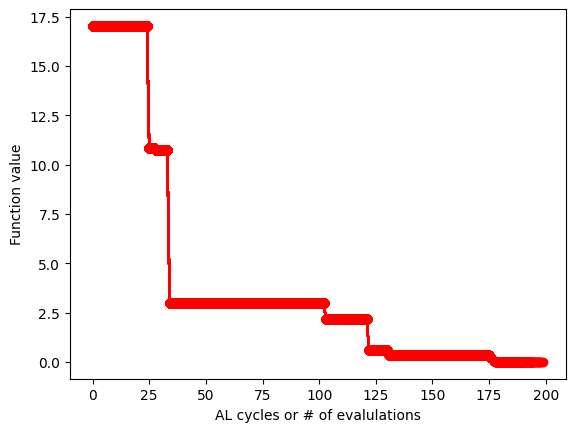

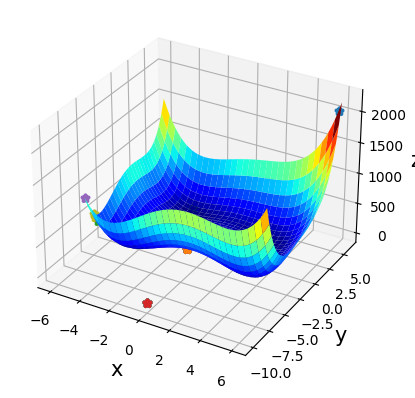

In [16]:
# ----------------------------------#
# Artificial in a nut shell course. #
# ----------------------------------#
# All credits to Maicon Pierre Lourenco (MPL)
# maiconpl01@gmail.com
# multimodal test function
# Last modification: 17/09/23

'''
from numpy import arange
from numpy import meshgrid
import numpy as np
from matplotlib import pyplot
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
'''

import random
from numpy import arange
from numpy import meshgrid
import numpy as np
%matplotlib inline
from matplotlib import pyplot
import matplotlib.pyplot as plt
#from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits import mplot3d

# objective function
def objective(x, y):
    return (x**2 + y - 11)**2 + (x + y**2 -7)**2

def next_predicted_coordinates_tradeoff(model, X_unexplored, C):

    y_unexplored = []
    std_unexplored = []
    tmp_y_unexplored = 0.0
    tmp_std_unexplored = 0.0

    for i in range(len(X_unexplored)):
        tmp_y_unexplored, tmp_std_unexplored = model.predict([X_unexplored[i]], return_std=True)
        y_unexplored.append( tmp_y_unexplored[0]  )
        std_unexplored.append( tmp_std_unexplored[0]  )

    print("y_unexplored: ", y_unexplored)
    print("std_unexplored: ", std_unexplored)

    optimum_index = np.argmin( np.array(y_unexplored) - C*np.array(std_unexplored) ) # LCB = m - C*std
    return( X_unexplored[optimum_index], y_unexplored[optimum_index] )

# define range for input
r_min, r_max = -6.0, 6.0
dx = 0.2
dy = 0.2

# sample input range uniformly at 0.1 increments
xaxis = arange(r_min, r_max + dx, dx)
yaxis = arange(r_min, r_max + dy, dy)

n_states =  len(xaxis) * len(yaxis)
print("number of all states or search space: ", n_states)

# create a mesh from the axis
x, y = meshgrid(xaxis, yaxis)
# compute targets
results = objective(x, y)

# GP from scikit-learn

from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import DotProduct, WhiteKernel, RBF
from sklearn.model_selection import train_test_split

kernel02 = 30*DotProduct(1.0, (1e-3, 1e3)) + 100 * WhiteKernel(10.0, (1e-3, 1e3)) + 1 * RBF(length_scale=1.0)

gp = GaussianProcessRegressor(kernel=kernel02, alpha=1e-8, n_restarts_optimizer=10, random_state=80)

data_list = []
z_list = []

for i in range(len(xaxis)):
   for j in range(len(yaxis)):
       print( "xaxis[i], yaxis[j]: ", i, j, round(xaxis[i], 2), round(yaxis[j], 2), objective(round(xaxis[i], 2), round(yaxis[j], 2)) )
       data_list.append( [round(xaxis[i], 2), round(yaxis[j], 2)] )
       z_list.append( objective(round(xaxis[i], 2), round(yaxis[j], 2)) )

print("data_list", data_list, len(data_list), n_states)
print("z_list", z_list, len(z_list), n_states, min(z_list))

print("data_list before:", data_list, np.array(data_list).shape)
print("len(z_list):", len(z_list))
print("min z_list and its coordinates:", data_list[np.argmin(z_list)][0], data_list[np.argmin(z_list)][1], min(z_list) )

# BEGIN AL #

n_cycles = 200
#n_cycles = 2

# Define the sample:
n_initial_random_data = 5
data_list_random_index = random.sample(range(0, len(data_list) - 1), n_initial_random_data)

print("data_list_random_index:", data_list_random_index)

data_list_init = []
z_list_init = []

for i in range(n_initial_random_data):
     data_list_init.append( data_list[data_list_random_index[i]] )
     z_list_init.append( z_list[data_list_random_index[i]] )

X_unexplored = []
for i in range(len(data_list)):
#    if i not in data_list_init:
    if data_list[i] not in data_list_init:

       X_unexplored.append( data_list[i] )

n_cycles_list = []
min_al_function_so_far_list = []
for i in range(n_cycles):
    X_train, X_test, y_train, y_test = train_test_split(data_list_init, z_list_init, test_size=0.05, random_state=42)

    gp.fit(X_train, y_train)

    print("AL cycle: " + str(i))
    print("R2 of predicted 'all data' from data_list: {:.4f}".format( gp.score(data_list, z_list)) )
    print("R2 of predicted 'train' from X_train: {:.4f}".format( gp.score(X_train, y_train)) )
    print("R2 of predicted 'test' from Y_test: {:.4f}".format( gp.score(X_test, y_test)) )

    # LCB acquisition function
    X_next, y_next = next_predicted_coordinates_tradeoff(model=gp, X_unexplored=X_unexplored, C=5.0)

    y_next_observed = objective(X_next[0] , X_next[1])
    print("next AL X_next, y_next:", X_next, y_next, y_next_observed)
    print("AL cycle " + str(i) + " min(z_list_init) so far:",  data_list_init[ np.argmin(z_list_init) ], min(z_list_init))

    # Add new observed data
    print("AL cycle " + str(i) + " len(data_list_init):", len(data_list_init), len(z_list_init))
    n_cycles_list.append(i)
    min_al_function_so_far_list.append( min(z_list_init) )

    # plot AL evolution graph
    plt.plot(n_cycles_list, min_al_function_so_far_list, 'ro-')
    plt.xlabel('AL cycles or # of evalulations')
    plt.ylabel('Function value')
    plt.savefig('al_evolution.png')

    data_list_init.append(  X_next  )
    z_list_init.append( y_next_observed  )

#for i in range(len(X_test)):
#    print("X_test obs and pred:", X_test[i], np.array(X_test[i]).reshape(-1,1), y_test[i], gp.predict([X_test[i]]) )

# create a surface plot with the jet color scheme
figure = pyplot.figure()

'''
axis = figure.gca(projection='3d')
axis.plot_surface(x, y, results, cmap='jet')
'''

axis = plt.axes(projection='3d')
axis.plot_surface(x, y, results, cmap='jet')

axis.set_xlabel('x', fontsize=15)
axis.set_ylabel('y', fontsize=15)
axis.set_zlabel('z', fontsize=15)

virtual = [0.0, -6.0]
virtual02 = [0.0, -10.0]

print("virtual02: ", virtual02)
print("np.array(virtual02).reshape(1,-1)", np.array(virtual02).reshape(1,-1))
print("np.array(virtual02).reshape(-1,1)", np.array(virtual02).reshape(-1,1))

for i in range(len(X_test)):
    axis.scatter( X_test[i][0], X_test[i][1], gp.predict( [X_test[i]]  ) , marker="*", linewidths=3.0, alpha=1.0)

    axis.scatter( 0.0, -4.0, gp.predict( [[0.0, -4.0]] ) , marker="*", linewidths=3.0, alpha=1.0)
    axis.scatter( virtual[0], virtual[1], gp.predict( [virtual] ) , marker="*", linewidths=3.0, alpha=1.0)
    axis.scatter( virtual02[0], virtual02[1], gp.predict( [np.array(virtual02).reshape(1,-1)[0]] ) , marker="*", linewidths=3.0, alpha=1.0) # IT DOES WORK

# show the plot
#pyplot.show()